In [1]:
# Install a pip package in the current Jupyter kernel
import sys
#!{sys.executable} -m pip install mne-connectivity

In [2]:
import os
from glob import glob
import numpy as np
import scipy as sp
import random as rd
import pandas as pd
pd.options.display.float_format = '{:,.2f}'.format

from sklearn import metrics
from sklearn import decomposition, cluster
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression

from scipy.spatial.distance import correlation
from IPython.display import display

In [3]:
import mne
#import mne_connectivity

from mne.preprocessing import (ICA, create_eog_epochs, create_ecg_epochs, corrmap, annotate_muscle_zscore, 
                               find_eog_events, find_ecg_events, ica_find_ecg_events, find_bad_channels_maxwell)
from mne.time_frequency import tfr_morlet, psd_multitaper, psd_welch, csd_fourier, csd_multitaper, csd_morlet

from mne_connectivity import seed_target_indices, spectral_connectivity_epochs

print(mne.__file__)
print(mne.__version__)

C:\Users\Lenovo\anaconda3\lib\site-packages\mne\__init__.py
0.23.4


In [4]:
import plotly.graph_objects as go
from gtda.time_series import SingleTakensEmbedding, TakensEmbedding, takens_embedding_optimal_parameters
from gtda.homology import VietorisRipsPersistence
from gtda.diagrams import BettiCurve, Scaler, Filtering, Amplitude, PersistenceEntropy, NumberOfPoints
from gtda.plotting import plot_point_cloud


In [5]:
# Configure the graphics engine

import matplotlib.pyplot as plt
plt.rc('figure', max_open_warning=100)
%matplotlib notebook
#%matplotlib inline
#%matplotlib qt

In [6]:
import seaborn as sns
# Apply the default theme
sns.set_theme()

# Loading data

Extracting EDF parameters from C:\Users\Lenovo\PycharmProjects\Tibet\work_data\m10.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 491999  =      0.000 ...   983.998 secs...
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2', 'ecg']
<Info | 7 non-empty values
 bads: []
 ch_names: Fp1, Fp2, F7, F3, Fz, F4, F8, T3, C3, Cz, C4, T4, T5, P3, Pz, ...
 chs: 20 EEG
 custom_ref_applied: False
 highpass: 0.5 Hz
 lowpass: 70.0 Hz
 meas_date: 2020-03-01 06:31:33 UTC
 nchan: 20
 projs: []
 sfreq: 500.0 Hz
>


<IPython.core.display.Javascript object>


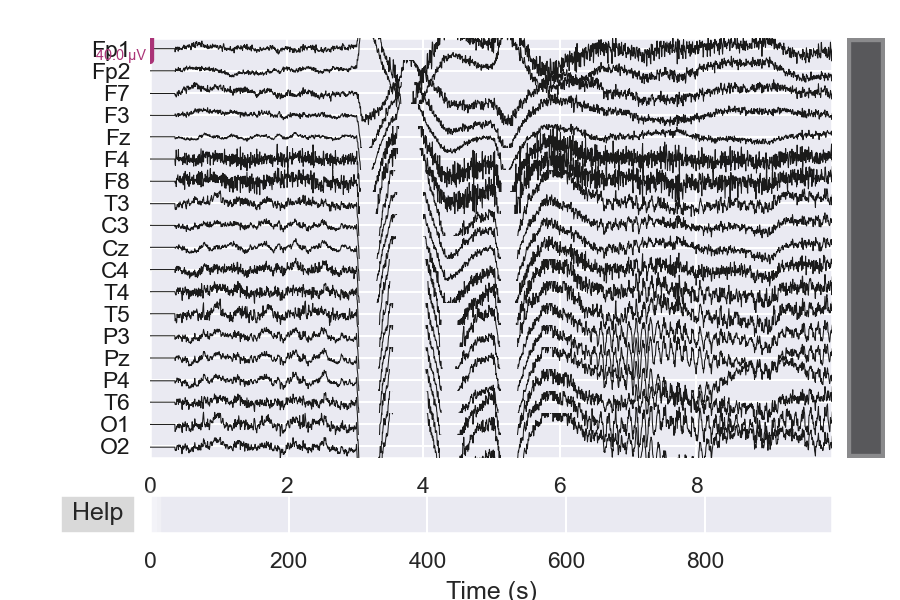

<RawEDF | m10.edf, 19 x 468751 (937.5 s), ~68.0 MB, data loaded>

In [8]:
#Fp_chan=['Fpz', 'Fp1', 'Fp2','Fz']
#C_chan=['Cz', 'C3','C4','C1', 'C2']
#P_chan=['Pz', 'P3', 'P4', 'P8', 'P7', 'P6', 'P5', 'P1', 'P2']
#PO_chan=['POz', 'PO3', 'PO7','PO4', 'PO8'] 
#O_chan= ['Oz', 'O1', 'O2']
#Cz_chan=['CPz','FCz']

ECG_ch =['ecg']

data_raw = mne.io.read_raw_edf(os.path.join('work_data', r"m10.edf"), preload=True)
#annot = mne.read_annotations(os.path.join('work_data', r'm10-annot.csv'))
#data.set_annotations(annot)
sampling_rate = data_raw.info['sfreq']

print(data_raw.info.ch_names)
print(data_raw.info)

#data_eog = data.copy().pick_channels(EOG_ch)
#data_ecg = data_raw.copy().pick_channels(ECG_ch)

data_raw.drop_channels('ecg').set_montage('standard_1020')
#data.set_channel_types(change_types)

#data.plot(scalings = dict(eeg=100e-6, eog=150e-6), duration=10)
data_raw.plot(duration=10)
print()

data_raw.crop(tmin=7.5, tmax=945) #removing blink artifacts


<IPython.core.display.Javascript object>


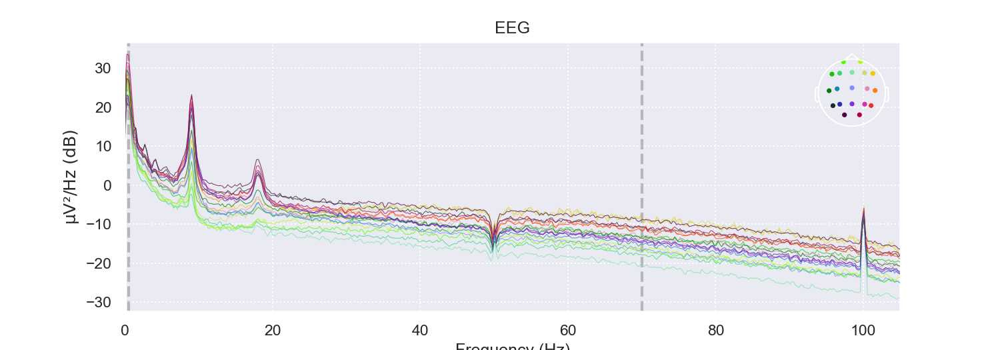

Effective window size : 4.096 (s)



In [9]:
data_raw.plot_psd(fmin=0, fmax=105)
print()

<IPython.core.display.Javascript object>


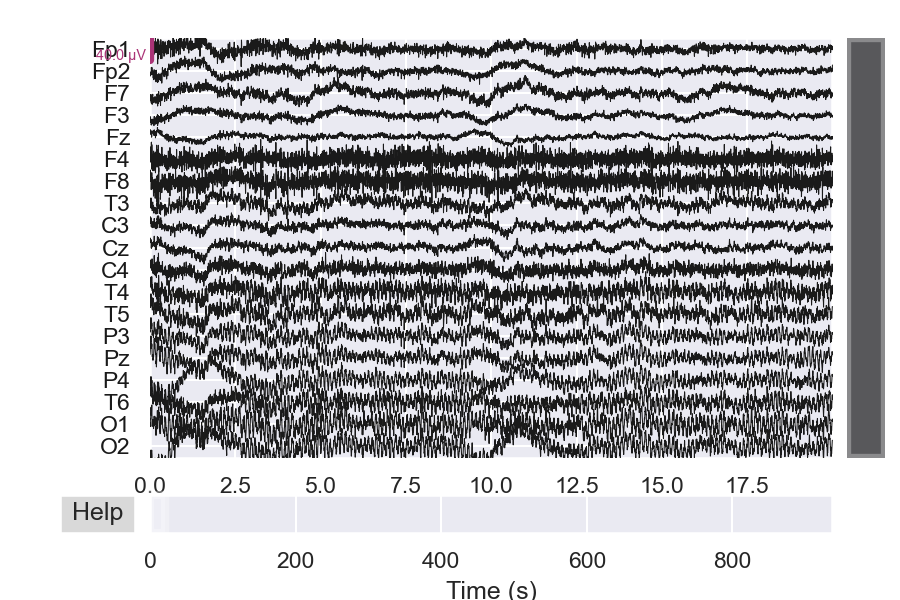

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom EEG reference.


<IPython.core.display.Javascript object>


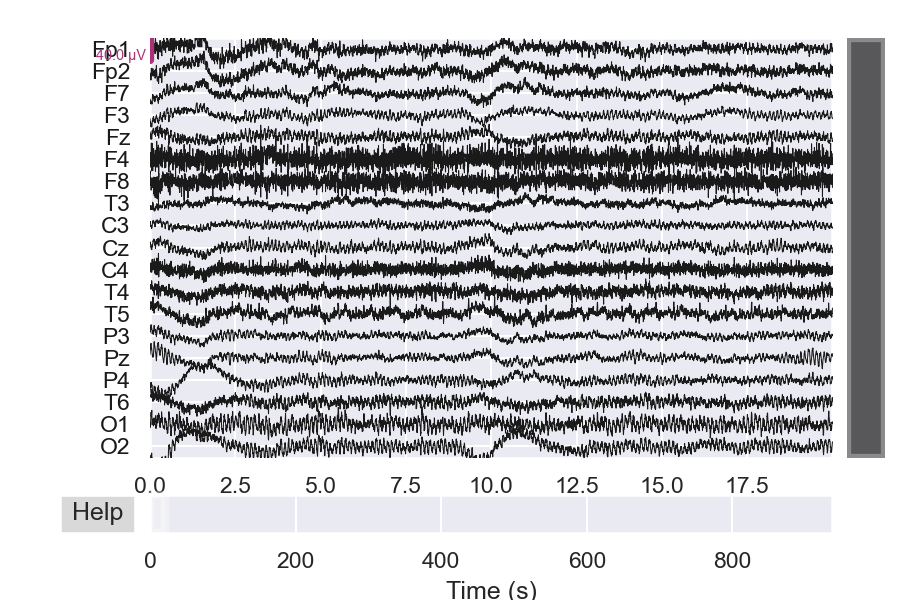

In [10]:
# Re-referencing raw data (common average reference)

fig_orig = data_raw.plot(duration=20)
rr_data_raw, ref_ch = mne.set_eeg_reference(data_raw, ref_channels='average', copy=True, projection=False, ch_type='auto')
fig_reref = rr_data_raw.plot(duration=20)
print()

# Correlation matrix for raw filtered data
#matr_corr_ts_raw = np.corrcoef(data_raw.copy().crop(tmax=20).get_data())
#df_matr_corr_ts_raw = pd.DataFrame(matr_corr_ts_raw, index = data_raw.ch_names, columns = data_raw.ch_names)
#display_corr_matrix(df_matr_corr_ts_raw)
#matr_corr_ts_rr_raw = np.corrcoef(rr_data_raw.copy().crop(tmax=20).get_data())
#df_matr_corr_ts_rr_raw = pd.DataFrame(matr_corr_ts_rr_raw, index = data_raw.ch_names, columns = data_raw.ch_names)
#display_corr_matrix(df_matr_corr_ts_rr_raw)


<IPython.core.display.Javascript object>


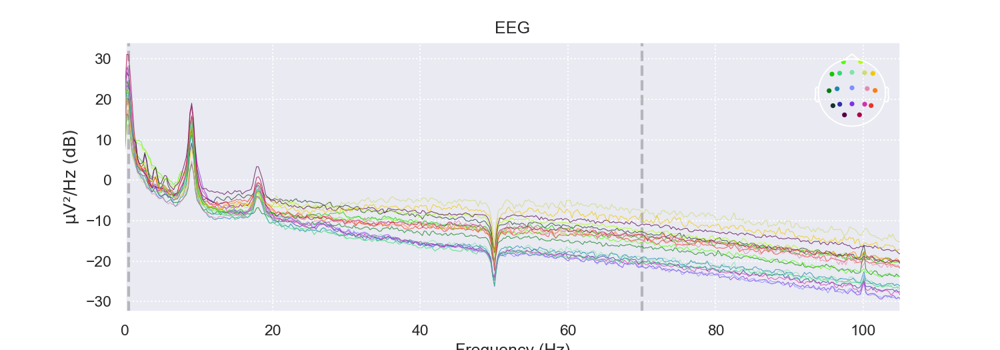

Effective window size : 4.096 (s)



In [11]:
rr_data_raw.plot_psd(fmin=0, fmax=105)
print()

# Preprocessing data

## ICA preparation 

Interpolating bad channels
    Automatic origin fit: head of radius 91.5 mm
Computing interpolation matrix from 17 sensor positions
Interpolating 2 sensors
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Filter length: 825 samples (1.650 sec)

Fitting ICA to data using 19 channels (please be patient, this may take a while)
Selecting by explained variance: 13 components
Fitting ICA took 5.9s.
Creating RawArray with float64 data, n_channels=13, n_times=468751
    Range : 3750 ... 472500 =      7.500 ...   945.000 secs
Ready.


<IPython.core.display.Javascript object>


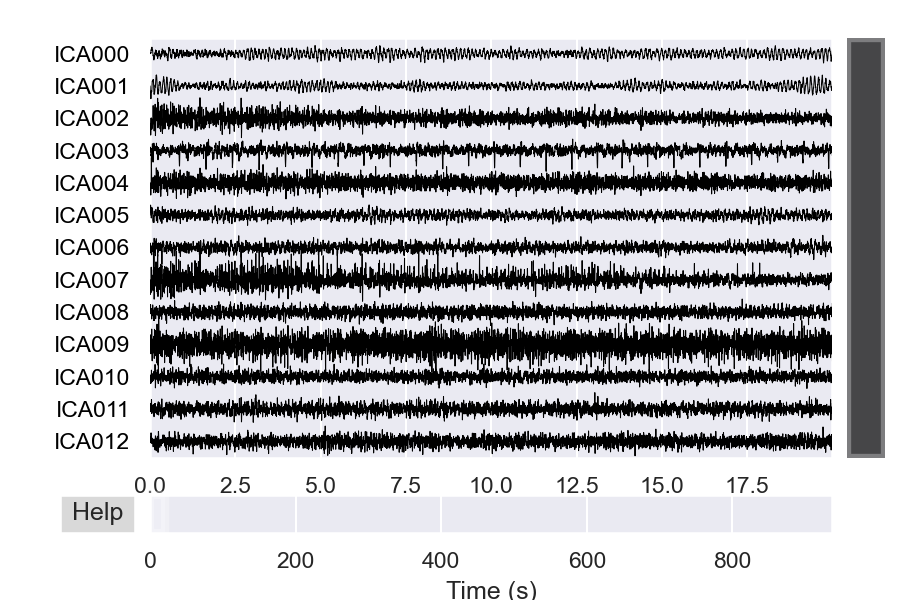

<IPython.core.display.Javascript object>


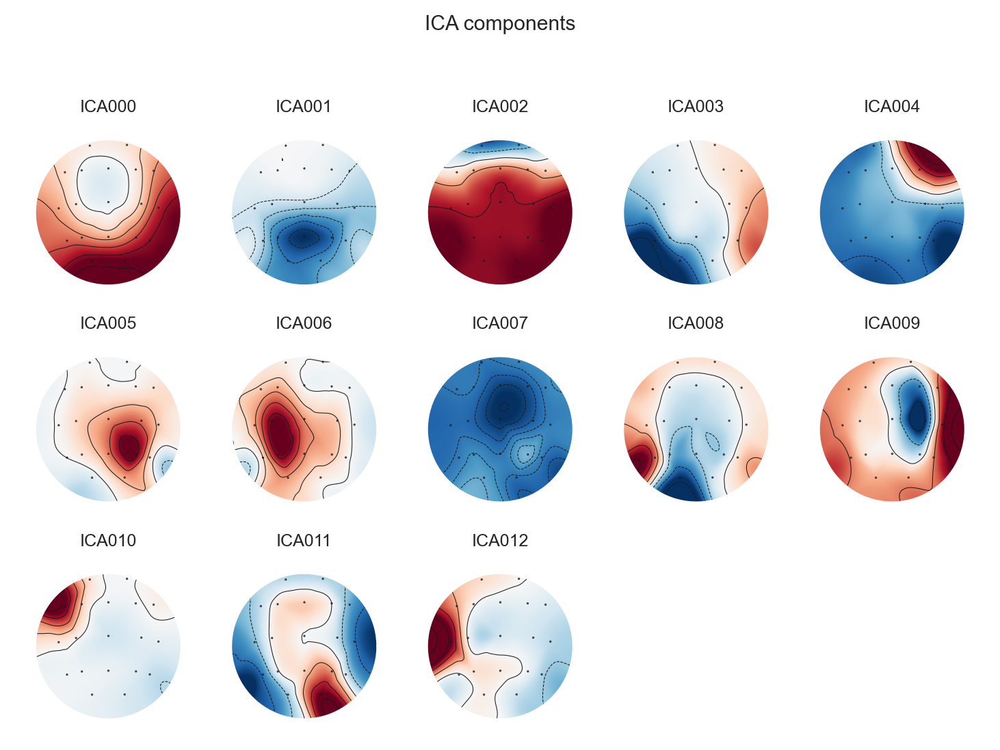

[<MNEFigure size 975x731.5 with 13 Axes>]

In [12]:
data_ica = data_raw.copy()
#data_ica.info['bads']=["F4","F8"]
#data_ica.interpolate_bads(reset_bads=True)

data_ica.filter(l_freq=4., h_freq=None)

ica = ICA(n_components=.99, max_iter='auto', random_state=97)
ica.fit(data_ica)

ica.plot_sources(data_ica)
ica.plot_components()

Interpolating bad channels
    Automatic origin fit: head of radius 91.5 mm
Computing interpolation matrix from 17 sensor positions
Interpolating 2 sensors
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Filter length: 825 samples (1.650 sec)

Fitting ICA to data using 19 channels (please be patient, this may take a while)
Selecting by explained variance: 14 components
Fitting ICA took 6.8s.
Creating RawArray with float64 data, n_channels=14, n_times=468751
    Range : 3750 ... 472500 =      7.500 ...   945.000 secs
Ready.


<IPython.core.display.Javascript object>


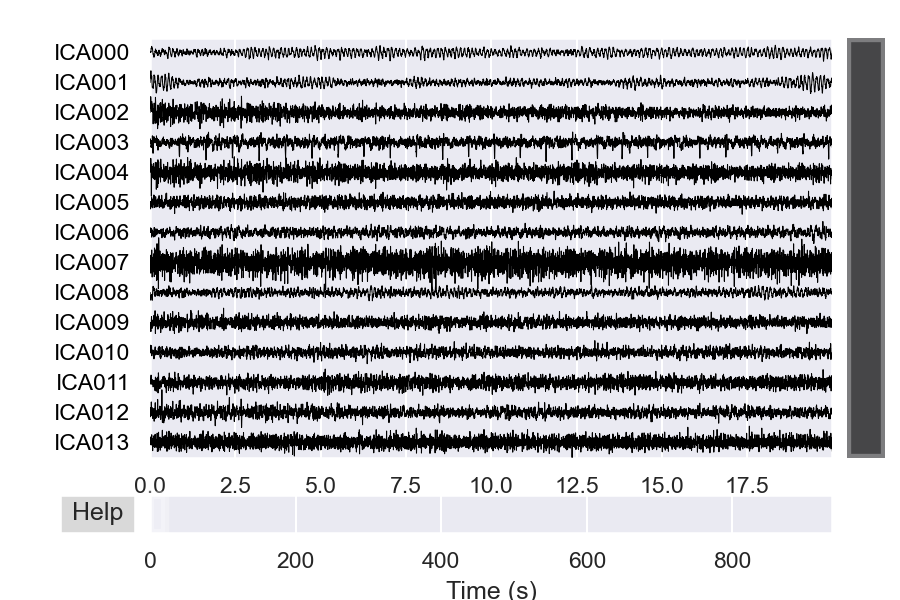

<IPython.core.display.Javascript object>


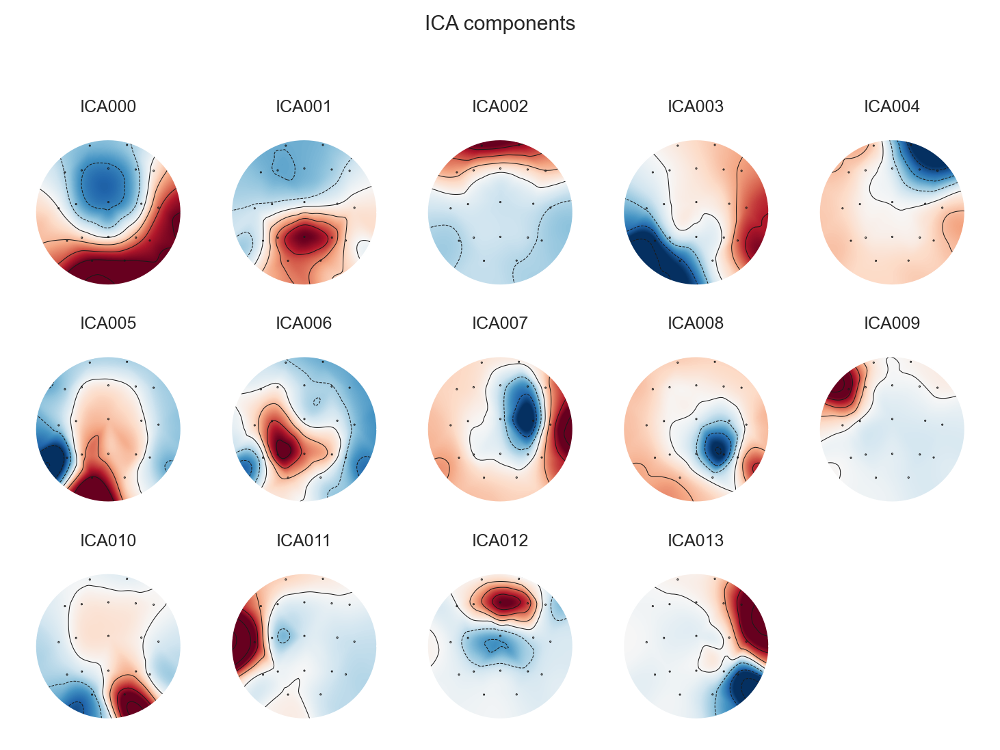

[<MNEFigure size 975x731.5 with 14 Axes>]

In [13]:
rr_data_ica = rr_data_raw.copy()
rr_data_ica.info['bads']=["F4","F8"]
rr_data_ica.interpolate_bads(reset_bads=True)

rr_data_ica.filter(l_freq=4., h_freq=None)

rr_ica = ICA(n_components=.99, max_iter='auto', random_state=97)
rr_ica.fit(rr_data_ica)

rr_ica.plot_sources(rr_data_ica)
rr_ica.plot_components()

Using ICA source to identify heart beats
Setting up band-pass filter from 5 - 35 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 5.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 4.75 Hz)
- Upper passband edge: 35.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 35.25 Hz)
- Filter length: 5000 samples (10.000 sec)

[111. 111. 111. ... 111. 111. 111.]
[  3794.   4181.   4959. ... 471229. 471594. 471976.]
Not setting metadata
Not setting metadata
1232 matching events found
Setting baseline interval to [-0.3, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 1232 events and 351 original time points ...
1 bad epochs dropped
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


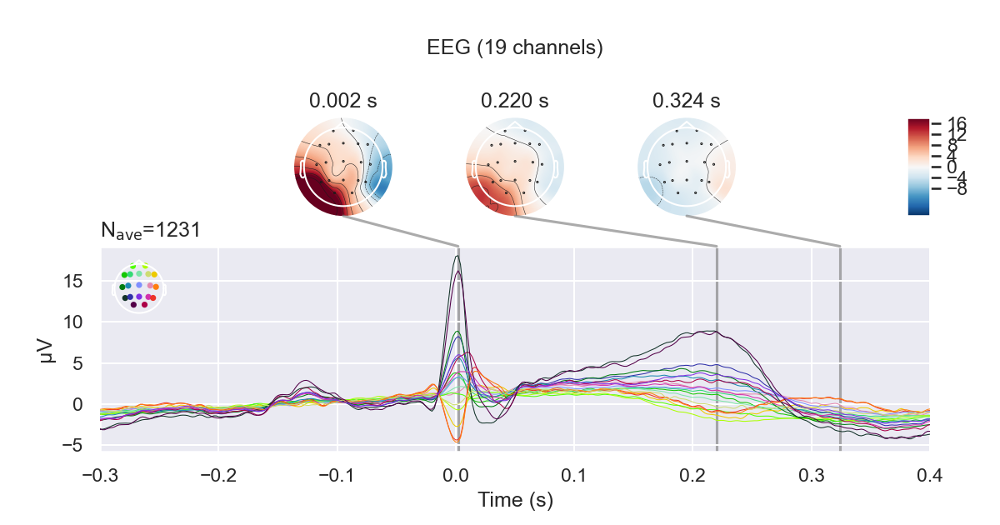

In [14]:
# Extract the time courses of these components and add them as channels to the raw data. 
# Think of them the same way as EOG/EKG channels
ecg_comps = ica.get_sources(data_ica).get_data()
#ecg_comps.pick(picks='ICA003')
#(ecg_comps.info)

ecg_events = ica_find_ecg_events(data_ica, 
                             ecg_comps[3], 
                             event_id=111, 
                             l_freq=5, h_freq=35, 
                             )
print(ecg_events[:,2])
print(np.unique(ecg_events[:,0]))


evoked_ECG = mne.Epochs(data_raw, ecg_events.astype(int),
                            #detrend=1,
                            decim=1,
                            #baseline=(-0.15,0.0),
                            tmin=-0.3, tmax=0.4, 
                            preload=True).average()
evoked_ECG.plot_joint()
print()

#data_ica.add_channels([ecg_comps])

#ecg_comps.rename_channels({'ICA003': 'ecg_ICA003'})
#ecg_comps.set_channel_types({'ICA003': 'ecg'})


Using ICA source to identify heart beats
Setting up band-pass filter from 5 - 35 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 5.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 4.75 Hz)
- Upper passband edge: 35.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 35.25 Hz)
- Filter length: 5000 samples (10.000 sec)

[111. 111. 111. ... 111. 111. 111.]
[  3794.   4181.   4959. ... 471229. 471594. 471976.]
Not setting metadata
Not setting metadata
1257 matching events found
Setting baseline interval to [-0.3, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 1257 events and 351 original time points ...
1 bad epochs dropped
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


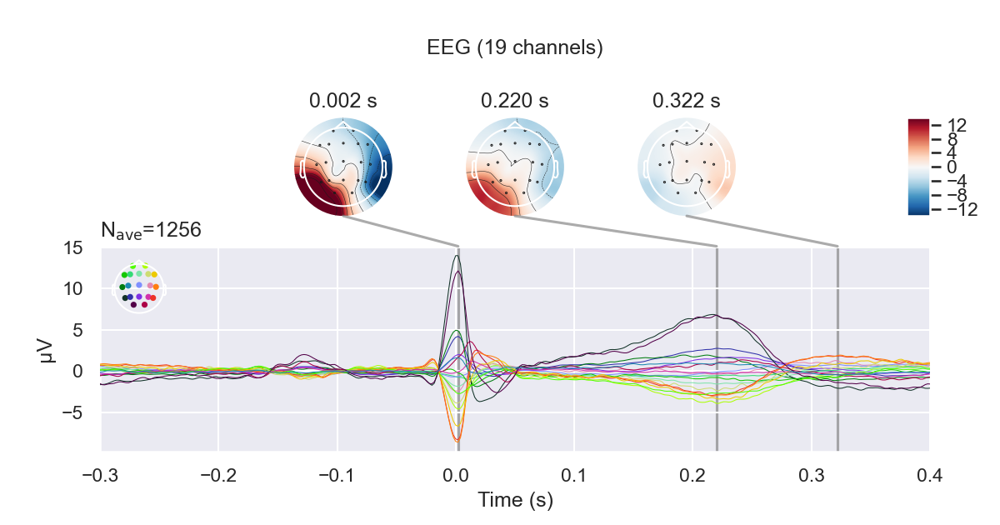

In [15]:
# Extract the time courses of these components and add them as channels to the raw data. 
# Think of them the same way as EOG/EKG channels
rr_ecg_comps = rr_ica.get_sources(rr_data_ica).get_data()
#ecg_comps.pick(picks='ICA003')
#(ecg_comps.info)

rr_ecg_events = ica_find_ecg_events(rr_data_ica, 
                             rr_ecg_comps[3], 
                             event_id=111, 
                             l_freq=5, h_freq=35, 
                             )
print(rr_ecg_events[:,2])
print(np.unique(rr_ecg_events[:,0]))


rr_evoked_ECG = mne.Epochs(rr_data_raw, rr_ecg_events.astype(int),
                            #detrend=1,
                            decim=1,
                            #baseline=(-0.15,0.0),
                            tmin=-0.3, tmax=0.4, 
                            preload=True).average()
rr_evoked_ECG.plot_joint()
print()

#data_ica.add_channels([ecg_comps])

#ecg_comps.rename_channels({'ICA003': 'ecg_ICA003'})
#ecg_comps.set_channel_types({'ICA003': 'ecg'})


Applying ICA to Evoked instance
    Transforming to ICA space (13 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<ipython-input-16-737230a8df71>:1: RuntimeWarning: The data you passed to ICA.apply() was baseline-corrected. Please note that ICA can introduce DC shifts, therefore you may wish to consider baseline-correcting the cleaned data again.
  ica.plot_overlay(evoked_ECG, exclude=[3])


<IPython.core.display.Javascript object>


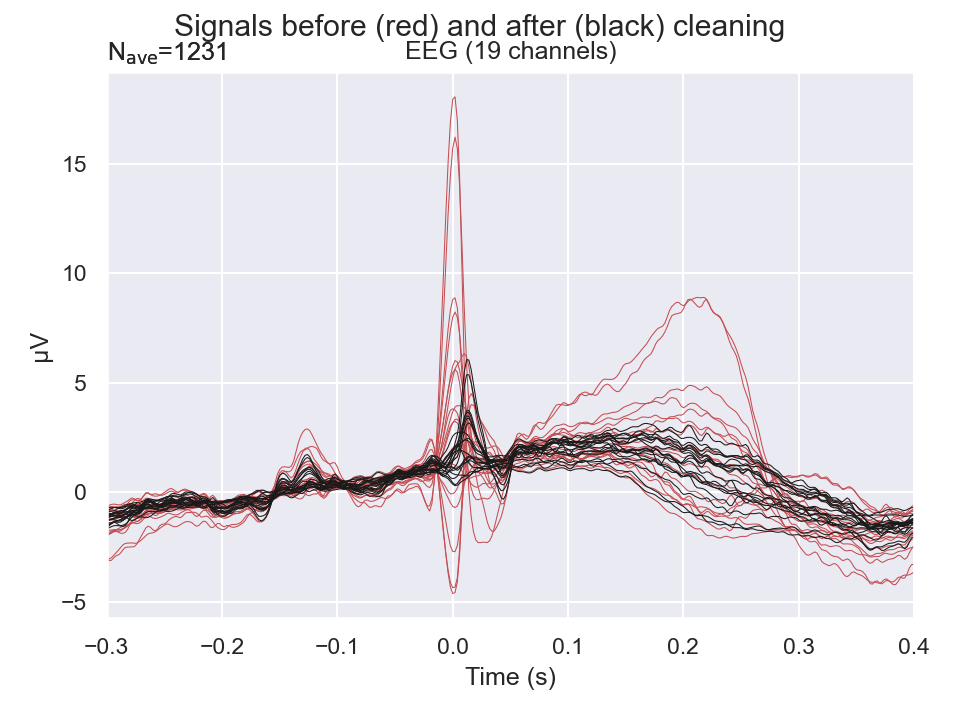

<IPython.core.display.Javascript object>


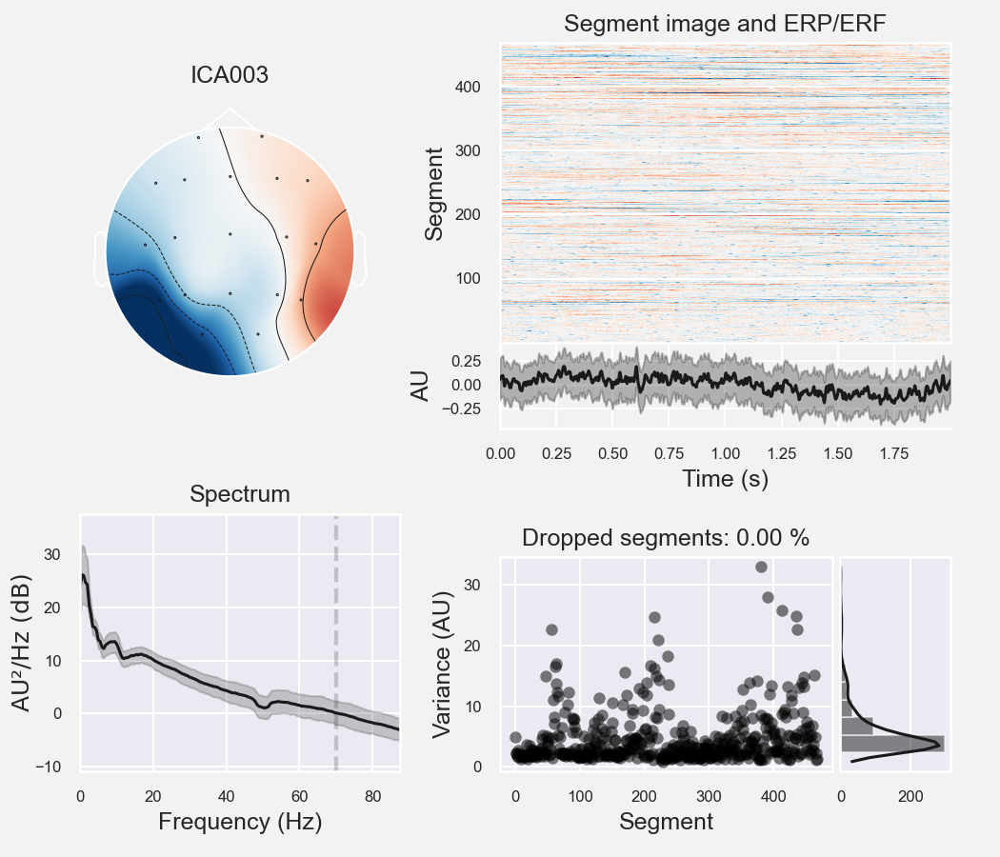

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
468 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


[<Figure size 700x600 with 6 Axes>]

In [16]:
ica.plot_overlay(evoked_ECG, exclude=[3])
ica.plot_properties(data_raw, picks=[3])

Applying ICA to Evoked instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<ipython-input-17-944f4f25e7ca>:1: RuntimeWarning: The data you passed to ICA.apply() was baseline-corrected. Please note that ICA can introduce DC shifts, therefore you may wish to consider baseline-correcting the cleaned data again.
  rr_ica.plot_overlay(rr_evoked_ECG, exclude=[3])


<IPython.core.display.Javascript object>


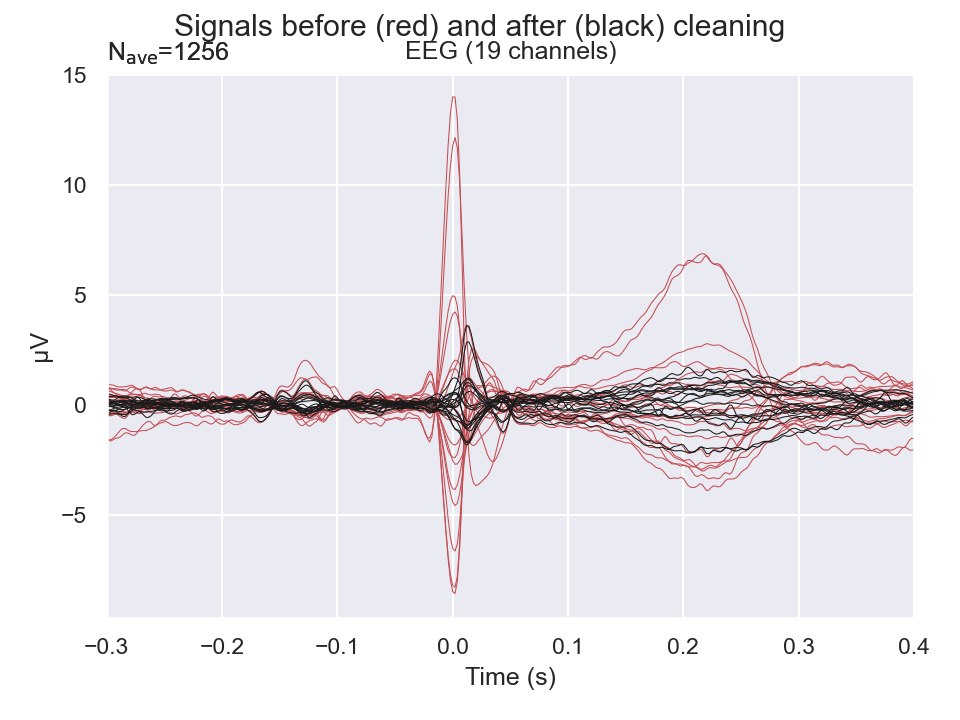

<IPython.core.display.Javascript object>


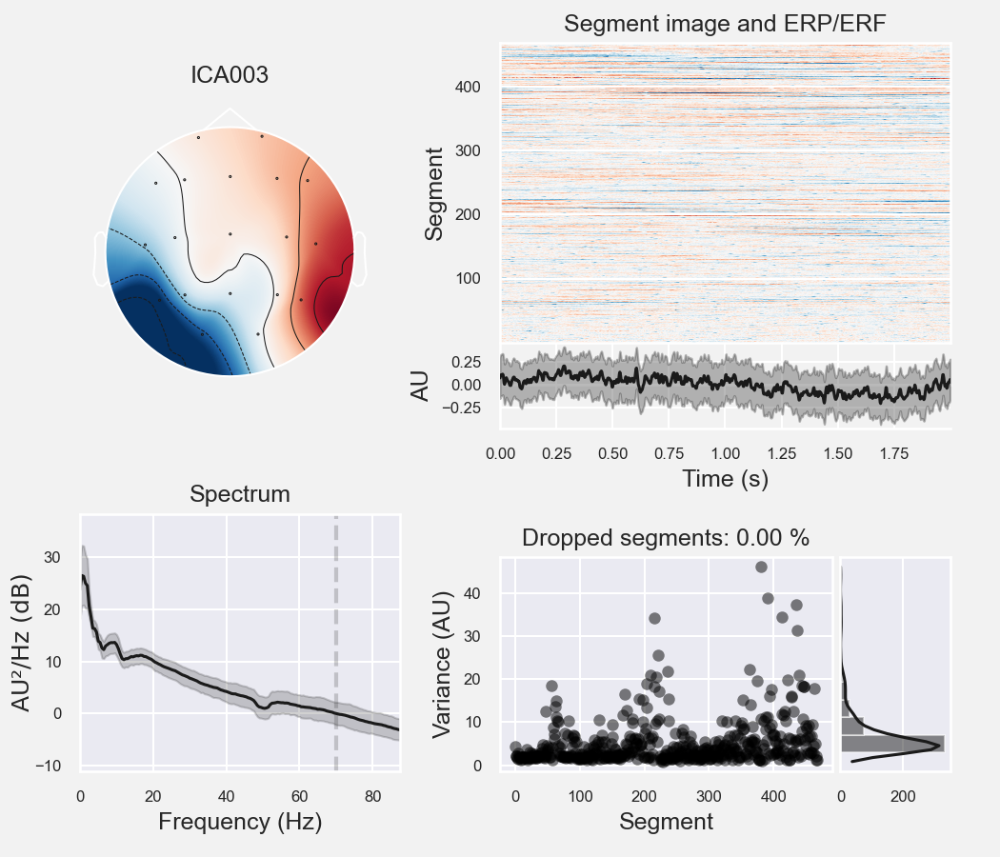

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
468 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


[<Figure size 700x600 with 6 Axes>]

In [17]:
rr_ica.plot_overlay(rr_evoked_ECG, exclude=[3])
rr_ica.plot_properties(rr_data_raw, picks=[3])

Applying ICA to Raw instance
    Transforming to ICA space (13 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<IPython.core.display.Javascript object>


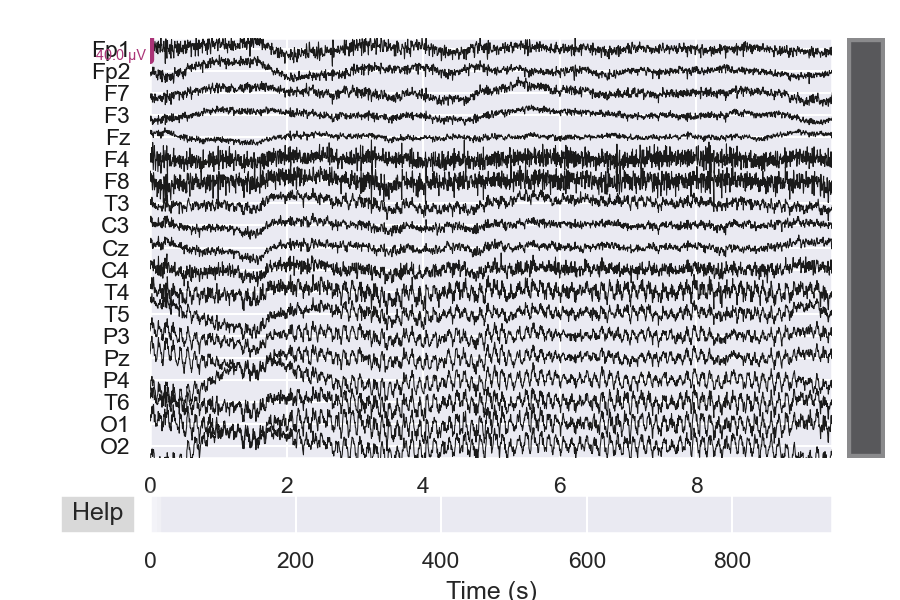

In [18]:
# Exclude ECG channel (original data)

ica.exclude = [3] 
data = data_raw.copy()
ica.apply(data)

#data_notch = data.copy().notch_filter([50,100])
#data_notch.plot_psd(fmin=0, fmax=105)

data.plot()
#data.plot_psd()
print()

Applying ICA to Raw instance
    Transforming to ICA space (14 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<IPython.core.display.Javascript object>


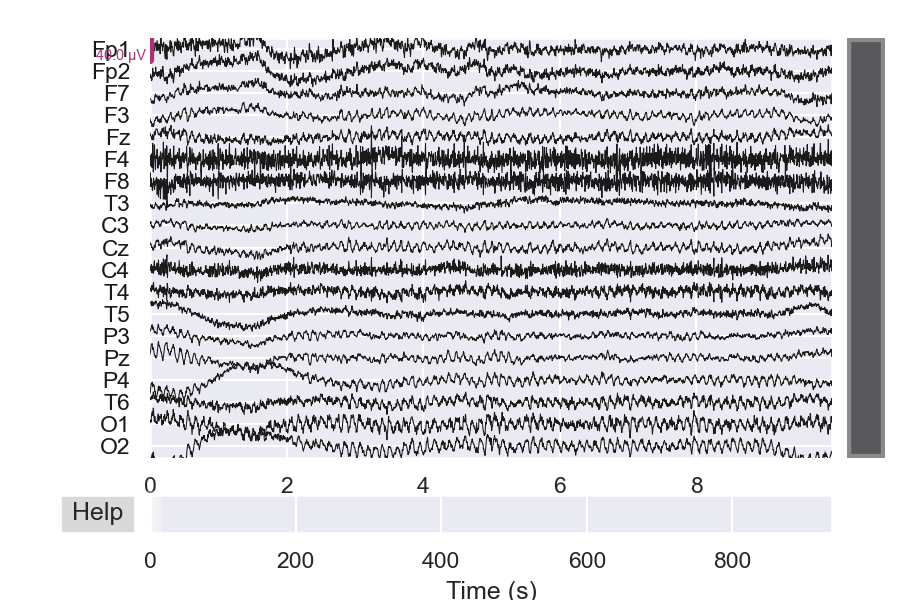

<IPython.core.display.Javascript object>


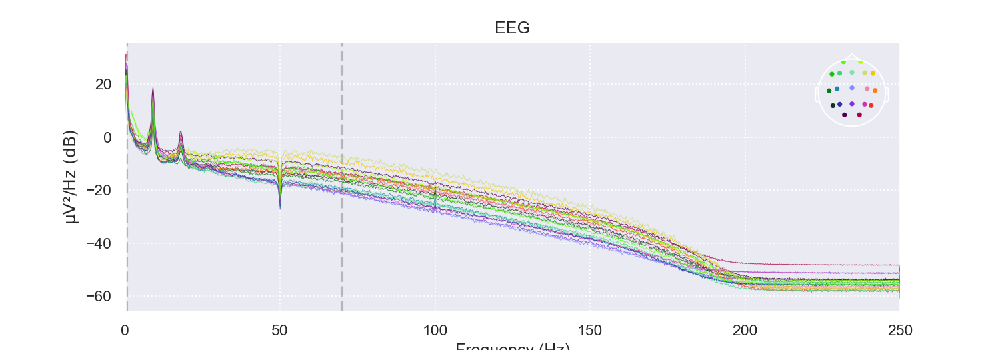

Effective window size : 4.096 (s)



In [19]:
# Exclude ECG channel (re-referenced data)
rr_ica.exclude = [3] 
reref_data = rr_data_raw.copy()
rr_ica.apply(reref_data)

reref_data.plot()
reref_data.plot_psd()

#rr_data_notch = reref_data.copy().notch_filter([50])
#rr_data_notch.plot_psd()#fmin=0, fmax=105)
print()

# Epoching data

In [20]:
# Filtering raw_data
bands = [(0.9, 4, 'Delta (0.9-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'), (8, 14, 'Alpha (8-14 Hz)'), 
         (14, 25, 'Beta (14-25 Hz)'), (25, 40, 'Gamma (25-40 Hz)')]

# Original data
data_filt = data.copy().filter(l_freq=bands[0][0], h_freq=bands[4][1])
data_filt_spectr = []
for i in range(len(bands)):
    data_filt_spectr.append(data.copy().filter(l_freq=bands[i][0], h_freq=bands[i][1]))

# Re-referenced data
data_rr_filt = reref_data.copy().filter(l_freq=bands[0][0], h_freq=bands[4][1])
data_rr_filt_spectr = []
for i in range(len(bands)):
    data_rr_filt_spectr.append(reref_data.copy().filter(l_freq=bands[i][0], h_freq=bands[i][1]))

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.9 - 40 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.90
- Lower transition bandwidth: 0.90 Hz (-6 dB cutoff frequency: 0.45 Hz)
- Upper passband edge: 40.00 Hz
- Upper transition bandwidth: 10.00 Hz (-6 dB cutoff frequency: 45.00 Hz)
- Filter length: 1835 samples (3.670 sec)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.9 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.90
- Lower transition bandwidth: 0.90 Hz (-6 dB cutoff frequency: 0.45 Hz)
- Upper passband e

Not setting metadata
Not setting metadata
1232 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1232 events and 451 original time points ...
1 bad epochs dropped
(1232, 3)
<Epochs |  1227 events (all good), -0.4 - 0.5 sec, baseline off, ~80.2 MB, data loaded,
 '111': 1227>
(1227, 19, 451)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


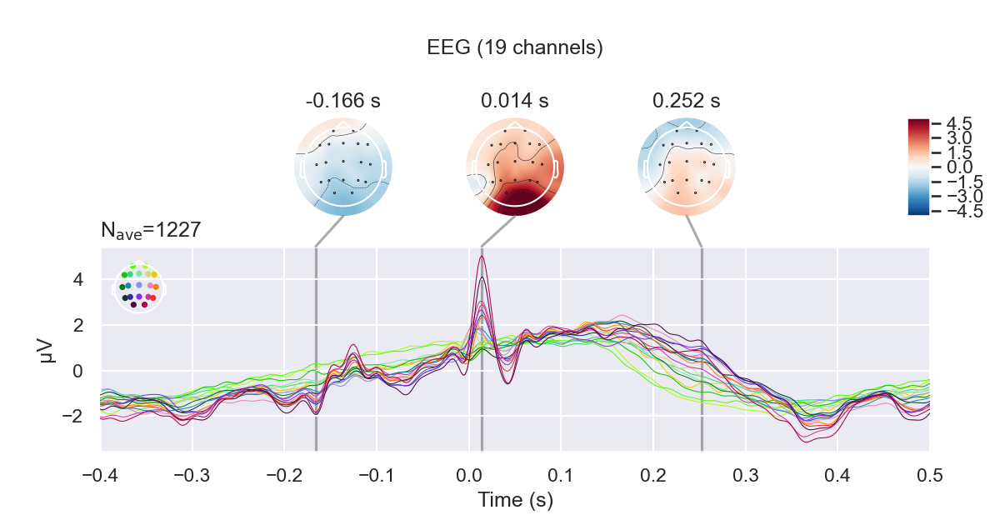

<IPython.core.display.Javascript object>


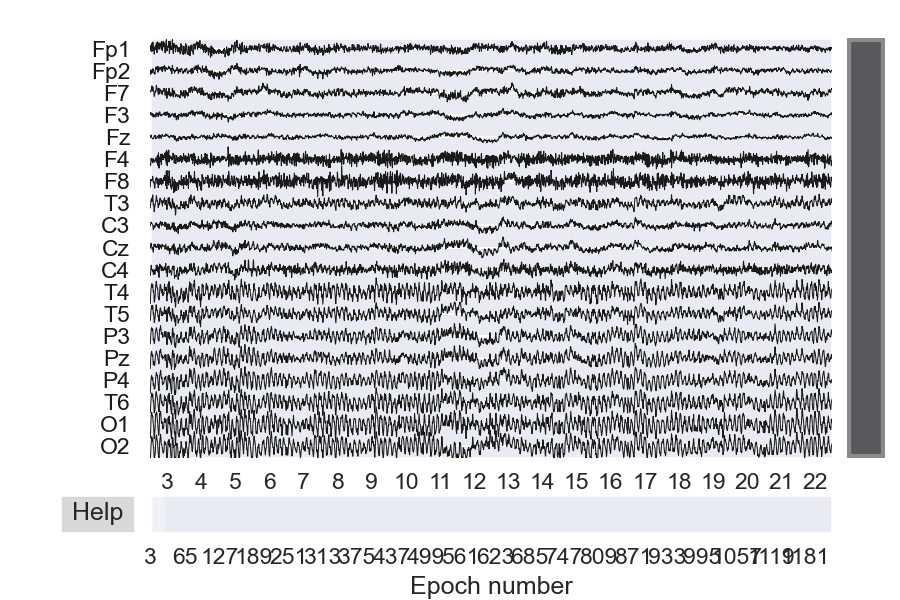

In [21]:
# Epoches, centered by ECG peaks
kwargs = dict(baseline=None, tmin=-0.4, tmax=0.5, preload=True)

epochs_ecg = mne.Epochs(data_filt, ecg_events.astype(int), **kwargs)
epochs_ecg = epochs_ecg[2:-2] # remove first and last 2 epoches due to possible filtering artefacts

print(ecg_events.shape)
print(epochs_ecg)
print(epochs_ecg.get_data().shape)
#print(epochs_ecg.events)

epochs_ecg.average().plot_joint()
epochs_ecg.plot()
print()

Not setting metadata
Not setting metadata
1257 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1257 events and 451 original time points ...
1 bad epochs dropped
(1257, 3)
<Epochs |  1252 events (all good), -0.4 - 0.5 sec, baseline off, ~81.9 MB, data loaded,
 '111': 1252>
(1252, 19, 451)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


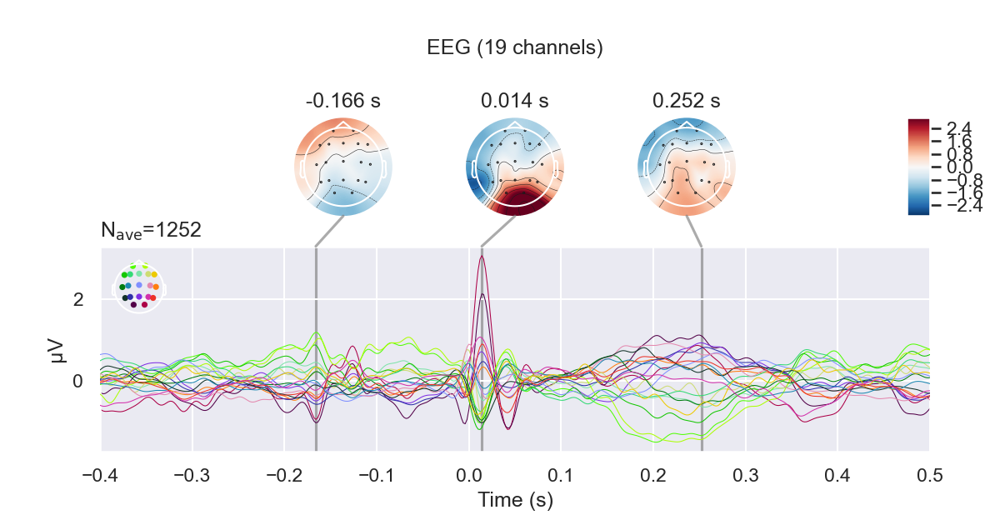

<IPython.core.display.Javascript object>


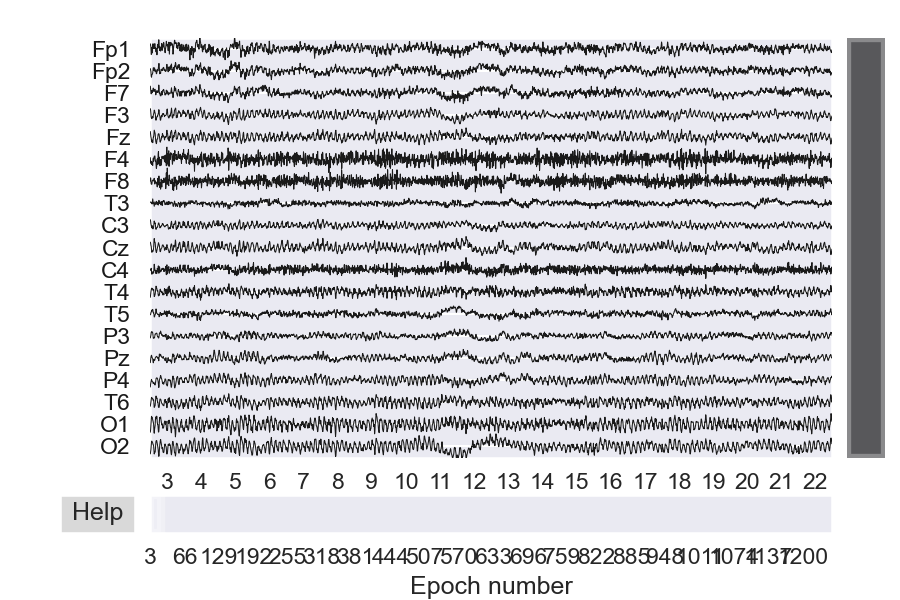

In [22]:
# Epoches, centered by ECG peaks (re-referenced)
kwargs = dict(baseline=None, tmin=-0.4, tmax=0.5, preload=True)

epochs_ecg_rr = mne.Epochs(data_rr_filt, rr_ecg_events.astype(int), **kwargs)
epochs_ecg_rr = epochs_ecg_rr[2:-2] # remove first and last 2 epoches due to possible filtering artefacts

print(rr_ecg_events.shape)
print(epochs_ecg_rr)
print(epochs_ecg_rr.get_data().shape)
#print(epochs_ecg_rr.events)

epochs_ecg_rr.average().plot_joint()
epochs_ecg_rr.plot()
print()

Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
(1171, 3)
<Epochs |  1167 events (all good), -0.5 - 0.5 sec, baseline off, ~84.8 MB, data loaded,
 '1': 1167>
(1167, 19, 501)
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not s

<IPython.core.display.Javascript object>


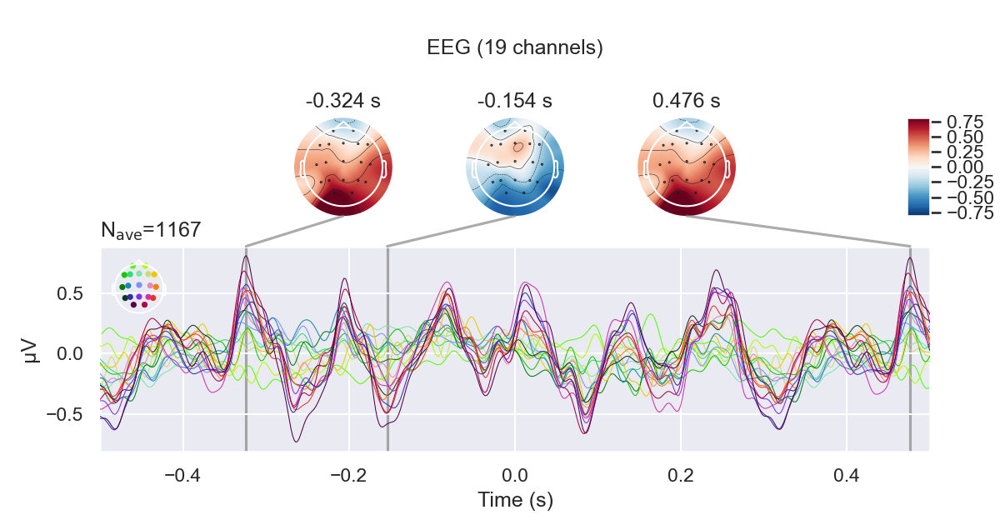

In [23]:
# Epochs by fixed length events, duration 1s, overlap 0.2s
fix_1s_events_ovl = mne.make_fixed_length_events(data_filt, start=0.5, duration=1., overlap=0.2)
kwargs = dict(baseline=None, tmin=-0.5, tmax=0.5, preload=True)

epochs_fix_1s_ovl = mne.Epochs(data_filt, fix_1s_events_ovl.astype(int), **kwargs)
epochs_fix_1s_ovl = epochs_fix_1s_ovl[2:-2] #remove first and last 2sec due to possible filtering artefacts

print(fix_1s_events_ovl.shape)
print(epochs_fix_1s_ovl)
print(epochs_fix_1s_ovl.get_data().shape)
#print(epochs_fix_1s_ovl.events)

epochs_fix_spectr = []
for i in range(len(bands)):   
    epochs_fix_spectr.append(mne.Epochs(data_filt_spectr[i], fix_1s_events_ovl.astype(int), **kwargs))
    epochs_fix_spectr[i] = epochs_fix_spectr[i][2:-2] 

epochs_fix_1s_ovl.average().plot_joint()
#for i in range(len(bands)):
#    print(bands[i][2])
#    epochs_fix_spectr[i].average().plot_joint()
#epochs_fix_1s_ovl.plot()
print()

Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
(1171, 3)
<Epochs |  1167 events (all good), -0.5 - 0.5 sec, baseline off, ~84.8 MB, data loaded,
 '1': 1167>
(1167, 19, 501)
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not s

<IPython.core.display.Javascript object>


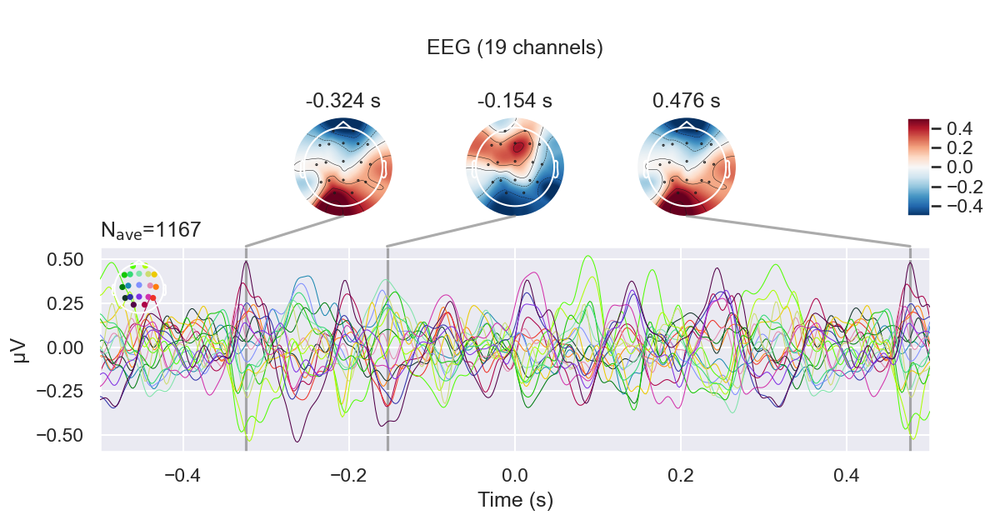

In [24]:
# Epochs by fixed length events, duration 1s, overlap 0.2s
fix_1s_events_rr = mne.make_fixed_length_events(data_rr_filt, start=0.5, duration=1., overlap=0.2)
kwargs = dict(baseline=None, tmin=-0.5, tmax=0.5, preload=True)

epochs_fix_1s_rr = mne.Epochs(data_rr_filt, fix_1s_events_rr.astype(int), **kwargs)
epochs_fix_1s_rr = epochs_fix_1s_rr[2:-2] #remove first and last 2sec due to possible filtering artefacts

print(fix_1s_events_rr.shape)
print(epochs_fix_1s_rr)
print(epochs_fix_1s_rr.get_data().shape)
#print(epochs_fix_1s_rr.events)

epochs_fix_rr_spectr = []
for i in range(len(bands)):   
    epochs_fix_rr_spectr.append(mne.Epochs(data_rr_filt_spectr[i], fix_1s_events_rr.astype(int), **kwargs))
    epochs_fix_rr_spectr[i] = epochs_fix_rr_spectr[i][2:-2] 

epochs_fix_1s_rr.average().plot_joint()
#for i in range(len(bands)):
#    print(bands[i][2])
#    epochs_fix_rr_spectr[i].average().plot_joint()
#epochs_fix_1s_rr.plot()
print()

# Extract features

In [25]:
# Global variables
regions = [(['Fp1','Fp2','Fz'], 'Fr', 'frontal'), (['F7','F3','T3','T5'], 'LT', 'left temporal'), 
           (['F4','F8','T4','T6'], 'RT', 'right temporal'), (['C3','Cz','C4'], 'Cen', 'central'), 
           (['P3','Pz','P4'], 'Par', 'parietal'), (['O1','O2'], 'Occ', 'occipital')]
str_freq = ['D', 'T', 'A', 'B', 'G']
str_freq_rr = ['rD', 'rT', 'rA', 'rB', 'rG']
ch_names = reref_data.ch_names

n_freq = len(str_freq_rr)
n_channels = len(ch_names)
n_samples = epochs_fix_1s_rr.__len__()
n_regions = len(regions)

In [26]:
print(ch_names)

['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']


In [27]:
def plot_ft_distr_hist(df_features, row_length=None, bins=10):
    n_features = len(df_features.columns)
    if (row_length == None) or (row_length <= 0) or (row_length > n_features): 
        row_length = n_features
    n_rows = n_features // row_length + bool(n_features % row_length)
    kwargs = dict(xlabelsize=7, ylabelsize=7, yrot=90, figsize=(1.5*row_length, 1.2*n_rows), layout=(n_rows, row_length))

    hist = df_features.hist(bins=bins, **kwargs)
    plt.tight_layout()
    
    return hist

In [28]:
# Display highlighted correlation matrix function

def highlight(x, corr_bounds=[0.5, 0.65, 0.8]):
    color1 = 'background-color: red'
    color2 = 'background-color: orange'
    color3 = 'background-color: yellow'
    color4 = ''

    mask1 = (abs(x) >= corr_bounds[2])
    mask2 = (abs(x) >= corr_bounds[1]) & (abs(x) < corr_bounds[2])
    mask3 = (abs(x) >= corr_bounds[0]) & (abs(x) < corr_bounds[1])

    df1 = pd.DataFrame(color4, index=x.index, columns=x.columns)
    return df1.mask(mask1, color1).mask(mask2, color2).mask(mask3, color3)

def display_corr_matrix(df_corr, corr_bounds=[0.5, 0.65, 0.8]):
    s = df_corr.style.apply(highlight, corr_bounds=corr_bounds, axis=None)
    s = s.format('{:.2f}')
    display(s)
#    return s

In [32]:
# Extract PSD features (Multitaper)

kwargs = dict(fmin=bands[0][0], fmax=bands[4][1], bandwidth=None, adaptive=True, n_jobs=1)

# Calculating PSD for original epochs (Multitaper)

psd_mtaper, freq_mtaper = psd_multitaper(epochs_fix_1s_ovl, **kwargs)
freq_masks = [(fmin <= freq_mtaper) & (freq_mtaper < fmax) for (fmin, fmax, _) in bands]
loc_masks = [[ch_names[i] in reg for i in range(n_channels)] for (reg, _, _) in regions]
print(freq_mtaper)
print(psd_mtaper.shape)

ft_psd_spectr_raw = np.array([np.mean(psd_mtaper[:,:, _freq_mask], axis=2) for _freq_mask in freq_masks]).transpose(1,2,0)
ft_psd_sp_loc_raw = np.array([np.mean(ft_psd_spectr_raw[:,_loc_mask,:], axis=1) for _loc_mask in loc_masks]).transpose(1,0,2)
ft_psd_sp_all_raw = np.mean(ft_psd_spectr_raw, axis=1)

ft_psd_spectr_db = 10 * np.log10(ft_psd_spectr_raw) # Convert psd to dB format
ft_psd_sp_loc_db = 10 * np.log10(ft_psd_sp_loc_raw) # Convert psd to dB format
ft_psd_sp_all_db = 10 * np.log10(ft_psd_sp_all_raw) # Convert psd to dB format

df_ft_psd_raw = pd.DataFrame()
df_ft_psd_db = pd.DataFrame()
df_ft_psd_loc_raw = pd.DataFrame()
df_ft_psd_loc_db = pd.DataFrame()
df_ft_psd_all_raw = pd.DataFrame()
df_ft_psd_all_db = pd.DataFrame()

for i in range(n_freq):
    for j in range(n_channels):
        df_ft_psd_raw[str_freq[i]+'_'+ch_names[j]] = ft_psd_spectr_raw[:,j,i]
        df_ft_psd_db[str_freq[i]+'_'+ch_names[j]] = ft_psd_spectr_db[:,j,i]
    for j in range(n_regions):    
        df_ft_psd_loc_raw[str_freq[i]+'_'+regions[j][1]] = ft_psd_sp_loc_raw[:,j,i]
        df_ft_psd_loc_db[str_freq[i]+'_'+regions[j][1]] = ft_psd_sp_loc_db[:,j,i]
    df_ft_psd_all_raw[str_freq[i]+'_All'] = ft_psd_sp_all_raw[:,i]
    df_ft_psd_all_db[str_freq[i]+'_All'] = ft_psd_sp_all_db[:,i]
#print(df_ft_psd_db.columns)


# Calculating PSD for re-referenced epochs (Multitaper)

rr_psd_mtaper, rr_freq_mtaper = psd_multitaper(epochs_fix_1s_rr, **kwargs)
freq_masks = [(fmin < rr_freq_mtaper) & (rr_freq_mtaper < fmax) for (fmin, fmax, _) in bands]
loc_masks = [[ch_names[i] in reg for i in range(n_channels)] for (reg, _, _) in regions]
print(rr_freq_mtaper)
print(rr_psd_mtaper.shape)

ft_rr_psd_spectr_raw = np.array([np.mean(rr_psd_mtaper[:,:, _freq_mask], axis=2) for _freq_mask in freq_masks]).transpose(1,2,0)
ft_rr_psd_sp_loc_raw = np.array([np.mean(ft_rr_psd_spectr_raw[:,_loc_mask,:], axis=1) for _loc_mask in loc_masks]).transpose(1,0,2)
ft_rr_psd_sp_all_raw = np.mean(ft_rr_psd_spectr_raw, axis=1)

ft_rr_psd_spectr_db = 10 * np.log10(ft_rr_psd_spectr_raw) # Convert psd to dB format
ft_rr_psd_sp_loc_db = 10 * np.log10(ft_rr_psd_sp_loc_raw) # Convert psd to dB format
ft_rr_psd_sp_all_db = 10 * np.log10(ft_rr_psd_sp_all_raw) # Convert psd to dB format

df_ft_rr_psd_raw = pd.DataFrame()
df_ft_rr_psd_db = pd.DataFrame()
df_ft_rr_psd_loc_raw = pd.DataFrame()
df_ft_rr_psd_loc_db = pd.DataFrame()
df_ft_rr_psd_all_raw = pd.DataFrame()
df_ft_rr_psd_all_db = pd.DataFrame()

for i in range(n_freq):
    for j in range(n_channels):
        df_ft_rr_psd_raw[str_freq_rr[i]+'_'+ch_names[j]] = ft_rr_psd_spectr_raw[:,j,i]
        df_ft_rr_psd_db[str_freq_rr[i]+'_'+ch_names[j]] = ft_rr_psd_spectr_db[:,j,i]
    for j in range(n_regions):    
        df_ft_rr_psd_loc_raw[str_freq_rr[i]+'_'+regions[j][1]] = ft_rr_psd_sp_loc_raw[:,j,i]
        df_ft_rr_psd_loc_db[str_freq_rr[i]+'_'+regions[j][1]] = ft_rr_psd_sp_loc_db[:,j,i]
    df_ft_rr_psd_all_raw[str_freq_rr[i]+'_All'] = ft_rr_psd_sp_all_raw[:,i]
    df_ft_rr_psd_all_db[str_freq_rr[i]+'_All'] = ft_rr_psd_sp_all_db[:,i]
#print(len(df_ft_rr_psd_db.columns))

# Scaling dB re-referenced data
ft_rr_psd_db_sc = StandardScaler().fit_transform(df_ft_rr_psd_db.to_numpy())
df_ft_rr_psd_db_sc = pd.DataFrame(ft_rr_psd_db_sc, columns=df_ft_rr_psd_db.columns)
ft_rr_psd_loc_db_sc = StandardScaler().fit_transform(df_ft_rr_psd_loc_db.to_numpy())
df_ft_rr_psd_loc_db_sc = pd.DataFrame(ft_rr_psd_loc_db_sc, columns=df_ft_rr_psd_loc_db.columns)
ft_rr_psd_all_db_sc = StandardScaler().fit_transform(df_ft_rr_psd_all_db.to_numpy())
df_ft_rr_psd_all_db_sc = pd.DataFrame(ft_rr_psd_all_db_sc, columns=df_ft_rr_psd_all_db.columns)

    Using multitaper spectrum estimation with 7 DPSS windows
[ 0.99800399  1.99600798  2.99401198  3.99201597  4.99001996  5.98802395
  6.98602794  7.98403194  8.98203593  9.98003992 10.97804391 11.9760479
 12.9740519  13.97205589 14.97005988 15.96806387 16.96606786 17.96407186
 18.96207585 19.96007984 20.95808383 21.95608782 22.95409182 23.95209581
 24.9500998  25.94810379 26.94610778 27.94411178 28.94211577 29.94011976
 30.93812375 31.93612774 32.93413174 33.93213573 34.93013972 35.92814371
 36.9261477  37.9241517  38.92215569 39.92015968]
(1167, 19, 40)
    Using multitaper spectrum estimation with 7 DPSS windows
[ 0.99800399  1.99600798  2.99401198  3.99201597  4.99001996  5.98802395
  6.98602794  7.98403194  8.98203593  9.98003992 10.97804391 11.9760479
 12.9740519  13.97205589 14.97005988 15.96806387 16.96606786 17.96407186
 18.96207585 19.96007984 20.95808383 21.95608782 22.95409182 23.95209581
 24.9500998  25.94810379 26.94610778 27.94411178 28.94211577 29.94011976
 30.93812375

In [35]:
# Scaling dB original data
ft_psd_db_sc = StandardScaler().fit_transform(df_ft_psd_db.to_numpy())
df_ft_psd_db_sc = pd.DataFrame(ft_psd_db_sc, columns=df_ft_psd_db.columns)
ft_psd_loc_db_sc = StandardScaler().fit_transform(df_ft_psd_loc_db.to_numpy())
df_ft_psd_loc_db_sc = pd.DataFrame(ft_psd_loc_db_sc, columns=df_ft_psd_loc_db.columns)
ft_psd_all_db_sc = StandardScaler().fit_transform(df_ft_psd_all_db.to_numpy())
df_ft_psd_all_db_sc = pd.DataFrame(ft_psd_all_db_sc, columns=df_ft_psd_all_db.columns)

<IPython.core.display.Javascript object>


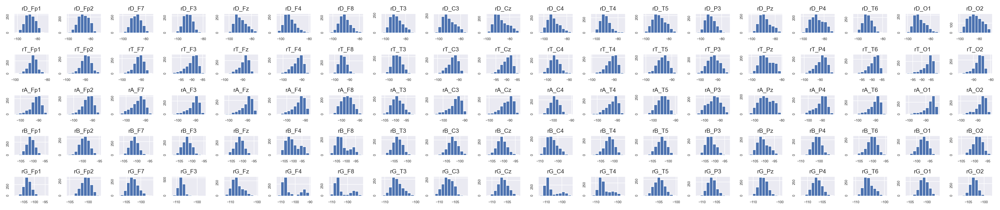

<IPython.core.display.Javascript object>


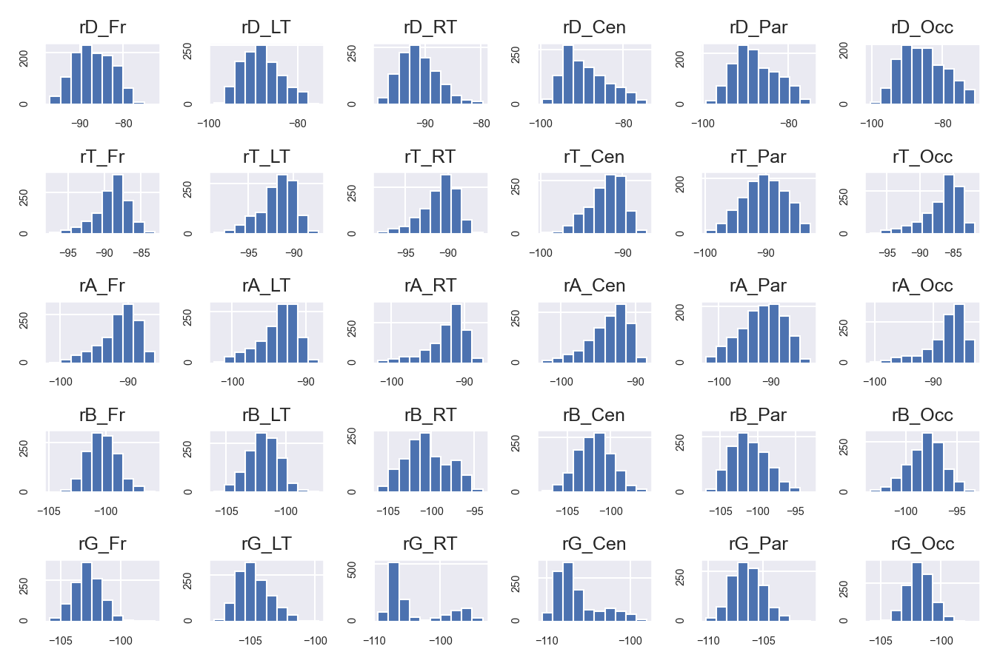

<IPython.core.display.Javascript object>


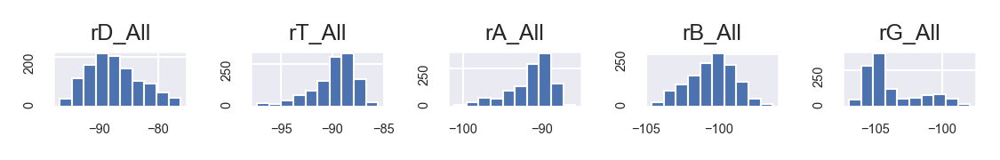

In [36]:
# PSD distribution

#hist = plot_ft_distr_hist(df_ft_psd_raw_sc, row_length=19)
#hist = plot_ft_distr_hist(df_ft_psd_db, row_length=19)
hist = plot_ft_distr_hist(df_ft_rr_psd_db, row_length=19)
hist = plot_ft_distr_hist(df_ft_rr_psd_loc_db, row_length=6)
hist = plot_ft_distr_hist(df_ft_rr_psd_all_db)

<IPython.core.display.Javascript object>


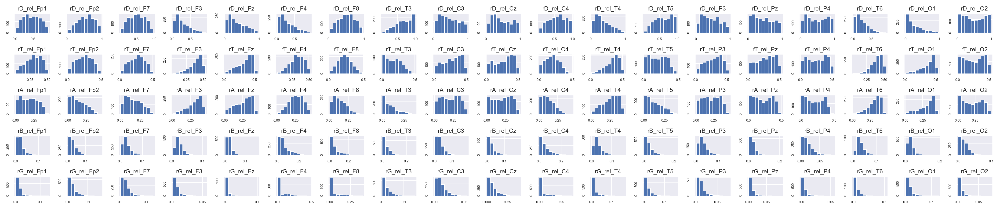

<IPython.core.display.Javascript object>


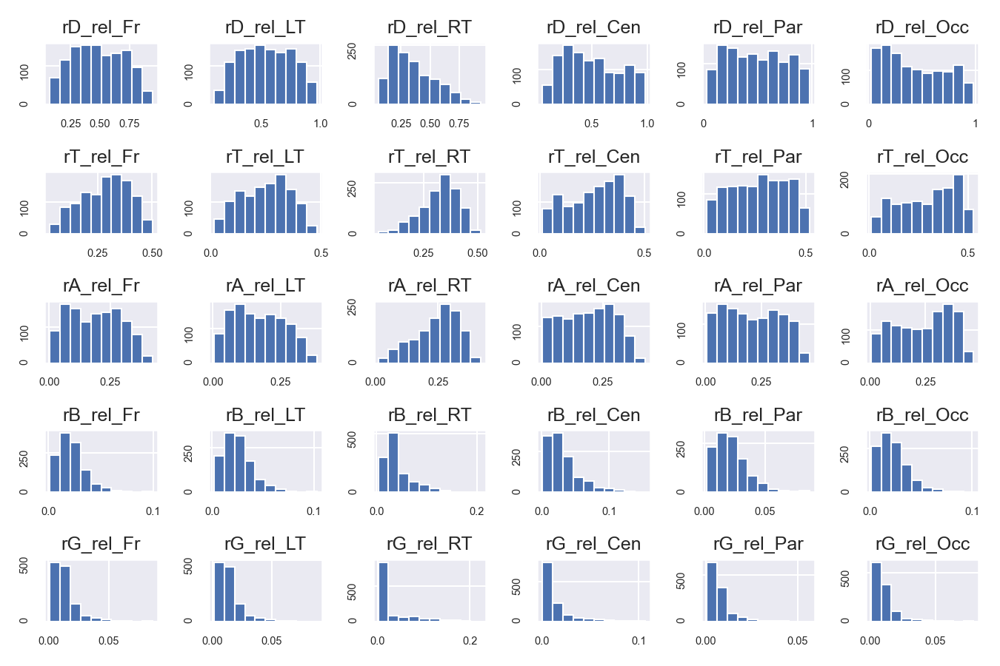

<IPython.core.display.Javascript object>


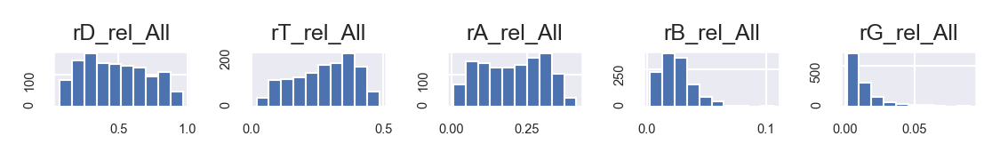

In [37]:
# Relative PSD features (re-referenced data)

ft_rr_psd_spectr_rel = np.empty((n_samples, n_channels, n_freq))
ft_rr_psd_sp_loc_rel = np.empty((n_samples, n_regions, n_freq))
ft_rr_psd_sp_all_rel = np.empty((n_samples, n_freq))

df_ft_rr_psd_rel = pd.DataFrame()
df_ft_rr_psd_loc_rel = pd.DataFrame()
df_ft_rr_psd_all_rel = pd.DataFrame()

for i in range(n_freq):
    ft_rr_psd_spectr_rel[:,:,i] = ft_rr_psd_spectr_raw[:,:,i] / np.sum(ft_rr_psd_spectr_raw, axis=2)
    ft_rr_psd_sp_loc_rel[:,:,i] = ft_rr_psd_sp_loc_raw[:,:,i] / np.sum(ft_rr_psd_sp_loc_raw, axis=2)
    ft_rr_psd_sp_all_rel[:,i] = ft_rr_psd_sp_all_raw[:,i] / np.sum(ft_rr_psd_sp_all_raw, axis=1)

    #df_ft_rr_psd_rel[str_freq_rr[i]+'_rel_All'] = ft_rr_psd_sp_all_rel[:,i]
    for j in range(n_channels):
        df_ft_rr_psd_rel[str_freq_rr[i]+'_rel_'+ch_names[j]] = ft_rr_psd_spectr_rel[:,j,i]
    for j in range(n_regions):
        df_ft_rr_psd_loc_rel[str_freq_rr[i]+'_rel_'+regions[j][1]] = ft_rr_psd_sp_loc_rel[:,j,i]
    df_ft_rr_psd_all_rel[str_freq_rr[i]+'_rel_All'] = ft_rr_psd_sp_all_rel[:,i]

hist = plot_ft_distr_hist(df_ft_rr_psd_rel, row_length=19)
hist = plot_ft_distr_hist(df_ft_rr_psd_loc_rel, row_length=6)
hist = plot_ft_distr_hist(df_ft_rr_psd_all_rel)

# Scaling
ft_rr_psd_rel_sc = StandardScaler().fit_transform(df_ft_rr_psd_rel.to_numpy())
df_ft_rr_psd_rel_sc = pd.DataFrame(ft_rr_psd_rel_sc, columns=df_ft_rr_psd_rel.columns)
ft_rr_psd_loc_rel_sc = StandardScaler().fit_transform(df_ft_rr_psd_loc_rel.to_numpy())
df_ft_rr_psd_loc_rel_sc = pd.DataFrame(ft_rr_psd_loc_rel_sc, columns=df_ft_rr_psd_loc_rel.columns)
ft_rr_psd_all_rel_sc = StandardScaler().fit_transform(df_ft_rr_psd_all_rel.to_numpy())
df_ft_rr_psd_all_rel_sc = pd.DataFrame(ft_rr_psd_all_rel_sc, columns=df_ft_rr_psd_all_rel.columns)

#display_corr_matrix(df_ft_rr_psd_rel.corr())
#display_corr_matrix(df_ft_rr_psd_rel_sc.corr())

<IPython.core.display.Javascript object>


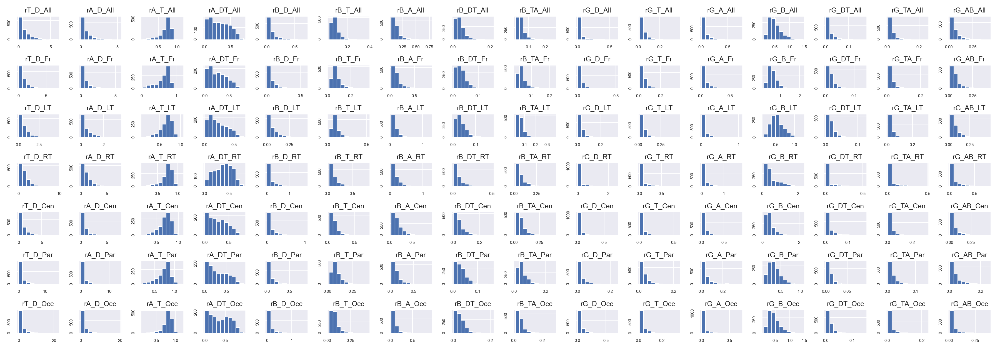

<IPython.core.display.Javascript object>


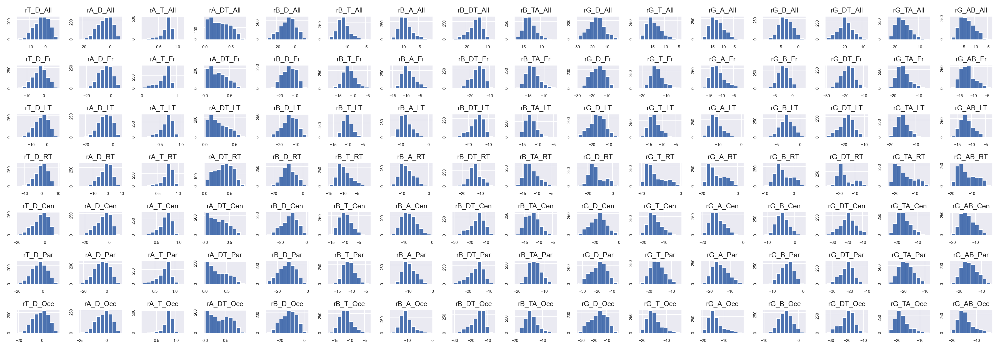

In [38]:
# PSD special features (EEG indices) (re-referenced data)
df_ft_rr_psd_ind = pd.DataFrame()

# Indices for all channels averaged PSD
df_ft_rr_psd_ind['rT_D_All'] = df_ft_rr_psd_all_raw['rT_All'] / df_ft_rr_psd_all_raw['rD_All']
df_ft_rr_psd_ind['rA_D_All'] = df_ft_rr_psd_all_raw['rA_All'] / df_ft_rr_psd_all_raw['rD_All']
df_ft_rr_psd_ind['rA_T_All'] = df_ft_rr_psd_all_raw['rA_All'] / df_ft_rr_psd_all_raw['rT_All']
df_ft_rr_psd_ind['rA_DT_All'] = df_ft_rr_psd_all_raw['rA_All'] / (df_ft_rr_psd_all_raw['rD_All'] + df_ft_rr_psd_all_raw['rT_All'])
df_ft_rr_psd_ind['rB_D_All'] = df_ft_rr_psd_all_raw['rB_All'] / df_ft_rr_psd_all_raw['rD_All']
df_ft_rr_psd_ind['rB_T_All'] = df_ft_rr_psd_all_raw['rB_All'] / df_ft_rr_psd_all_raw['rT_All']
df_ft_rr_psd_ind['rB_A_All'] = df_ft_rr_psd_all_raw['rB_All'] / df_ft_rr_psd_all_raw['rA_All']
df_ft_rr_psd_ind['rB_DT_All'] = df_ft_rr_psd_all_raw['rB_All'] / (df_ft_rr_psd_all_raw['rD_All'] + df_ft_rr_psd_all_raw['rT_All'])
df_ft_rr_psd_ind['rB_TA_All'] = df_ft_rr_psd_all_raw['rB_All'] / (df_ft_rr_psd_all_raw['rT_All'] + df_ft_rr_psd_all_raw['rA_All'])
df_ft_rr_psd_ind['rG_D_All'] = df_ft_rr_psd_all_raw['rG_All'] / df_ft_rr_psd_all_raw['rD_All']
df_ft_rr_psd_ind['rG_T_All'] = df_ft_rr_psd_all_raw['rG_All'] / df_ft_rr_psd_all_raw['rT_All']
df_ft_rr_psd_ind['rG_A_All'] = df_ft_rr_psd_all_raw['rG_All'] / df_ft_rr_psd_all_raw['rA_All']
df_ft_rr_psd_ind['rG_B_All'] = df_ft_rr_psd_all_raw['rG_All'] / df_ft_rr_psd_all_raw['rB_All']
df_ft_rr_psd_ind['rG_DT_All'] = df_ft_rr_psd_all_raw['rG_All'] / (df_ft_rr_psd_all_raw['rD_All'] + df_ft_rr_psd_all_raw['rT_All'])
df_ft_rr_psd_ind['rG_TA_All'] = df_ft_rr_psd_all_raw['rG_All'] / (df_ft_rr_psd_all_raw['rT_All'] + df_ft_rr_psd_all_raw['rA_All'])
df_ft_rr_psd_ind['rG_AB_All'] = df_ft_rr_psd_all_raw['rG_All'] / (df_ft_rr_psd_all_raw['rA_All'] + df_ft_rr_psd_all_raw['rB_All'])

# Indices per region (averaged PSD)
for i in range(n_regions):
    df_ft_rr_psd_ind['rT_D_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rT_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rD_'+regions[i][1]]
    df_ft_rr_psd_ind['rA_D_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rA_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rD_'+regions[i][1]]
    df_ft_rr_psd_ind['rA_T_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rA_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rT_'+regions[i][1]]
    df_ft_rr_psd_ind['rA_DT_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rA_'+regions[i][1]] / (df_ft_rr_psd_loc_raw['rD_'+regions[i][1]] + df_ft_rr_psd_loc_raw['rT_'+regions[i][1]])
    df_ft_rr_psd_ind['rB_D_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rB_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rD_'+regions[i][1]]
    df_ft_rr_psd_ind['rB_T_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rB_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rT_'+regions[i][1]]
    df_ft_rr_psd_ind['rB_A_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rB_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rA_'+regions[i][1]]
    df_ft_rr_psd_ind['rB_DT_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rB_'+regions[i][1]] / (df_ft_rr_psd_loc_raw['rD_'+regions[i][1]] + df_ft_rr_psd_loc_raw['rT_'+regions[i][1]])
    df_ft_rr_psd_ind['rB_TA_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rB_'+regions[i][1]] / (df_ft_rr_psd_loc_raw['rT_'+regions[i][1]] + df_ft_rr_psd_loc_raw['rA_'+regions[i][1]])
    df_ft_rr_psd_ind['rG_D_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rG_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rD_'+regions[i][1]]
    df_ft_rr_psd_ind['rG_T_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rG_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rT_'+regions[i][1]]
    df_ft_rr_psd_ind['rG_A_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rG_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rA_'+regions[i][1]]
    df_ft_rr_psd_ind['rG_B_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rG_'+regions[i][1]] / df_ft_rr_psd_loc_raw['rB_'+regions[i][1]]
    df_ft_rr_psd_ind['rG_DT_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rG_'+regions[i][1]] / (df_ft_rr_psd_loc_raw['rD_'+regions[i][1]] + df_ft_rr_psd_loc_raw['rT_'+regions[i][1]])
    df_ft_rr_psd_ind['rG_TA_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rG_'+regions[i][1]] / (df_ft_rr_psd_loc_raw['rT_'+regions[i][1]] + df_ft_rr_psd_loc_raw['rA_'+regions[i][1]])
    df_ft_rr_psd_ind['rG_AB_'+regions[i][1]] = df_ft_rr_psd_loc_raw['rG_'+regions[i][1]] / (df_ft_rr_psd_loc_raw['rA_'+regions[i][1]] + df_ft_rr_psd_loc_raw['rB_'+regions[i][1]])
    
# Log-scaling PSD indices (dB format)
df_ft_rr_psd_ind_log = 10 * np.log10(df_ft_rr_psd_ind)

# No need to log-scale A|T & A|(D+T)
orig_col = [col for col in df_ft_rr_psd_ind.columns if ('A_T' in col) or ('A_DT' in col)]
df_ft_rr_psd_ind_log[orig_col] = df_ft_rr_psd_ind[orig_col]

# Plotting histograms
hist = plot_ft_distr_hist(df_ft_rr_psd_ind, row_length=16)
hist = plot_ft_distr_hist(df_ft_rr_psd_ind_log, row_length=16)

# Scaling
ft_rr_psd_ind_log_sc = StandardScaler().fit_transform(df_ft_rr_psd_ind_log.to_numpy())
df_ft_rr_psd_ind_log_sc = pd.DataFrame(ft_rr_psd_ind_log_sc, columns=df_ft_rr_psd_ind_log.columns)


In [266]:
display_corr_matrix(df_ft_rr_psd_all_raw.corr())
display_corr_matrix(df_ft_rr_psd_all_db.corr())
display_corr_matrix(df_ft_rr_psd_loc_raw.corr())
display_corr_matrix(df_ft_rr_psd_ind_log.corr())

,rD_All,rT_All,rA_All,rB_All,rG_All
rD_All,1.00,0.16,0.05,-0.01,-0.14
rT_All,0.16,1.00,0.94,0.63,0.14
rA_All,0.05,0.94,1.00,0.66,0.18
rB_All,-0.01,0.63,0.66,1.00,0.56
rG_All,-0.14,0.14,0.18,0.56,1.00


,rD_All,rT_All,rA_All,rB_All,rG_All
rD_All,1.00,0.16,0.01,-0.02,-0.19
rT_All,0.16,1.00,0.92,0.68,0.22
rA_All,0.01,0.92,1.00,0.72,0.26
rB_All,-0.02,0.68,0.72,1.00,0.57
rG_All,-0.19,0.22,0.26,0.57,1.00


,rD_Fr,rD_LT,rD_RT,rD_Cen,rD_Par,rD_Occ,rT_Fr,rT_LT,rT_RT,rT_Cen,rT_Par,rT_Occ,rA_Fr,rA_LT,rA_RT,rA_Cen,rA_Par,rA_Occ,rB_Fr,rB_LT,rB_RT,rB_Cen,rB_Par,rB_Occ,rG_Fr,rG_LT,rG_RT,rG_Cen,rG_Par,rG_Occ
rD_Fr,1.00,0.63,0.63,0.61,0.58,0.62,0.36,0.13,0.07,0.10,-0.09,0.03,-0.04,-0.07,-0.03,-0.02,-0.12,-0.04,0.07,-0.05,-0.15,-0.11,-0.09,0.06,-0.04,-0.06,-0.19,-0.18,-0.11,0.04
rD_LT,0.63,1.00,0.69,0.86,0.83,0.85,0.10,0.17,0.16,0.21,-0.05,0.15,0.02,0.03,0.07,0.09,-0.09,0.08,0.08,0.07,-0.12,-0.07,-0.03,0.12,-0.05,0.00,-0.18,-0.15,-0.02,0.10
rD_RT,0.63,0.69,1.00,0.78,0.59,0.68,0.11,0.13,0.23,0.22,-0.10,0.13,0.01,0.00,0.09,0.09,-0.12,0.07,0.06,0.03,-0.14,-0.10,-0.09,0.07,-0.09,-0.02,-0.20,-0.19,-0.10,0.06
rD_Cen,0.61,0.86,0.78,1.00,0.80,0.88,0.02,0.11,0.15,0.23,-0.05,0.14,0.03,0.03,0.08,0.09,-0.08,0.08,0.08,0.04,-0.17,-0.07,-0.03,0.11,-0.06,-0.04,-0.23,-0.19,-0.07,0.04
rD_Par,0.58,0.83,0.59,0.80,1.00,0.89,0.14,0.21,0.21,0.26,0.05,0.24,0.13,0.13,0.15,0.16,0.01,0.17,0.14,0.13,-0.03,-0.00,0.06,0.16,0.01,0.02,-0.10,-0.08,0.07,0.12
rD_Occ,0.62,0.85,0.68,0.88,0.89,1.00,0.11,0.17,0.18,0.23,0.01,0.21,0.09,0.09,0.11,0.12,-0.02,0.12,0.11,0.08,-0.07,-0.03,0.03,0.14,-0.01,0.01,-0.12,-0.10,0.03,0.10
rT_Fr,0.36,0.10,0.11,0.02,0.14,0.11,1.00,0.66,0.45,0.31,0.41,0.43,0.59,0.48,0.38,0.28,0.37,0.38,0.36,0.24,0.14,0.21,0.30,0.37,0.01,0.01,-0.01,-0.05,0.07,0.09
rT_LT,0.13,0.17,0.13,0.11,0.21,0.17,0.66,1.00,0.74,0.66,0.66,0.78,0.85,0.91,0.74,0.65,0.63,0.76,0.44,0.50,0.28,0.42,0.55,0.60,0.03,0.13,0.06,0.04,0.27,0.15
rT_RT,0.07,0.16,0.23,0.15,0.21,0.18,0.45,0.74,1.00,0.84,0.34,0.87,0.72,0.73,0.94,0.84,0.32,0.85,0.30,0.35,0.24,0.23,0.24,0.51,-0.02,0.07,-0.01,-0.03,0.12,0.09
rT_Cen,0.10,0.21,0.22,0.23,0.26,0.23,0.31,0.66,0.84,1.00,0.24,0.85,0.61,0.66,0.86,0.94,0.23,0.83,0.29,0.32,0.22,0.23,0.19,0.49,-0.02,0.05,0.00,-0.01,0.10,0.08


In [ ]:
# Topological features


In [ ]:
# Calculating Covariance

In [ ]:
# Calculating PLV and Coherence


# Features exploration

# Dimesion reduction

In [39]:
# Global variables
print(ft_rr_psd_spectr_db.shape)

n_samples = len(ft_rr_psd_spectr_db[:,0,0])
n_channels = len(ft_rr_psd_spectr_db[0,:,0])
n_freq = len(ft_rr_psd_spectr_db[0,0,:])


(1167, 19, 5)


In [40]:
# Finding features with best IV and constructing arrays of their IVs and WoEs 
def subspace_corr_max_sum(df_features, corr_threshold=0.8):
    n_features = len(df_features.columns)
    feature_list = df_features.columns
    best_feature_list = []
    best_ft_pca_list = []
    df_clusters = pd.DataFrame(columns = ['Name_1st', 'Name_PCA', 'Cluster', 'Correlations', 'Corr_PCA'])
    df_features_cl_avg = pd.DataFrame()

    df_matr_corr = abs(df_features.corr())
    while len(df_matr_corr.columns) > 0:
        df_sum = df_matr_corr.sum(axis=1)
        curr_var = df_sum[df_sum==max(df_sum)].index.to_list()[0]
        cluster_list=[]
        corr_list = []
        df_matr_corr = df_matr_corr.sort_values(curr_var, ascending = False)
        index_list = df_matr_corr.index.to_list()
        for i in range(len(index_list)):
            value = df_matr_corr.loc[index_list[i], curr_var]
            if (value >= corr_threshold):
                cluster_list.append(index_list[i])
                corr_list.append(df_matr_corr.loc[index_list[i], curr_var])
            else: 
                break
        df_matr_corr.drop(index = cluster_list, columns = cluster_list, inplace = True)
        best_feature_list.append(curr_var)

        # Find var with max correlation with 1st PCA component in cluster_list
        ft_clust_sc = StandardScaler().fit_transform(df_features[cluster_list].to_numpy()) 
        ft_pca_main = decomposition.PCA(n_components=1).fit_transform(ft_clust_sc)
        pca_corr_list = [abs(np.corrcoef(ft_pca_main.flatten(), ft_clust_sc[:,i])[0,1]) for i in range(len(cluster_list))]
        pca_var = cluster_list[np.argmax(pca_corr_list)]
        best_ft_pca_list.append(pca_var)
        
        corr_list = [round(x,2) for x in corr_list]
        pca_corr_list = [round(x,2) for x in pca_corr_list]
        new_row = {'Name_1st': curr_var, 'Name_PCA': pca_var, 'Cluster': cluster_list, 
                   'Correlations': corr_list, 'Corr_PCA': pca_corr_list}
        df_clusters = df_clusters.append(new_row, ignore_index = True)
        df_features_cl_avg[curr_var+'_avg'] = df_features[cluster_list].mean(axis=1)

        if len(df_matr_corr.columns) > 0:
            curr_var = index_list[-1]
    #display(df_feature_cl_avg)
        
    return best_feature_list, best_ft_pca_list, df_clusters, df_features_cl_avg


In [41]:
def subspace_corr_min_sum(df_features, corr_threshold=0.8):
    n_features = len(df_features.columns)
    feature_list = df_features.columns
    best_feature_list = []
    best_ft_pca_list = []
    df_clusters = pd.DataFrame(columns = ['Name_1st', 'Name_PCA', 'Cluster', 'Correlations', 'Corr_PCA'])
    df_features_cl_avg = pd.DataFrame()

    df_matr_corr = abs(df_features.corr())
    while len(df_matr_corr.columns) > 0:
        df_sum = df_matr_corr.sum(axis=1)
        curr_var = df_sum[df_sum==min(df_sum)].index.to_list()[0]
        cluster_list=[]
        corr_list = []
        df_matr_corr = df_matr_corr.sort_values(curr_var, ascending = False)
        index_list = df_matr_corr.index.to_list()
        for i in range(len(index_list)):
            value = df_matr_corr.loc[index_list[i], curr_var]
            if (value >= corr_threshold):
                cluster_list.append(index_list[i])
                corr_list.append(df_matr_corr.loc[index_list[i], curr_var])
            else: 
                break
        df_matr_corr.drop(index = cluster_list, columns = cluster_list, inplace = True)
        best_feature_list.append(curr_var)

        # Find var with max correlation with 1st PCA component in cluster_list
        ft_clust_sc = StandardScaler().fit_transform(df_features[cluster_list].to_numpy()) 
        ft_pca_main = decomposition.PCA(n_components=1).fit_transform(ft_clust_sc)
        pca_corr_list = [abs(np.corrcoef(ft_pca_main.flatten(), ft_clust_sc[:,i])[0,1]) for i in range(len(cluster_list))]
        pca_var = cluster_list[np.argmax(pca_corr_list)]
        best_ft_pca_list.append(pca_var)
       
        corr_list = [round(x,2) for x in corr_list]
        pca_corr_list = [round(x,2) for x in pca_corr_list]
        new_row = {'Name_1st': curr_var, 'Name_PCA': pca_var, 'Cluster': cluster_list, 
                   'Correlations': corr_list, 'Corr_PCA': pca_corr_list}
        df_clusters = df_clusters.append(new_row, ignore_index = True)
        df_features_cl_avg[curr_var+'_avg'] = df_features[cluster_list].mean(axis=1)

        if len(df_matr_corr.columns) > 0:
            curr_var = index_list[-1]
    #display(df_feature_cl_avg)
        
    return best_feature_list, best_ft_pca_list, df_clusters, df_features_cl_avg


In [42]:
# Finding features with best IV and constructing arrays of their IVs and WoEs 
def subspace_corr_max1_least(df_features, corr_threshold=0.8):
    n_features = len(df_features.columns)
    feature_list = df_features.columns
    best_feature_list = []
    best_ft_pca_list = []
    df_clusters = pd.DataFrame(columns = ['Name_1st', 'Name_PCA', 'Cluster', 'Correlations', 'Corr_PCA'])
    df_features_cl_avg = pd.DataFrame()

    df_matr_corr = abs(df_features.corr())
    df_sum = df_matr_corr.sum(axis=1)
    curr_var = df_sum[df_sum==max(df_sum)].index.to_list()[0]
    
    while len(df_matr_corr.columns) > 0:
        cluster_list=[]
        corr_list = []
        df_matr_corr = df_matr_corr.sort_values(curr_var, ascending = False)
        index_list = df_matr_corr.index.to_list()
        for i in range(len(index_list)):
            value = df_matr_corr.loc[index_list[i], curr_var]
            if (value >= corr_threshold):
                cluster_list.append(index_list[i])
                corr_list.append(df_matr_corr.loc[index_list[i], curr_var])
            else:
                break
        df_matr_corr.drop(index = cluster_list, columns = cluster_list, inplace = True)
        best_feature_list.append(curr_var)

        # Find var with max correlation with 1st PCA component in cluster_list
        ft_clust_sc = StandardScaler().fit_transform(df_features[cluster_list].to_numpy()) 
        ft_pca_main = decomposition.PCA(n_components=1).fit_transform(ft_clust_sc)
        pca_corr_list = [abs(np.corrcoef(ft_pca_main.flatten(), ft_clust_sc[:,i])[0,1]) for i in range(len(cluster_list))]
        pca_var = cluster_list[np.argmax(pca_corr_list)]
        best_ft_pca_list.append(pca_var)
        
        corr_list = [round(x,2) for x in corr_list]
        pca_corr_list = [round(x,2) for x in pca_corr_list]
        new_row = {'Name_1st': curr_var, 'Name_PCA': pca_var, 'Cluster': cluster_list, 
                   'Correlations': corr_list, 'Corr_PCA': pca_corr_list}
        df_clusters = df_clusters.append(new_row, ignore_index = True)
        df_features_cl_avg[curr_var+'_avg'] = df_features[cluster_list].mean(axis=1)

        if len(df_matr_corr.columns) > 0:
            curr_var = index_list[-1]
    #display(df_feature_cl_avg)
        
    return best_feature_list, best_ft_pca_list, df_clusters, df_features_cl_avg


In [43]:
# Finding features with best IV and constructing arrays of their IVs and WoEs 
def subspace_corr_min1_least(df_features, corr_threshold=0.8):
    n_features = len(df_features.columns)
    feature_list = df_features.columns
    best_feature_list = []
    best_ft_pca_list = []
    df_clusters = pd.DataFrame(columns = ['Name_1st', 'Name_PCA', 'Cluster', 'Correlations', 'Corr_PCA'])
    df_features_cl_avg = pd.DataFrame()
    
    df_matr_corr = abs(df_features.corr())
    df_sum = df_matr_corr.sum(axis=1)
    curr_var = df_sum[df_sum==min(df_sum)].index.to_list()[0]
    
    while len(df_matr_corr.columns) > 0:
        cluster_list=[]
        corr_list = []
        df_matr_corr = df_matr_corr.sort_values(curr_var, ascending = False)
        index_list = df_matr_corr.index.to_list()
        for i in range(len(index_list)):
            value = df_matr_corr.loc[index_list[i], curr_var]
            if (value >= corr_threshold):
                cluster_list.append(index_list[i])
                corr_list.append(df_matr_corr.loc[index_list[i], curr_var])
            else:
                break
        df_matr_corr.drop(index = cluster_list, columns = cluster_list, inplace = True)
        best_feature_list.append(curr_var)
        
        # Find var with max correlation with 1st PCA component in cluster_list
        ft_clust_sc = StandardScaler().fit_transform(df_features[cluster_list].to_numpy()) 
        ft_pca_main = decomposition.PCA(n_components=1).fit_transform(ft_clust_sc)
        pca_corr_list = [abs(np.corrcoef(ft_pca_main.flatten(), ft_clust_sc[:,i])[0,1]) for i in range(len(cluster_list))]
        pca_var = cluster_list[np.argmax(pca_corr_list)]
        best_ft_pca_list.append(pca_var)
        
        corr_list = [round(x,2) for x in corr_list]
        pca_corr_list = [round(x,2) for x in pca_corr_list]
        new_row = {'Name_1st': curr_var, 'Name_PCA': pca_var, 'Cluster': cluster_list, 
                   'Correlations': corr_list, 'Corr_PCA': pca_corr_list}
        df_clusters = df_clusters.append(new_row, ignore_index = True)
        df_features_cl_avg[curr_var+'_avg'] = df_features[cluster_list].mean(axis=1)

        if len(df_matr_corr.columns) > 0:
            curr_var = index_list[-1]
       
    #display(df_feature_cl_avg)
        
    return best_feature_list, best_ft_pca_list, df_clusters, df_features_cl_avg


In [44]:
# Calculate R2, MSE, correlation distance to the subspace for each feature
def dim_reduct_quality(features, subspace):
    features_sc = StandardScaler().fit_transform(features)
    subspace_sc = StandardScaler().fit_transform(subspace)
    
    n_features = len(features[0,:])
    n_basis = len(subspace[0,:])
    ev_score = np.empty(n_features) # explained variance
    r2_score = np.empty(n_features) # R-square (measure of determination)
    mse_score = np.empty(n_features) # mean squared error
    corr_dist = [] # pairwise correlation distance vector (lenth n*(n-1)/2)
    
    for i in range(n_features):
        y_true = features_sc[:,i]
        reg = LinearRegression().fit(subspace_sc, y_true)
        y_pred = reg.predict(subspace_sc)
        ev_score[i] = metrics.explained_variance_score(y_true, y_pred) 
        r2_score[i] = metrics.r2_score(y_true, y_pred)
        mse_score[i] = metrics.mean_squared_error(y_true, y_pred)
    
    df_subsp_matr_corr = abs(pd.DataFrame(subspace).corr())
    for i in range(n_basis):
        for j in range(i+1, n_basis):
            corr_dist.append(1 - df_subsp_matr_corr.loc[i,j])
            
    return ev_score, r2_score, mse_score, np.array(corr_dist)

In [45]:
# Form the table with dimension reduction quality metrics for different methods
def calc_dim_red_qlty_metrics(features, subspace, method_name, df_metrics, print_raw = False):
    expl_var, r2, mse, corr_dist = dim_reduct_quality(features, subspace)
    n_basis = len(subspace[0,:])
    if print_raw:
        print(method_name)
        #print('Explained variance:', [round(x,2) for x in r2])
        print('R-square:', [round(x,2) for x in r2])
        print('Mean squared error:', [round(x,2) for x in mse])
        print('Correlation distance:', [round(x,2) for x in corr_dist])
    df_metrics = df_metrics.drop(df_metrics[df_metrics['Method']==method_name].index, errors='ignore')
    #'EV_mean': [np.mean(expl_var)], 'EV_std': [np.std(expl_var)], 'EV_min': [np.min(expl_var)], 
    new_row = {'Method': [method_name], 'N_var': n_basis, 'R2_mean': [np.mean(r2)], 'R2_std': [np.std(r2)], 
               'R2_min': [np.min(r2)], 'MSE_mean': [np.mean(mse)], 'MSE_std': [np.std(mse)], 'MSE_max': [np.max(mse)], 
               'CorrD_mean': [np.mean(corr_dist)], 'CorrD_std': [np.std(corr_dist)], 'CorrD_min': [np.min(corr_dist)], 
               'R2_Corr_Ind': [np.mean(r2)*np.mean(corr_dist)]}
    df_new_row = pd.DataFrame(data=new_row)
    df_metrics = pd.concat([df_metrics, df_new_row], ignore_index = True)
    
    return df_metrics


## PSD features

In [46]:
# Apply dimension reduction algorithms to the full range PSD data (re-referenced)

# Building subspaces
df_features = df_ft_rr_psd_db_sc

best_ft_list_max, best_ft_pca_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_features, corr_threshold=0.7)
best_ft_list_min, best_ft_pca_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_features, corr_threshold=0.7)
best_ft_list_max1, best_ft_pca_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_features, corr_threshold=0.7)
best_ft_list_min1, best_ft_pca_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_features, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_features.to_numpy()

subspace = df_features[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_features[best_ft_pca_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
df_ft_psd_alg = df_features[best_ft_list_min]
df_ft_psd_alg_pca = df_features[best_ft_pca_min]
df_ft_psd_alg_avg = df_ft_cl_avg_min
df_clusters = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_ft_psd_alg.corr())
print('PCA features by cluster')
display_corr_matrix(df_ft_psd_alg_pca.corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_psd_alg_avg.corr())
print('Clusters structure')
display(df_clusters)


44 49 43 45


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,44,0.89,0.12,0.64,0.11,0.12,0.36,0.80,0.16,0.30,0.71
1,Corr_min_sum_rr,49,0.92,0.10,0.69,0.08,0.10,0.31,0.79,0.17,0.30,0.72
2,Corr_max1_least_rr,43,0.89,0.11,0.64,0.11,0.11,0.36,0.80,0.16,0.30,0.72
3,Corr_min1_least_rr,45,0.90,0.11,0.62,0.10,0.11,0.38,0.80,0.17,0.30,0.72
4,Corr_max_sum_rr_pca,44,0.90,0.11,0.62,0.10,0.11,0.38,0.80,0.16,0.18,0.73
5,Corr_min_sum_rr_pca,49,0.92,0.10,0.64,0.08,0.10,0.36,0.79,0.18,0.13,0.73
6,Corr_max1_lst_rr_pca,43,0.90,0.11,0.63,0.10,0.11,0.37,0.80,0.17,0.19,0.72
7,Corr_min1_lst_rr_pca,45,0.91,0.11,0.63,0.09,0.11,0.37,0.80,0.17,0.19,0.72
8,Corr_max_sum_rr_avg,44,0.93,0.07,0.74,0.07,0.07,0.26,0.79,0.17,0.21,0.74
9,Corr_min_sum_rr_avg,49,0.94,0.05,0.77,0.06,0.05,0.23,0.78,0.19,0.08,0.73


Main features by cluster


,rG_Fp2,rG_F3,rD_F3,rD_F8,rG_O2,rD_T6,rD_F7,rB_Fp2,rG_F7,rG_O1,rG_Fp1,rD_F4,rD_T5,rD_Fz,rD_O1,rD_P3,rD_Fp2,rD_T4,rT_T3,rT_T5,rT_C4,rT_Fp1,rG_T5,rG_C3,rG_T3,rG_Cz,rG_Fz,rG_T6,rG_P3,rB_T3,rG_P4,rB_Fp1,rB_F7,rA_T3,rB_T5,rB_C4,rT_F8,rA_C4,rB_C3,rB_Cz,rB_P3,rT_Pz,rB_P4,rB_F3,rT_F7,rB_Fz,rB_T4,rT_F4,rT_C3
rG_Fp2,1.00,0.04,-0.00,-0.10,0.23,-0.07,0.01,0.24,0.20,0.20,0.30,-0.02,-0.00,-0.04,-0.01,-0.01,-0.01,0.00,-0.02,-0.02,0.01,0.04,0.15,0.06,0.14,0.19,0.15,0.18,0.32,0.09,0.29,0.11,0.05,0.12,0.08,0.12,0.06,0.04,0.00,0.07,0.12,0.11,0.06,-0.03,0.03,0.01,0.06,-0.01,-0.05
rG_F3,0.04,1.00,0.06,0.05,0.29,0.07,0.01,0.03,0.37,0.24,0.34,0.05,0.03,-0.01,0.01,0.08,0.01,0.00,0.06,0.01,0.05,0.05,0.21,0.25,0.19,0.18,0.25,0.29,0.18,0.16,0.29,0.23,0.20,0.08,0.11,0.17,0.12,0.08,0.12,0.10,0.07,0.04,0.12,0.28,0.09,0.08,0.15,0.05,0.03
rD_F3,-0.00,0.06,1.00,0.26,0.10,0.56,0.46,0.08,-0.01,0.06,-0.01,0.31,0.47,0.40,0.45,0.44,0.43,0.41,0.18,0.26,0.10,0.23,0.04,0.09,0.01,-0.02,0.00,-0.00,0.03,0.02,0.01,0.10,0.04,0.01,0.02,-0.03,0.09,-0.07,0.04,-0.03,0.01,0.02,0.06,0.05,0.15,0.01,-0.02,-0.02,0.03
rD_F8,-0.10,0.05,0.26,1.00,0.07,0.30,0.31,0.01,-0.03,0.03,-0.05,0.32,0.40,0.40,0.37,0.46,0.38,0.30,0.20,0.19,0.15,0.05,-0.05,0.09,-0.09,-0.10,-0.04,-0.09,-0.05,0.04,-0.04,0.00,0.07,-0.03,0.02,-0.14,0.40,-0.05,0.08,-0.04,-0.03,-0.06,0.03,0.09,0.06,0.05,-0.01,0.04,0.13
rG_O2,0.23,0.29,0.10,0.07,1.00,0.16,0.13,0.13,0.25,0.35,0.28,0.12,0.15,0.10,0.11,0.14,0.11,0.05,0.06,0.09,0.09,0.12,0.21,0.22,0.19,0.21,0.29,0.36,0.26,0.17,0.36,0.17,0.16,0.14,0.20,0.18,0.17,0.09,0.12,0.14,0.17,0.18,0.19,0.10,0.17,0.15,0.16,0.14,0.10
rD_T6,-0.07,0.07,0.56,0.30,0.16,1.00,0.58,0.07,-0.01,0.04,-0.06,0.38,0.60,0.46,0.54,0.45,0.53,0.52,0.21,0.38,0.14,0.29,-0.02,0.02,-0.07,-0.10,-0.06,-0.09,-0.08,-0.03,-0.05,0.08,0.03,-0.06,0.02,-0.14,0.06,-0.08,0.00,-0.06,-0.06,-0.06,0.01,0.05,0.16,0.05,-0.02,-0.01,0.05
rD_F7,0.01,0.01,0.46,0.31,0.13,0.58,1.00,0.11,-0.02,0.01,-0.05,0.38,0.57,0.52,0.50,0.54,0.52,0.40,0.19,0.29,0.17,0.25,-0.05,0.02,-0.09,-0.08,-0.06,-0.09,-0.02,-0.04,-0.01,0.11,0.12,-0.01,0.02,-0.11,0.07,-0.05,0.03,0.00,-0.00,-0.01,0.05,0.07,0.27,0.06,-0.02,-0.01,0.05
rB_Fp2,0.24,0.03,0.08,0.01,0.13,0.07,0.11,1.00,0.03,0.04,0.05,0.09,0.15,0.10,0.11,0.13,0.12,0.12,0.12,0.19,0.21,0.22,-0.04,-0.05,-0.07,0.03,-0.03,-0.01,0.09,0.08,0.09,0.46,0.23,0.19,0.15,0.10,0.14,0.17,0.15,0.26,0.40,0.14,0.40,0.30,0.21,0.34,0.16,0.15,0.09
rG_F7,0.20,0.37,-0.01,-0.03,0.25,-0.01,-0.02,0.03,1.00,0.29,0.66,-0.00,-0.05,-0.03,0.03,0.02,-0.01,-0.04,0.09,-0.04,0.03,0.06,0.28,0.22,0.44,0.43,0.32,0.43,0.39,0.25,0.48,0.22,0.31,0.18,0.15,0.32,0.13,0.16,0.12,0.15,0.14,0.18,0.11,0.04,0.13,0.07,0.23,0.09,0.05
rG_O1,0.20,0.24,0.06,0.03,0.35,0.04,0.01,0.04,0.29,1.00,0.34,0.02,0.07,0.01,-0.02,0.06,-0.02,-0.06,0.10,0.01,0.02,0.07,0.50,0.33,0.35,0.30,0.38,0.41,0.49,0.21,0.32,0.20,0.16,0.14,0.18,0.27,0.12,0.10,0.11,0.12,0.15,0.18,0.18,0.08,0.15,0.09,0.20,0.12,0.11


PCA features by cluster


,rG_Fp2,rG_F3,rD_F3,rD_F8,rG_O2,rD_T6,rD_F7,rB_Fp2,rG_F7,rG_O1,rG_Fp1,rD_F4,rD_O2,rD_C3,rD_O1,rD_P3,rD_Fp1,rD_T4,rT_T3,rA_T5,rT_C4,rT_Fp1,rG_T5,rG_C3,rG_T3,rG_Cz,rG_F4,rB_F8,rG_Pz,rB_T3,rG_P4,rB_Fp1,rB_F7,rA_T3,rB_T5,rB_C4,rT_F8,rA_C4,rB_C3,rB_Cz,rA_P3,rA_P4,rB_P4,rB_F3,rA_Fp1,rB_O2,rB_T4,rA_Fz,rA_T6
rG_Fp2,1.00,0.04,-0.00,-0.10,0.23,-0.07,0.01,0.24,0.20,0.20,0.30,-0.02,0.01,-0.05,-0.01,-0.01,0.02,0.00,-0.02,-0.04,0.01,0.04,0.15,0.06,0.14,0.19,0.15,0.17,0.34,0.09,0.29,0.11,0.05,0.12,0.08,0.12,0.06,0.04,0.00,0.07,0.07,0.04,0.06,-0.03,0.04,0.00,0.06,-0.03,-0.05
rG_F3,0.04,1.00,0.06,0.05,0.29,0.07,0.01,0.03,0.37,0.24,0.34,0.05,0.02,-0.00,0.01,0.08,-0.01,0.00,0.06,-0.00,0.05,0.05,0.21,0.25,0.19,0.18,0.16,0.19,0.19,0.16,0.29,0.23,0.20,0.08,0.11,0.17,0.12,0.08,0.12,0.10,0.05,0.10,0.12,0.28,0.09,0.10,0.15,0.05,0.05
rD_F3,-0.00,0.06,1.00,0.26,0.10,0.56,0.46,0.08,-0.01,0.06,-0.01,0.31,0.45,0.36,0.45,0.44,0.41,0.41,0.18,0.06,0.10,0.23,0.04,0.09,0.01,-0.02,-0.02,0.01,-0.00,0.02,0.01,0.10,0.04,0.01,0.02,-0.03,0.09,-0.07,0.04,-0.03,-0.05,-0.01,0.06,0.05,0.03,0.08,-0.02,-0.03,-0.02
rD_F8,-0.10,0.05,0.26,1.00,0.07,0.30,0.31,0.01,-0.03,0.03,-0.05,0.32,0.43,0.47,0.37,0.46,0.25,0.30,0.20,0.09,0.15,0.05,-0.05,0.09,-0.09,-0.10,-0.13,-0.07,-0.11,0.04,-0.04,0.00,0.07,-0.03,0.02,-0.14,0.40,-0.05,0.08,-0.04,-0.03,0.02,0.03,0.09,0.03,0.14,-0.01,0.04,0.08
rG_O2,0.23,0.29,0.10,0.07,1.00,0.16,0.13,0.13,0.25,0.35,0.28,0.12,0.15,0.08,0.11,0.14,0.05,0.05,0.06,0.05,0.09,0.12,0.21,0.22,0.19,0.21,0.21,0.22,0.26,0.17,0.36,0.17,0.16,0.14,0.20,0.18,0.17,0.09,0.12,0.14,0.14,0.18,0.19,0.10,0.14,0.18,0.16,0.10,0.05
rD_T6,-0.07,0.07,0.56,0.30,0.16,1.00,0.58,0.07,-0.01,0.04,-0.06,0.38,0.49,0.41,0.54,0.45,0.53,0.52,0.21,0.10,0.14,0.29,-0.02,0.02,-0.07,-0.10,-0.13,-0.10,-0.08,-0.03,-0.05,0.08,0.03,-0.06,0.02,-0.14,0.06,-0.08,0.00,-0.06,-0.10,-0.05,0.01,0.05,0.02,0.13,-0.02,-0.02,0.03
rD_F7,0.01,0.01,0.46,0.31,0.13,0.58,1.00,0.11,-0.02,0.01,-0.05,0.38,0.54,0.49,0.50,0.54,0.52,0.40,0.19,0.11,0.17,0.25,-0.05,0.02,-0.09,-0.08,-0.13,-0.10,-0.05,-0.04,-0.01,0.11,0.12,-0.01,0.02,-0.11,0.07,-0.05,0.03,0.00,-0.07,-0.01,0.05,0.07,0.04,0.16,-0.02,-0.01,0.03
rB_Fp2,0.24,0.03,0.08,0.01,0.13,0.07,0.11,1.00,0.03,0.04,0.05,0.09,0.14,0.11,0.11,0.13,0.13,0.12,0.12,0.17,0.21,0.22,-0.04,-0.05,-0.07,0.03,-0.07,0.08,0.10,0.08,0.09,0.46,0.23,0.19,0.15,0.10,0.14,0.17,0.15,0.26,0.20,0.18,0.40,0.30,0.25,0.35,0.16,0.17,0.10
rG_F7,0.20,0.37,-0.01,-0.03,0.25,-0.01,-0.02,0.03,1.00,0.29,0.66,-0.00,-0.03,-0.08,0.03,0.02,-0.01,-0.04,0.09,-0.02,0.03,0.06,0.28,0.22,0.44,0.43,0.36,0.39,0.47,0.25,0.48,0.22,0.31,0.18,0.15,0.32,0.13,0.16,0.12,0.15,0.13,0.15,0.11,0.04,0.13,0.09,0.23,0.08,0.04
rG_O1,0.20,0.24,0.06,0.03,0.35,0.04,0.01,0.04,0.29,1.00,0.34,0.02,0.04,-0.04,-0.02,0.06,-0.05,-0.06,0.10,-0.00,0.02,0.07,0.50,0.33,0.35,0.30,0.42,0.40,0.33,0.21,0.32,0.20,0.16,0.14,0.18,0.27,0.12,0.10,0.11,0.12,0.13,0.19,0.18,0.08,0.15,0.13,0.20,0.08,0.07


Averaged features by cluster


,rG_Fp2_avg,rG_F3_avg,rD_F3_avg,rD_F8_avg,rG_O2_avg,rD_T6_avg,rD_F7_avg,rB_Fp2_avg,rG_F7_avg,rG_O1_avg,rG_Fp1_avg,rD_F4_avg,rD_T5_avg,rD_Fz_avg,rD_O1_avg,rD_P3_avg,rD_Fp2_avg,rD_T4_avg,rT_T3_avg,rT_T5_avg,rT_C4_avg,rT_Fp1_avg,rG_T5_avg,rG_C3_avg,rG_T3_avg,rG_Cz_avg,rG_Fz_avg,rG_T6_avg,rG_P3_avg,rB_T3_avg,rG_P4_avg,rB_Fp1_avg,rB_F7_avg,rA_T3_avg,rB_T5_avg,rB_C4_avg,rT_F8_avg,rA_C4_avg,rB_C3_avg,rB_Cz_avg,rB_P3_avg,rT_Pz_avg,rB_P4_avg,rB_F3_avg,rT_F7_avg,rB_Fz_avg,rB_T4_avg,rT_F4_avg,rT_C3_avg
rG_Fp2_avg,1.00,0.04,-0.00,-0.10,0.23,-0.07,0.01,0.24,0.20,0.20,0.30,-0.02,-0.00,-0.04,-0.01,-0.01,0.01,0.00,-0.02,-0.05,0.01,0.05,0.15,0.06,0.14,0.19,0.17,0.19,0.36,0.09,0.29,0.11,0.05,0.12,0.08,0.12,0.09,0.04,0.00,0.07,0.11,0.06,0.06,-0.03,0.03,0.01,0.04,-0.03,-0.06
rG_F3_avg,0.04,1.00,0.06,0.05,0.29,0.07,0.01,0.03,0.37,0.24,0.34,0.05,0.02,0.00,0.01,0.08,-0.00,0.00,0.06,0.02,0.05,0.05,0.21,0.25,0.19,0.18,0.21,0.26,0.20,0.16,0.29,0.23,0.20,0.08,0.11,0.17,0.13,0.08,0.12,0.10,0.06,0.09,0.12,0.28,0.09,0.10,0.12,0.07,0.05
rD_F3_avg,-0.00,0.06,1.00,0.26,0.10,0.56,0.46,0.08,-0.01,0.06,-0.01,0.31,0.46,0.40,0.45,0.44,0.45,0.41,0.18,0.16,0.10,0.23,0.04,0.09,0.01,-0.02,-0.02,0.00,0.01,0.02,0.01,0.10,0.04,0.01,0.02,-0.03,0.05,-0.07,0.04,-0.03,-0.01,0.02,0.06,0.05,0.07,0.05,-0.03,-0.01,0.01
rD_F8_avg,-0.10,0.05,0.26,1.00,0.07,0.30,0.31,0.01,-0.03,0.03,-0.05,0.32,0.48,0.47,0.37,0.46,0.34,0.30,0.20,0.15,0.15,0.07,-0.05,0.09,-0.09,-0.10,-0.13,-0.09,-0.09,0.04,-0.04,0.00,0.07,-0.03,0.02,-0.14,0.24,-0.05,0.08,-0.04,-0.04,0.01,0.03,0.09,0.05,0.08,0.03,0.06,0.11
rG_O2_avg,0.23,0.29,0.10,0.07,1.00,0.16,0.13,0.13,0.25,0.35,0.28,0.12,0.15,0.09,0.11,0.14,0.08,0.05,0.06,0.07,0.09,0.13,0.21,0.22,0.19,0.21,0.24,0.31,0.28,0.17,0.36,0.17,0.16,0.14,0.20,0.18,0.20,0.09,0.12,0.14,0.18,0.19,0.19,0.10,0.16,0.17,0.14,0.12,0.07
rD_T6_avg,-0.07,0.07,0.56,0.30,0.16,1.00,0.58,0.07,-0.01,0.04,-0.06,0.38,0.54,0.49,0.54,0.45,0.57,0.52,0.21,0.25,0.14,0.30,-0.02,0.02,-0.07,-0.10,-0.13,-0.10,-0.09,-0.03,-0.05,0.08,0.03,-0.06,0.02,-0.14,-0.01,-0.08,0.00,-0.06,-0.09,-0.03,0.01,0.05,0.06,0.07,0.00,0.00,0.05
rD_F7_avg,0.01,0.01,0.46,0.31,0.13,0.58,1.00,0.11,-0.02,0.01,-0.05,0.38,0.61,0.58,0.50,0.54,0.56,0.40,0.19,0.19,0.17,0.26,-0.05,0.02,-0.09,-0.08,-0.13,-0.10,-0.04,-0.04,-0.01,0.11,0.12,-0.01,0.02,-0.11,0.02,-0.05,0.03,0.00,-0.03,0.02,0.05,0.07,0.10,0.10,0.01,0.01,0.05
rB_Fp2_avg,0.24,0.03,0.08,0.01,0.13,0.07,0.11,1.00,0.03,0.04,0.05,0.09,0.15,0.12,0.11,0.13,0.13,0.12,0.12,0.16,0.21,0.23,-0.04,-0.05,-0.07,0.03,-0.03,0.04,0.10,0.08,0.09,0.46,0.23,0.19,0.15,0.10,0.17,0.17,0.15,0.26,0.28,0.19,0.40,0.30,0.25,0.39,0.22,0.16,0.10
rG_F7_avg,0.20,0.37,-0.01,-0.03,0.25,-0.01,-0.02,0.03,1.00,0.29,0.66,-0.00,-0.05,-0.07,0.03,0.02,-0.01,-0.04,0.09,-0.01,0.03,0.07,0.28,0.22,0.44,0.43,0.41,0.44,0.47,0.25,0.48,0.22,0.31,0.18,0.15,0.32,0.19,0.16,0.12,0.15,0.17,0.17,0.11,0.04,0.13,0.09,0.17,0.10,0.05
rG_O1_avg,0.20,0.24,0.06,0.03,0.35,0.04,0.01,0.04,0.29,1.00,0.34,0.02,0.03,-0.03,-0.02,0.06,-0.04,-0.06,0.10,0.03,0.02,0.08,0.50,0.33,0.35,0.30,0.43,0.44,0.44,0.21,0.32,0.20,0.16,0.14,0.18,0.27,0.18,0.10,0.11,0.12,0.17,0.20,0.18,0.08,0.16,0.14,0.16,0.13,0.10


Clusters structure


,Name_1st,Name_PCA,Cluster,Correlations,Corr_PCA
0,rG_Fp2,rG_Fp2,[rG_Fp2],[1.0],[1.0]
1,rG_F3,rG_F3,[rG_F3],[1.0],[1.0]
2,rD_F3,rD_F3,[rD_F3],[1.0],[1.0]
3,rD_F8,rD_F8,[rD_F8],[1.0],[1.0]
4,rG_O2,rG_O2,[rG_O2],[1.0],[1.0]
5,rD_T6,rD_T6,[rD_T6],[1.0],[1.0]
6,rD_F7,rD_F7,[rD_F7],[1.0],[1.0]
7,rB_Fp2,rB_Fp2,[rB_Fp2],[1.0],[1.0]
8,rG_F7,rG_F7,[rG_F7],[1.0],[1.0]
9,rG_O1,rG_O1,[rG_O1],[1.0],[1.0]


In [47]:
# Apply dimension reduction algorithms to PSD averaged by regions

# Building subspaces
df_features = df_ft_rr_psd_loc_db_sc

best_ft_list_max, best_ft_pca_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_features, corr_threshold=0.7)
best_ft_list_min, best_ft_pca_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_features, corr_threshold=0.7)
best_ft_list_max1, best_ft_pca_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_features, corr_threshold=0.7)
best_ft_list_min1, best_ft_pca_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_features, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_features.to_numpy()

subspace = df_features[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_features[best_ft_pca_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
df_ft_psd_loc_alg = df_features[best_ft_list_min]
df_ft_psd_loc_alg_pca = df_features[best_ft_pca_min]
df_ft_psd_loc_alg_avg = df_ft_cl_avg_min
df_clusters = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_ft_psd_loc_alg.corr())
print('PCA features by cluster')
display_corr_matrix(df_ft_psd_loc_alg_pca.corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_psd_loc_alg_avg.corr())
print('Clusters structure')
display(df_clusters)


13 14 14 13


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,13,0.89,0.11,0.67,0.11,0.11,0.33,0.69,0.21,0.30,0.61
1,Corr_min_sum_rr,14,0.91,0.10,0.67,0.09,0.10,0.33,0.69,0.21,0.30,0.62
2,Corr_max1_least_rr,14,0.90,0.10,0.67,0.10,0.10,0.33,0.69,0.22,0.30,0.62
3,Corr_min1_least_rr,13,0.88,0.13,0.57,0.12,0.13,0.43,0.68,0.20,0.32,0.59
4,Corr_max_sum_rr_pca,13,0.89,0.11,0.67,0.11,0.11,0.33,0.69,0.22,0.29,0.62
5,Corr_min_sum_rr_pca,14,0.91,0.11,0.60,0.09,0.11,0.40,0.68,0.22,0.17,0.62
6,Corr_max1_lst_rr_pca,14,0.90,0.11,0.60,0.10,0.11,0.40,0.69,0.22,0.17,0.62
7,Corr_min1_lst_rr_pca,13,0.89,0.13,0.55,0.11,0.13,0.45,0.65,0.22,0.14,0.58
8,Corr_max_sum_rr_avg,13,0.93,0.06,0.77,0.07,0.06,0.23,0.69,0.22,0.23,0.64
9,Corr_min_sum_rr_avg,14,0.94,0.05,0.78,0.06,0.05,0.22,0.66,0.22,0.12,0.63


Main features by cluster


,rG_Fr,rG_Occ,rD_RT,rD_Par,rG_LT,rG_RT,rG_Par,rB_Fr,rT_Fr,rB_Cen,rB_LT,rB_Par,rB_Occ,rA_LT
rG_Fr,1.00,0.44,-0.11,-0.02,0.57,0.51,0.62,0.26,0.03,0.30,0.19,0.20,0.08,0.10
rG_Occ,0.44,1.00,0.05,0.10,0.50,0.43,0.47,0.19,0.11,0.24,0.25,0.23,0.18,0.16
rD_RT,-0.11,0.05,1.00,0.68,-0.07,-0.25,-0.12,0.08,0.19,-0.12,0.03,-0.09,0.09,-0.01
rD_Par,-0.02,0.10,0.68,1.00,-0.01,-0.10,0.07,0.18,0.21,0.02,0.13,0.11,0.19,0.12
rG_LT,0.57,0.50,-0.07,-0.01,1.00,0.65,0.62,0.16,0.05,0.39,0.37,0.25,0.14,0.20
rG_RT,0.51,0.43,-0.25,-0.10,0.65,1.00,0.58,0.11,0.06,0.49,0.28,0.30,0.10,0.22
rG_Par,0.62,0.47,-0.12,0.07,0.62,0.58,1.00,0.27,0.11,0.50,0.38,0.49,0.25,0.36
rB_Fr,0.26,0.19,0.08,0.18,0.16,0.11,0.27,1.00,0.42,0.51,0.61,0.62,0.68,0.46
rT_Fr,0.03,0.11,0.19,0.21,0.05,0.06,0.11,0.42,1.00,0.31,0.34,0.40,0.50,0.58
rB_Cen,0.30,0.24,-0.12,0.02,0.39,0.49,0.50,0.51,0.31,1.00,0.66,0.66,0.57,0.57


PCA features by cluster


,rG_Fr,rG_Occ,rD_LT,rD_Par,rG_LT,rG_RT,rG_Par,rB_Fr,rT_LT,rB_Cen,rB_LT,rA_Par,rB_Occ,rA_RT
rG_Fr,1.00,0.44,-0.08,-0.02,0.57,0.51,0.62,0.26,0.05,0.30,0.19,0.19,0.08,0.08
rG_Occ,0.44,1.00,0.06,0.10,0.50,0.43,0.47,0.19,0.17,0.24,0.25,0.23,0.18,0.15
rD_LT,-0.08,0.06,1.00,0.83,-0.06,-0.21,-0.05,0.12,0.22,-0.08,0.06,-0.08,0.14,0.04
rD_Par,-0.02,0.10,0.83,1.00,-0.01,-0.10,0.07,0.18,0.23,0.02,0.13,0.05,0.19,0.12
rG_LT,0.57,0.50,-0.06,-0.01,1.00,0.65,0.62,0.16,0.16,0.39,0.37,0.28,0.14,0.18
rG_RT,0.51,0.43,-0.21,-0.10,0.65,1.00,0.58,0.11,0.14,0.49,0.28,0.35,0.10,0.20
rG_Par,0.62,0.47,-0.05,0.07,0.62,0.58,1.00,0.27,0.27,0.50,0.38,0.48,0.25,0.28
rB_Fr,0.26,0.19,0.12,0.18,0.16,0.11,0.27,1.00,0.46,0.51,0.61,0.43,0.68,0.38
rT_LT,0.05,0.17,0.22,0.23,0.16,0.14,0.27,0.46,1.00,0.48,0.54,0.72,0.66,0.76
rB_Cen,0.30,0.24,-0.08,0.02,0.39,0.49,0.50,0.51,0.48,1.00,0.66,0.67,0.57,0.47


Averaged features by cluster


,rG_Fr_avg,rG_Occ_avg,rD_RT_avg,rD_Par_avg,rG_LT_avg,rG_RT_avg,rG_Par_avg,rB_Fr_avg,rT_Fr_avg,rB_Cen_avg,rB_LT_avg,rB_Par_avg,rB_Occ_avg,rA_LT_avg
rG_Fr_avg,1.00,0.44,-0.09,-0.02,0.57,0.52,0.62,0.26,0.06,0.30,0.19,0.20,0.08,0.06
rG_Occ_avg,0.44,1.00,0.05,0.10,0.50,0.43,0.47,0.19,0.16,0.24,0.25,0.24,0.18,0.15
rD_RT_avg,-0.09,0.05,1.00,0.88,-0.08,-0.24,-0.09,0.12,0.16,-0.10,0.04,-0.06,0.13,0.09
rD_Par_avg,-0.02,0.10,0.88,1.00,-0.01,-0.08,0.07,0.18,0.21,0.02,0.13,0.10,0.19,0.17
rG_LT_avg,0.57,0.50,-0.08,-0.01,1.00,0.67,0.62,0.16,0.14,0.39,0.37,0.28,0.14,0.17
rG_RT_avg,0.52,0.43,-0.24,-0.08,0.67,1.00,0.63,0.25,0.24,0.63,0.42,0.47,0.25,0.31
rG_Par_avg,0.62,0.47,-0.09,0.07,0.62,0.63,1.00,0.27,0.25,0.50,0.38,0.51,0.25,0.27
rB_Fr_avg,0.26,0.19,0.12,0.18,0.16,0.25,0.27,1.00,0.49,0.51,0.61,0.52,0.68,0.39
rT_Fr_avg,0.06,0.16,0.16,0.21,0.14,0.24,0.25,0.49,1.00,0.48,0.50,0.73,0.66,0.80
rB_Cen_avg,0.30,0.24,-0.10,0.02,0.39,0.63,0.50,0.51,0.48,1.00,0.66,0.70,0.57,0.48


Clusters structure


,Name_1st,Name_PCA,Cluster,Correlations,Corr_PCA
0,rG_Fr,rG_Fr,[rG_Fr],[1.0],[1.0]
1,rG_Occ,rG_Occ,[rG_Occ],[1.0],[1.0]
2,rD_RT,rD_LT,"[rD_RT, rD_LT, rD_Fr, rD_Cen, rD_Occ]","[1.0, 0.75, 0.71, 0.71, 0.71]","[0.86, 0.94, 0.87, 0.91, 0.93]"
3,rD_Par,rD_Par,[rD_Par],[1.0],[1.0]
4,rG_LT,rG_LT,[rG_LT],[1.0],[1.0]
5,rG_RT,rG_RT,"[rG_RT, rG_Cen, rB_RT]","[1.0, 0.91, 0.82]","[0.97, 0.95, 0.91]"
6,rG_Par,rG_Par,[rG_Par],[1.0],[1.0]
7,rB_Fr,rB_Fr,[rB_Fr],[1.0],[1.0]
8,rT_Fr,rT_LT,"[rT_Fr, rT_LT, rA_Fr]","[1.0, 0.78, 0.72]","[0.89, 0.95, 0.93]"
9,rB_Cen,rB_Cen,[rB_Cen],[1.0],[1.0]


In [48]:
# Apply dimension reduction algorithms to the Relative PSD data (re-referenced)

# Building subspaces
df_features = df_ft_rr_psd_rel_sc

best_ft_list_max, best_ft_pca_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_features, corr_threshold=0.7)
best_ft_list_min, best_ft_pca_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_features, corr_threshold=0.7)
best_ft_list_max1, best_ft_pca_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_features, corr_threshold=0.7)
best_ft_list_min1, best_ft_pca_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_features, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_features.to_numpy()

subspace = df_features[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_features[best_ft_pca_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
df_ft_psd_rel_alg = df_features[best_ft_list_min]
df_ft_psd_rel_alg_pca = df_features[best_ft_pca_min]
df_ft_psd_rel_alg_avg = df_ft_cl_avg_min
df_clusters = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_ft_psd_rel_alg.corr())
print('PCA features by cluster')
display_corr_matrix(df_ft_psd_rel_alg_pca.corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_psd_rel_alg_avg.corr())
print('Clusters structure')
display(df_clusters)


35 36 35 33


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,35,0.92,0.09,0.68,0.08,0.09,0.32,0.67,0.17,0.30,0.62
1,Corr_min_sum_rr,36,0.92,0.09,0.70,0.08,0.09,0.30,0.71,0.17,0.30,0.65
2,Corr_max1_least_rr,35,0.91,0.10,0.67,0.09,0.10,0.33,0.70,0.17,0.30,0.63
3,Corr_min1_least_rr,33,0.89,0.11,0.67,0.11,0.11,0.33,0.70,0.17,0.30,0.63
4,Corr_max_sum_rr_pca,35,0.91,0.10,0.67,0.09,0.10,0.33,0.69,0.17,0.16,0.63
5,Corr_min_sum_rr_pca,36,0.92,0.10,0.70,0.08,0.10,0.30,0.67,0.18,0.16,0.62
6,Corr_max1_lst_rr_pca,35,0.91,0.10,0.71,0.09,0.10,0.29,0.68,0.17,0.25,0.62
7,Corr_min1_lst_rr_pca,33,0.90,0.10,0.69,0.10,0.10,0.31,0.67,0.17,0.23,0.60
8,Corr_max_sum_rr_avg,35,0.93,0.05,0.74,0.07,0.05,0.26,0.70,0.18,0.17,0.65
9,Corr_min_sum_rr_avg,36,0.93,0.04,0.83,0.07,0.04,0.17,0.71,0.19,0.16,0.66


Main features by cluster


,rB_rel_F3,rG_rel_F3,rG_rel_O1,rG_rel_Pz,rB_rel_T6,rG_rel_T6,rT_rel_F8,rG_rel_P4,rG_rel_F7,rG_rel_Fp1,rB_rel_Fz,rG_rel_F4,rG_rel_Fp2,rB_rel_P3,rG_rel_C3,rB_rel_Pz,rT_rel_F4,rB_rel_C3,rB_rel_O2,rG_rel_T3,rG_rel_T5,rB_rel_C4,rD_rel_F8,rT_rel_T3,rT_rel_C4,rA_rel_T6,rT_rel_F3,rT_rel_T5,rT_rel_T4,rT_rel_F7,rA_rel_Fp1,rT_rel_Fp2,rA_rel_P3,rA_rel_O1,rA_rel_P4,rA_rel_Cz
rB_rel_F3,1.00,0.64,0.34,0.21,0.51,0.29,0.03,0.21,0.26,0.22,0.51,0.01,0.19,0.24,0.23,0.22,-0.05,0.33,0.45,0.07,0.21,0.04,0.02,0.08,0.09,-0.06,0.05,0.09,-0.04,-0.01,-0.10,-0.00,-0.05,-0.04,-0.02,-0.04
rG_rel_F3,0.64,1.00,0.58,0.38,0.28,0.44,-0.07,0.44,0.45,0.38,0.39,0.12,0.32,0.24,0.38,0.17,-0.22,0.22,0.33,0.16,0.27,0.05,0.07,0.03,0.01,-0.23,-0.14,0.07,-0.12,-0.13,-0.25,-0.09,-0.21,-0.21,-0.14,-0.11
rG_rel_O1,0.34,0.58,1.00,0.39,0.29,0.53,-0.05,0.53,0.40,0.36,0.47,0.25,0.38,0.30,0.51,0.20,-0.15,0.30,0.39,0.27,0.33,0.16,0.01,0.19,0.10,-0.30,-0.27,0.13,-0.04,-0.04,-0.20,0.02,-0.13,-0.08,-0.04,-0.04
rG_rel_Pz,0.21,0.38,0.39,1.00,0.04,0.14,0.03,0.57,0.53,0.42,0.27,0.09,0.50,0.47,0.40,0.68,0.02,0.24,0.36,0.29,0.30,0.14,-0.07,0.16,0.28,0.05,0.02,0.34,0.16,0.07,-0.01,0.14,0.05,0.12,0.10,0.30
rB_rel_T6,0.51,0.28,0.29,0.04,1.00,0.58,0.16,0.15,0.21,0.21,0.52,0.20,0.18,0.19,0.31,0.14,0.04,0.52,0.50,0.21,0.37,0.32,-0.24,0.27,0.15,0.05,0.07,0.11,-0.05,0.22,0.12,0.19,0.26,0.08,0.19,0.01
rG_rel_T6,0.29,0.44,0.53,0.14,0.58,1.00,-0.02,0.36,0.40,0.43,0.44,0.59,0.36,0.21,0.54,0.11,-0.26,0.39,0.33,0.44,0.57,0.46,-0.28,0.26,0.04,-0.11,-0.11,0.03,-0.06,0.10,0.04,0.13,0.11,-0.03,0.08,-0.02
rT_rel_F8,0.03,-0.07,-0.05,0.03,0.16,-0.02,1.00,0.04,-0.03,-0.07,0.13,-0.19,0.10,0.11,0.09,0.15,0.38,0.30,0.25,0.00,0.12,0.06,-0.70,0.26,0.33,0.16,0.27,0.26,0.13,0.29,0.29,0.39,0.43,0.25,0.37,0.19
rG_rel_P4,0.21,0.44,0.53,0.57,0.15,0.36,0.04,1.00,0.55,0.52,0.39,0.27,0.52,0.39,0.53,0.34,-0.04,0.35,0.52,0.39,0.45,0.27,-0.17,0.21,0.22,-0.07,-0.03,0.38,0.10,0.04,-0.03,0.12,0.09,0.11,0.27,0.25
rG_rel_F7,0.26,0.45,0.40,0.53,0.21,0.40,-0.03,0.55,1.00,0.66,0.29,0.30,0.53,0.34,0.37,0.31,-0.07,0.26,0.34,0.44,0.45,0.31,-0.16,0.21,0.21,0.16,0.11,0.30,0.14,0.30,0.08,0.10,0.13,0.15,0.16,0.24
rG_rel_Fp1,0.22,0.38,0.36,0.42,0.21,0.43,-0.07,0.52,0.66,1.00,0.24,0.41,0.65,0.31,0.36,0.26,-0.07,0.21,0.26,0.47,0.48,0.38,-0.23,0.18,0.09,0.16,0.11,0.17,0.18,0.11,0.30,0.11,0.14,0.20,0.18,0.22


PCA features by cluster


,rB_rel_F3,rG_rel_F3,rG_rel_O1,rG_rel_P3,rB_rel_T6,rG_rel_T4,rT_rel_F8,rG_rel_P4,rG_rel_F7,rB_rel_Fp1,rB_rel_Fz,rG_rel_F8,rB_rel_Fp2,rB_rel_P3,rG_rel_C3,rB_rel_Pz,rA_rel_F4,rB_rel_C3,rB_rel_O2,rB_rel_T3,rG_rel_T5,rD_rel_C4,rD_rel_F8,rT_rel_T3,rT_rel_C4,rD_rel_T6,rT_rel_F3,rD_rel_O2,rD_rel_T4,rD_rel_F7,rD_rel_Fp1,rT_rel_P3,rA_rel_Pz,rD_rel_Fz,rD_rel_P4,rD_rel_Cz
rB_rel_F3,1.00,0.64,0.34,0.22,0.51,0.11,0.03,0.21,0.26,0.33,0.51,-0.03,0.24,0.24,0.23,0.22,-0.09,0.33,0.45,0.12,0.21,-0.07,0.02,0.08,0.09,-0.01,0.05,-0.07,0.01,-0.02,0.03,-0.01,-0.08,-0.01,-0.01,-0.01
rG_rel_F3,0.64,1.00,0.58,0.41,0.28,0.22,-0.07,0.44,0.45,0.30,0.39,0.06,0.26,0.24,0.38,0.17,-0.28,0.22,0.33,0.15,0.27,-0.03,0.07,0.03,0.01,0.15,-0.14,0.01,0.12,0.10,0.15,-0.13,-0.18,0.10,0.08,0.06
rG_rel_O1,0.34,0.58,1.00,0.49,0.29,0.33,-0.05,0.53,0.40,0.30,0.47,0.12,0.29,0.30,0.51,0.20,-0.21,0.30,0.39,0.24,0.33,-0.14,0.01,0.19,0.10,0.20,-0.27,-0.04,0.04,0.04,0.06,-0.04,-0.06,-0.00,-0.03,-0.05
rG_rel_P3,0.22,0.41,0.49,1.00,0.09,0.20,-0.05,0.57,0.51,0.35,0.29,0.29,0.44,0.70,0.45,0.45,-0.13,0.24,0.34,0.29,0.34,-0.26,-0.10,0.19,0.19,-0.08,-0.01,-0.28,-0.13,-0.07,-0.06,0.16,0.04,-0.16,-0.17,-0.31
rB_rel_T6,0.51,0.28,0.29,0.09,1.00,0.41,0.16,0.15,0.21,0.28,0.52,0.13,0.21,0.19,0.31,0.14,0.10,0.52,0.50,0.24,0.37,-0.28,-0.24,0.27,0.15,-0.18,0.07,-0.14,-0.07,-0.24,-0.16,0.26,0.26,-0.14,-0.20,-0.08
rG_rel_T4,0.11,0.22,0.33,0.20,0.41,1.00,-0.04,0.32,0.34,0.40,0.37,0.70,0.22,0.20,0.52,0.10,-0.04,0.38,0.27,0.52,0.64,-0.49,-0.45,0.37,0.06,-0.12,0.06,-0.22,-0.33,-0.26,-0.29,0.28,0.38,-0.24,-0.27,-0.25
rT_rel_F8,0.03,-0.07,-0.05,-0.05,0.16,-0.04,1.00,0.04,-0.03,-0.02,0.13,-0.10,0.15,0.11,0.09,0.15,0.37,0.30,0.25,0.07,0.12,-0.23,-0.70,0.26,0.33,-0.19,0.27,-0.28,-0.13,-0.29,-0.28,0.45,0.38,-0.33,-0.38,-0.23
rG_rel_P4,0.21,0.44,0.53,0.57,0.15,0.32,0.04,1.00,0.55,0.37,0.39,0.27,0.38,0.39,0.53,0.34,-0.06,0.35,0.52,0.36,0.45,-0.31,-0.17,0.21,0.22,-0.00,-0.03,-0.38,-0.11,-0.08,-0.07,0.17,0.11,-0.24,-0.36,-0.32
rG_rel_F7,0.26,0.45,0.40,0.51,0.21,0.34,-0.03,0.55,1.00,0.47,0.29,0.31,0.44,0.34,0.37,0.31,-0.04,0.26,0.34,0.39,0.45,-0.35,-0.16,0.21,0.21,-0.23,0.11,-0.28,-0.18,-0.42,-0.16,0.16,0.15,-0.23,-0.20,-0.28
rB_rel_Fp1,0.33,0.30,0.30,0.35,0.28,0.40,-0.02,0.37,0.47,1.00,0.29,0.35,0.62,0.37,0.33,0.34,0.06,0.25,0.33,0.38,0.42,-0.36,-0.22,0.19,0.17,-0.24,0.13,-0.29,-0.31,-0.26,-0.49,0.20,0.22,-0.26,-0.25,-0.29


Averaged features by cluster


,rB_rel_F3_avg,rG_rel_F3_avg,rG_rel_O1_avg,rG_rel_Pz_avg,rB_rel_T6_avg,rG_rel_T6_avg,rT_rel_F8_avg,rG_rel_P4_avg,rG_rel_F7_avg,rG_rel_Fp1_avg,rB_rel_Fz_avg,rG_rel_F4_avg,rG_rel_Fp2_avg,rB_rel_P3_avg,rG_rel_C3_avg,rB_rel_Pz_avg,rT_rel_F4_avg,rB_rel_C3_avg,rB_rel_O2_avg,rG_rel_T3_avg,rG_rel_T5_avg,rB_rel_C4_avg,rD_rel_F8_avg,rT_rel_T3_avg,rT_rel_C4_avg,rA_rel_T6_avg,rT_rel_F3_avg,rT_rel_T5_avg,rT_rel_T4_avg,rT_rel_F7_avg,rA_rel_Fp1_avg,rT_rel_Fp2_avg,rA_rel_P3_avg,rA_rel_O1_avg,rA_rel_P4_avg,rA_rel_Cz_avg
rB_rel_F3_avg,1.00,0.64,0.44,0.23,0.45,0.25,-0.00,0.32,0.35,0.29,0.51,0.02,0.23,0.24,0.22,0.22,-0.09,0.29,0.45,0.09,0.22,-0.04,0.02,0.06,0.08,-0.05,-0.34,0.03,-0.09,-0.11,-0.18,-0.02,-0.10,-0.09,-0.03,-0.06
rG_rel_F3_avg,0.64,1.00,0.54,0.43,0.25,0.41,-0.14,0.46,0.43,0.36,0.39,0.12,0.30,0.24,0.36,0.17,-0.28,0.18,0.33,0.21,0.24,0.03,0.07,-0.01,-0.02,-0.26,-0.13,-0.04,-0.21,-0.27,-0.36,-0.11,-0.26,-0.24,-0.14,-0.11
rG_rel_O1_avg,0.44,0.54,1.00,0.43,0.42,0.51,-0.01,0.58,0.37,0.32,0.59,0.20,0.35,0.36,0.54,0.26,-0.20,0.41,0.51,0.19,0.33,-0.01,-0.05,0.23,0.15,-0.30,-0.02,0.05,-0.10,-0.11,-0.23,0.11,-0.11,-0.06,0.05,0.05
rG_rel_Pz_avg,0.23,0.43,0.43,1.00,0.09,0.27,-0.07,0.58,0.52,0.44,0.30,0.25,0.54,0.63,0.45,0.61,-0.16,0.21,0.38,0.33,0.31,-0.11,-0.09,0.14,0.23,-0.01,0.06,0.31,0.11,-0.07,-0.20,0.11,-0.05,0.12,0.11,0.33
rB_rel_T6_avg,0.45,0.25,0.42,0.09,1.00,0.62,0.25,0.32,0.29,0.34,0.56,0.38,0.25,0.23,0.48,0.17,-0.10,0.64,0.51,0.22,0.54,0.12,-0.36,0.42,0.27,0.03,-0.19,0.12,-0.00,0.25,0.16,0.36,0.31,0.17,0.29,0.11
rG_rel_T6_avg,0.25,0.41,0.51,0.27,0.62,1.00,0.03,0.47,0.41,0.49,0.54,0.72,0.34,0.26,0.70,0.15,-0.53,0.50,0.38,0.49,0.60,0.23,-0.35,0.39,0.17,-0.13,-0.03,0.07,-0.08,0.08,-0.02,0.27,0.13,0.07,0.18,0.15
rT_rel_F8_avg,-0.00,-0.14,-0.01,-0.07,0.25,0.03,1.00,0.13,0.00,-0.00,0.14,0.04,0.12,0.11,0.17,0.13,0.36,0.39,0.25,-0.07,0.25,-0.18,-0.84,0.37,0.37,0.29,-0.03,0.30,0.15,0.43,0.41,0.53,0.53,0.39,0.47,0.27
rG_rel_P4_avg,0.32,0.46,0.58,0.58,0.32,0.47,0.13,1.00,0.52,0.46,0.54,0.25,0.51,0.46,0.64,0.45,-0.10,0.48,0.74,0.33,0.51,-0.14,-0.22,0.29,0.34,-0.08,0.03,0.44,0.04,0.00,-0.13,0.26,0.11,0.19,0.37,0.33
rG_rel_F7_avg,0.35,0.43,0.37,0.52,0.29,0.41,0.00,0.52,1.00,0.61,0.31,0.31,0.53,0.38,0.42,0.37,-0.14,0.27,0.39,0.40,0.43,-0.10,-0.16,0.24,0.30,0.16,-0.06,0.32,0.13,0.23,-0.04,0.17,0.11,0.20,0.17,0.28
rG_rel_Fp1_avg,0.29,0.36,0.32,0.44,0.34,0.49,-0.00,0.46,0.61,1.00,0.28,0.45,0.66,0.36,0.42,0.32,-0.20,0.24,0.32,0.43,0.44,0.04,-0.23,0.22,0.21,0.13,-0.11,0.22,0.17,0.07,0.14,0.16,0.16,0.22,0.20,0.28


Clusters structure


,Name_1st,Name_PCA,Cluster,Correlations,Corr_PCA
0,rB_rel_F3,rB_rel_F3,[rB_rel_F3],[1.0],[1.0]
1,rG_rel_F3,rG_rel_F3,[rG_rel_F3],[1.0],[1.0]
2,rG_rel_O1,rG_rel_O1,"[rG_rel_O1, rB_rel_O1]","[1.0, 0.72]","[0.93, 0.93]"
3,rG_rel_Pz,rG_rel_P3,"[rG_rel_Pz, rG_rel_P3]","[1.0, 0.72]","[0.93, 0.93]"
4,rB_rel_T6,rB_rel_T6,"[rB_rel_T6, rB_rel_T4]","[1.0, 0.73]","[0.93, 0.93]"
5,rG_rel_T6,rG_rel_T4,"[rG_rel_T6, rG_rel_T4, rG_rel_Fz]","[1.0, 0.81, 0.72]","[0.92, 0.92, 0.89]"
6,rT_rel_F8,rT_rel_F8,"[rT_rel_F8, rA_rel_F8]","[1.0, 0.75]","[0.94, 0.94]"
7,rG_rel_P4,rG_rel_P4,"[rG_rel_P4, rB_rel_P4, rG_rel_O2]","[1.0, 0.7, 0.7]","[0.91, 0.88, 0.88]"
8,rG_rel_F7,rG_rel_F7,"[rG_rel_F7, rB_rel_F7]","[1.0, 0.75]","[0.93, 0.93]"
9,rG_rel_Fp1,rB_rel_Fp1,"[rG_rel_Fp1, rB_rel_Fp1]","[1.0, 0.8]","[0.95, 0.95]"


In [54]:
# Apply dimension reduction algorithms to the EEG PSD Indices data (re-referenced)

# Building subspaces
df_features = df_ft_rr_psd_ind_log_sc

best_ft_list_max, best_ft_pca_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_features, corr_threshold=0.7)
best_ft_list_min, best_ft_pca_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_features, corr_threshold=0.7)
best_ft_list_max1, best_ft_pca_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_features, corr_threshold=0.7)
best_ft_list_min1, best_ft_pca_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_features, corr_threshold=0.7)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_features.to_numpy()

subspace = df_features[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_features[best_ft_pca_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
df_ft_psd_ind_alg = df_features[best_ft_list_min]
df_ft_psd_ind_alg_pca = df_features[best_ft_pca_max]
df_ft_psd_ind_alg_avg = df_ft_cl_avg_max
df_clusters = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_ft_psd_ind_alg.corr())
print('PCA features by cluster')
display_corr_matrix(df_ft_psd_ind_alg_pca.corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_psd_ind_alg_avg.corr())
print('Clusters structure')
display(df_clusters)


15 22 18 16


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,15,0.93,0.07,0.67,0.07,0.07,0.33,0.66,0.21,0.30,0.61
1,Corr_min_sum_rr,22,0.97,0.05,0.78,0.03,0.05,0.22,0.71,0.20,0.31,0.69
2,Corr_max1_least_rr,18,0.95,0.07,0.74,0.05,0.07,0.26,0.69,0.21,0.30,0.65
3,Corr_min1_least_rr,16,0.94,0.07,0.67,0.06,0.07,0.33,0.72,0.22,0.30,0.68
4,Corr_max_sum_rr_pca,15,0.93,0.08,0.64,0.07,0.08,0.36,0.69,0.23,0.10,0.64
5,Corr_min_sum_rr_pca,22,0.96,0.05,0.80,0.04,0.05,0.20,0.63,0.24,0.05,0.61
6,Corr_max1_lst_rr_pca,18,0.94,0.06,0.76,0.06,0.06,0.24,0.63,0.23,0.10,0.59
7,Corr_min1_lst_rr_pca,16,0.94,0.06,0.62,0.06,0.06,0.38,0.65,0.23,0.18,0.62
8,Corr_max_sum_rr_avg,15,0.94,0.06,0.69,0.06,0.06,0.31,0.68,0.22,0.13,0.64
9,Corr_min_sum_rr_avg,22,0.98,0.03,0.83,0.02,0.03,0.17,0.62,0.24,0.06,0.61


Main features by cluster


,rG_B_Fr,rG_B_LT,rG_B_Cen,rG_B_Par,rB_T_Fr,rG_B_Occ,rB_T_Par,rB_TA_Cen,rB_T_LT,rB_T_Occ,rB_A_RT,rG_AB_Fr,rA_T_Fr,rA_T_Occ,rA_T_Cen,rA_T_Par,rG_DT_RT,rG_DT_Par,rG_DT_Fr,rB_DT_Cen,rA_DT_Par,rA_DT_RT
rG_B_Fr,1.00,0.61,0.54,0.60,-0.04,0.59,-0.05,0.06,0.12,-0.06,0.22,0.61,-0.10,-0.12,-0.04,-0.10,0.35,0.31,0.39,0.07,0.00,-0.04
rG_B_LT,0.61,1.00,0.59,0.55,0.03,0.54,0.02,0.04,-0.05,0.01,0.28,0.47,-0.16,-0.17,-0.09,-0.14,0.35,0.27,0.21,0.03,-0.07,-0.08
rG_B_Cen,0.54,0.59,1.00,0.42,0.09,0.50,0.04,-0.02,0.17,-0.06,0.47,0.44,-0.10,-0.12,0.01,-0.09,0.63,0.25,0.32,0.10,0.01,0.04
rG_B_Par,0.60,0.55,0.42,1.00,0.09,0.51,0.06,-0.08,0.20,0.09,0.16,0.60,-0.32,-0.26,-0.18,-0.41,0.10,0.33,0.14,-0.11,-0.33,-0.25
rB_T_Fr,-0.04,0.03,0.09,0.09,1.00,0.10,0.53,0.22,0.66,0.42,0.27,0.48,0.24,0.11,0.00,0.05,0.13,0.23,0.49,0.05,-0.06,-0.04
rG_B_Occ,0.59,0.54,0.50,0.51,0.10,1.00,0.21,0.11,0.26,0.04,0.30,0.62,-0.33,-0.29,-0.25,-0.28,0.24,0.25,0.19,-0.01,-0.18,-0.28
rB_T_Par,-0.05,0.02,0.04,0.06,0.53,0.21,1.00,0.07,0.51,0.45,0.19,0.50,-0.29,-0.17,-0.19,-0.23,-0.12,0.26,0.08,-0.11,-0.36,-0.31
rB_TA_Cen,0.06,0.04,-0.02,-0.08,0.22,0.11,0.07,1.00,0.43,0.54,0.67,0.28,-0.12,-0.20,-0.17,-0.02,0.40,0.16,0.21,0.51,0.20,-0.08
rB_T_LT,0.12,-0.05,0.17,0.20,0.66,0.26,0.51,0.43,1.00,0.54,0.48,0.60,-0.15,-0.09,-0.12,-0.14,0.22,0.29,0.35,0.16,-0.12,-0.18
rB_T_Occ,-0.06,0.01,-0.06,0.09,0.42,0.04,0.45,0.54,0.54,1.00,0.49,0.53,-0.43,-0.28,-0.39,-0.31,-0.01,0.18,0.05,0.12,-0.17,-0.38


PCA features by cluster


,rB_D_All,rG_A_All,rB_A_Fr,rA_DT_All,rG_TA_Par,rA_T_All,rB_T_Fr,rB_T_RT,rG_B_Cen,rB_TA_Cen,rG_B_Occ,rG_B_Fr,rB_T_LT,rB_T_Par,rG_B_LT
rB_D_All,1.00,0.04,-0.14,0.90,-0.21,0.44,0.15,0.39,0.11,0.27,-0.09,0.04,0.15,-0.09,-0.01
rG_A_All,0.04,1.00,0.69,-0.26,0.66,-0.53,0.34,0.64,0.64,0.47,0.65,0.53,0.56,0.40,0.56
rB_A_Fr,-0.14,0.69,1.00,-0.45,0.70,-0.58,0.64,0.31,0.16,0.31,0.35,0.03,0.66,0.67,0.15
rA_DT_All,0.90,-0.26,-0.45,1.00,-0.44,0.65,-0.02,0.16,0.03,0.04,-0.21,0.00,-0.12,-0.31,-0.06
rG_TA_Par,-0.21,0.66,0.70,-0.44,1.00,-0.53,0.39,0.07,0.31,-0.01,0.50,0.37,0.48,0.71,0.39
rA_T_All,0.44,-0.53,-0.58,0.65,-0.53,1.00,0.18,0.02,-0.09,-0.15,-0.36,-0.11,-0.13,-0.30,-0.18
rB_T_Fr,0.15,0.34,0.64,-0.02,0.39,0.18,1.00,0.32,0.09,0.22,0.10,-0.04,0.66,0.53,0.03
rB_T_RT,0.39,0.64,0.31,0.16,0.07,0.02,0.32,1.00,0.46,0.62,0.17,0.19,0.45,0.08,0.22
rG_B_Cen,0.11,0.64,0.16,0.03,0.31,-0.09,0.09,0.46,1.00,-0.02,0.50,0.54,0.17,0.04,0.59
rB_TA_Cen,0.27,0.47,0.31,0.04,-0.01,-0.15,0.22,0.62,-0.02,1.00,0.11,0.06,0.43,0.07,0.04


Averaged features by cluster


,rG_DT_All_avg,rG_A_All_avg,rB_A_Fr_avg,rA_DT_All_avg,rG_AB_Par_avg,rA_T_All_avg,rG_T_Fr_avg,rB_T_RT_avg,rG_B_RT_avg,rB_A_Cen_avg,rG_B_Occ_avg,rG_B_Fr_avg,rB_T_LT_avg,rB_T_Par_avg,rG_B_LT_avg
rG_DT_All_avg,1.00,0.23,-0.02,0.87,-0.10,0.41,0.21,0.45,0.31,0.27,0.04,0.16,0.19,-0.05,0.11
rG_A_All_avg,0.23,1.00,0.71,-0.21,0.58,-0.43,0.56,0.71,0.67,0.57,0.62,0.50,0.64,0.38,0.53
rB_A_Fr_avg,-0.02,0.71,1.00,-0.43,0.65,-0.53,0.64,0.36,0.08,0.42,0.29,0.05,0.75,0.77,0.11
rA_DT_All_avg,0.87,-0.21,-0.43,1.00,-0.43,0.65,-0.07,0.16,0.09,0.02,-0.22,-0.01,-0.15,-0.33,-0.08
rG_AB_Par_avg,-0.10,0.58,0.65,-0.43,1.00,-0.52,0.45,0.07,0.29,-0.02,0.53,0.45,0.43,0.57,0.46
rA_T_All_avg,0.41,-0.43,-0.53,0.65,-0.52,1.00,0.09,0.04,-0.04,-0.17,-0.36,-0.11,-0.14,-0.29,-0.18
rG_T_Fr_avg,0.21,0.56,0.64,-0.07,0.45,0.09,1.00,0.37,0.24,0.23,0.29,0.27,0.68,0.50,0.22
rB_T_RT_avg,0.45,0.71,0.36,0.16,0.07,0.04,0.37,1.00,0.55,0.62,0.17,0.19,0.45,0.08,0.22
rG_B_RT_avg,0.31,0.67,0.08,0.09,0.29,-0.04,0.24,0.55,1.00,0.12,0.51,0.56,0.16,-0.02,0.59
rB_A_Cen_avg,0.27,0.57,0.42,0.02,-0.02,-0.17,0.23,0.62,0.12,1.00,0.12,0.06,0.43,0.07,0.05


Clusters structure


,Name_1st,Name_PCA,Cluster,Correlations,Corr_PCA
0,rG_B_Fr,rG_B_All,"[rG_B_Fr, rG_B_All]","[1.0, 0.77]","[0.94, 0.94]"
1,rG_B_LT,rG_B_LT,[rG_B_LT],[1.0],[1.0]
2,rG_B_Cen,rG_AB_RT,"[rG_B_Cen, rG_B_RT, rG_AB_RT, rG_AB_Cen, rG_A_...","[1.0, 0.77, 0.72, 0.71, 0.71, 0.71, 0.71, 0.7]","[0.8, 0.92, 0.99, 0.89, 0.98, 0.98, 0.97, 0.9]"
3,rG_B_Par,rG_AB_Par,"[rG_B_Par, rG_AB_Par, rG_TA_Par, rG_T_Par, rG_...","[1.0, 0.76, 0.73, 0.72, 0.72]","[0.81, 0.99, 0.99, 0.98, 0.98]"
4,rB_T_Fr,rB_TA_Fr,"[rB_T_Fr, rB_TA_Fr, rG_T_Fr, rB_T_All, rG_TA_Fr]","[1.0, 0.97, 0.8, 0.78, 0.75]","[0.94, 0.95, 0.93, 0.87, 0.92]"
5,rG_B_Occ,rG_B_Occ,[rG_B_Occ],[1.0],[1.0]
6,rB_T_Par,rB_TA_Par,"[rB_T_Par, rB_TA_Par, rB_A_Par]","[1.0, 0.98, 0.9]","[0.98, 1.0, 0.97]"
7,rB_TA_Cen,rG_TA_Cen,"[rB_TA_Cen, rB_T_Cen, rB_A_Cen, rG_A_Cen, rG_T...","[1.0, 0.99, 0.97, 0.72, 0.72, 0.7]","[0.93, 0.91, 0.91, 0.92, 0.93, 0.91]"
8,rB_T_LT,rB_TA_LT,"[rB_T_LT, rB_TA_LT, rB_A_LT, rB_TA_All, rG_T_L...","[1.0, 0.97, 0.81, 0.81, 0.75, 0.72]","[0.92, 0.96, 0.91, 0.9, 0.89, 0.91]"
9,rB_T_Occ,rG_TA_Occ,"[rB_T_Occ, rB_TA_Occ, rB_A_Occ, rB_A_All, rG_T...","[1.0, 0.99, 0.94, 0.79, 0.76, 0.76, 0.74, 0.72...","[0.89, 0.92, 0.93, 0.93, 0.94, 0.96, 0.96, 0.8..."


In [55]:
# Merge all re-referenced features (best algorithm by dataset)

# Features by region and all channels (original)
df_ft_tot_loc_ind = pd.concat([df_ft_rr_psd_loc_db, df_ft_rr_psd_ind_log], axis=1)

# Features by region and all channels (DR algorithm)
df_ft_tot_loc_alg = pd.concat([df_ft_psd_loc_alg, df_ft_psd_ind_log_alg], axis=1)
df_ft_tot_loc_alg_pca = pd.concat([df_ft_psd_loc_alg_pca, df_ft_psd_ind_alg_pca], axis=1)
df_ft_tot_loc_alg_avg = pd.concat([df_ft_psd_loc_alg_avg, df_ft_psd_ind_alg_avg], axis=1)

# Dimension reduction algorithm
#df_ft_total_alg = pd.concat([df_ft_psd_alg, df_ft_psd_rel_alg, df_ft_ampl_stats_alg, df_ft_psd_ind_alg], axis=1)
df_ft_total_alg = pd.concat([df_ft_psd_alg, df_ft_psd_ind_alg], axis=1)
df_ft_total_alg_pca = pd.concat([df_ft_psd_alg_pca, df_ft_psd_ind_alg_pca], axis=1)
df_ft_total_alg_avg = pd.concat([df_ft_psd_alg_avg, df_ft_psd_ind_alg_avg], axis=1)

print(len(df_ft_tot_loc_alg.columns))
display_corr_matrix(df_ft_total_alg_pca.corr())

36


,rG_Fp2,rG_F3,rD_F3,rD_F8,rG_O2,rD_T6,rD_F7,rB_Fp2,rG_F7,rG_O1,rG_Fp1,rD_F4,rD_O2,rD_C3,rD_O1,rD_P3,rD_Fp1,rD_T4,rT_T3,rA_T5,rT_C4,rT_Fp1,rG_T5,rG_C3,rG_T3,rG_Cz,rG_F4,rB_F8,rG_Pz,rB_T3,rG_P4,rB_Fp1,rB_F7,rA_T3,rB_T5,rB_C4,rT_F8,rA_C4,rB_C3,rB_Cz,rA_P3,rA_P4,rB_P4,rB_F3,rA_Fp1,rB_O2,rB_T4,rA_Fz,rA_T6,rB_D_All,rG_A_All,rB_A_Fr,rA_DT_All,rG_TA_Par,rA_T_All,rB_T_Fr,rB_T_RT,rG_B_Cen,rB_TA_Cen,rG_B_Occ,rG_B_Fr,rB_T_LT,rB_T_Par,rG_B_LT
rG_Fp2,1.00,0.04,-0.00,-0.10,0.23,-0.07,0.01,0.24,0.20,0.20,0.30,-0.02,0.01,-0.05,-0.01,-0.01,0.02,0.00,-0.02,-0.04,0.01,0.04,0.15,0.06,0.14,0.19,0.15,0.17,0.34,0.09,0.29,0.11,0.05,0.12,0.08,0.12,0.06,0.04,0.00,0.07,0.07,0.04,0.06,-0.03,0.04,0.00,0.06,-0.03,-0.05,0.05,0.18,0.06,0.01,0.06,0.04,0.09,0.18,0.12,0.13,0.13,0.47,0.05,-0.01,0.14
rG_F3,0.04,1.00,0.06,0.05,0.29,0.07,0.01,0.03,0.37,0.24,0.34,0.05,0.02,-0.00,0.01,0.08,-0.01,0.00,0.06,-0.00,0.05,0.05,0.21,0.25,0.19,0.18,0.16,0.19,0.19,0.16,0.29,0.23,0.20,0.08,0.11,0.17,0.12,0.08,0.12,0.10,0.05,0.10,0.12,0.28,0.09,0.10,0.15,0.05,0.05,0.04,0.11,-0.01,0.01,0.02,0.04,0.04,0.10,0.11,0.09,0.09,0.07,0.12,-0.03,0.18
rD_F3,-0.00,0.06,1.00,0.26,0.10,0.56,0.46,0.08,-0.01,0.06,-0.01,0.31,0.45,0.36,0.45,0.44,0.41,0.41,0.18,0.06,0.10,0.23,0.04,0.09,0.01,-0.02,-0.02,0.01,-0.00,0.02,0.01,0.10,0.04,0.01,0.02,-0.03,0.09,-0.07,0.04,-0.03,-0.05,-0.01,0.06,0.05,0.03,0.08,-0.02,-0.03,-0.02,-0.49,0.01,0.04,-0.46,-0.00,-0.28,-0.19,-0.09,-0.01,-0.03,-0.01,-0.08,-0.16,-0.03,-0.03
rD_F8,-0.10,0.05,0.26,1.00,0.07,0.30,0.31,0.01,-0.03,0.03,-0.05,0.32,0.43,0.47,0.37,0.46,0.25,0.30,0.20,0.09,0.15,0.05,-0.05,0.09,-0.09,-0.10,-0.13,-0.07,-0.11,0.04,-0.04,0.00,0.07,-0.03,0.02,-0.14,0.40,-0.05,0.08,-0.04,-0.03,0.02,0.03,0.09,0.03,0.14,-0.01,0.04,0.08,-0.49,-0.13,-0.03,-0.42,-0.02,-0.14,-0.08,-0.23,-0.12,-0.17,-0.05,-0.10,-0.08,-0.02,-0.12
rG_O2,0.23,0.29,0.10,0.07,1.00,0.16,0.13,0.13,0.25,0.35,0.28,0.12,0.15,0.08,0.11,0.14,0.05,0.05,0.06,0.05,0.09,0.12,0.21,0.22,0.19,0.21,0.21,0.22,0.26,0.17,0.36,0.17,0.16,0.14,0.20,0.18,0.17,0.09,0.12,0.14,0.14,0.18,0.19,0.10,0.14,0.18,0.16,0.10,0.05,-0.05,0.09,-0.04,-0.05,-0.07,0.03,-0.02,0.13,0.09,0.08,0.23,0.09,-0.02,-0.10,0.08
rD_T6,-0.07,0.07,0.56,0.30,0.16,1.00,0.58,0.07,-0.01,0.04,-0.06,0.38,0.49,0.41,0.54,0.45,0.53,0.52,0.21,0.10,0.14,0.29,-0.02,0.02,-0.07,-0.10,-0.13,-0.10,-0.08,-0.03,-0.05,0.08,0.03,-0.06,0.02,-0.14,0.06,-0.08,0.00,-0.06,-0.10,-0.05,0.01,0.05,0.02,0.13,-0.02,-0.02,0.03,-0.60,-0.05,0.04,-0.55,0.03,-0.35,-0.26,-0.21,-0.08,-0.12,-0.01,-0.15,-0.20,-0.02,-0.04
rD_F7,0.01,0.01,0.46,0.31,0.13,0.58,1.00,0.11,-0.02,0.01,-0.05,0.38,0.54,0.49,0.50,0.54,0.52,0.40,0.19,0.11,0.17,0.25,-0.05,0.02,-0.09,-0.08,-0.13,-0.10,-0.05,-0.04,-0.01,0.11,0.12,-0.01,0.02,-0.11,0.07,-0.05,0.03,0.00,-0.07,-0.01,0.05,0.07,0.04,0.16,-0.02,-0.01,0.03,-0.63,-0.07,0.04,-0.57,-0.00,-0.28,-0.19,-0.16,-0.12,-0.10,-0.07,-0.13,-0.18,-0.01,-0.11
rB_Fp2,0.24,0.03,0.08,0.01,0.13,0.07,0.11,1.00,0.03,0.04,0.05,0.09,0.14,0.11,0.11,0.13,0.13,0.12,0.12,0.17,0.21,0.22,-0.04,-0.05,-0.07,0.03,-0.07,0.08,0.10,0.08,0.09,0.46,0.23,0.19,0.15,0.10,0.14,0.17,0.15,0.26,0.20,0.18,0.40,0.30,0.25,0.35,0.16,0.17,0.10,-0.01,-0.20,0.15,-0.03,-0.17,0.08,0.23,0.03,-0.26,0.05,-0.31,-0.56,-0.06,0.14,-0.27
rG_F7,0.20,0.37,-0.01,-0.03,0.25,-0.01,-0.02,0.03,1.00,0.29,0.66,-0.00,-0.03,-0.08,0.03,0.02,-0.01,-0.04,0.09,-0.02,0.03,0.06,0.28,0.22,0.44,0.43,0.36,0.39,0.47,0.25,0.48,0.22,0.31,0.18,0.15,0.32,0.13,0.16,0.12,0.15,0.13,0.15,0.11,0.04,0.13,0.09,0.23,0.08,0.04,0.13,0.24,-0.05,0.11,0.03,0.11,0.03,0.30,0.31,0.16,0.10,0.28,0.07,-0.10,0.51
rG_O1,0.20,0.24,0.06,0.03,0.35,0.04,0.01,0.04,0.29,1.00,0.34,0.02,0.04,-0.04,-0.02,0.06,-0.05,-0.06,0.10,-0.00,0.02,0.07,0.50,0.33,0.35,0.30,0.42,0.40,0.33,0.21,0.32,0.20,0.16,0.14,0.18,0.27,0.12,0.10,0.11,0.12,0.13,0.19,0.18,0.08,0.15,0.13,0.20,0.08,0.07,0.08,0.20,-0.07,0.07,-0.04,0.11,-0.00,0.27,0.27,0.08,0.37,0.17,-0.01,-0.11,0.22


In [56]:
# Apply dimension reduction algorithms to the merged PSD data (re-referenced)

# Building subspaces
df_features = df_ft_tot_loc_alg

best_ft_list_max, best_ft_pca_max, df_clusters_max, df_ft_cl_avg_max = subspace_corr_max_sum(df_features, corr_threshold=0.65)
best_ft_list_min, best_ft_pca_min, df_clusters_min, df_ft_cl_avg_min = subspace_corr_min_sum(df_features, corr_threshold=0.65)
best_ft_list_max1, best_ft_pca_max1, df_clusters_max1, df_ft_cl_avg_max1 = subspace_corr_max1_least(df_features, corr_threshold=0.65)
best_ft_list_min1, best_ft_pca_min1, df_clusters_min1, df_ft_cl_avg_min1 = subspace_corr_min1_least(df_features, corr_threshold=0.65)
print(len(best_ft_list_max), len(best_ft_list_min), len(best_ft_list_max1), len(best_ft_list_min1))                                                                  

# Calculating metrics
df_dim_red_qlty_metrics = pd.DataFrame(columns = ['Method', 'N_var', 'R2_mean', 'R2_std', 'R2_min', 'MSE_mean', 'MSE_std', 
                                                  'MSE_max', 'CorrD_mean', 'CorrD_std', 'CorrD_min', 'R2_Corr_Ind'])
features = df_features.to_numpy()

subspace = df_features[best_ft_list_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_least_rr', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_list_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_least_rr', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_features[best_ft_pca_max].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_max1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_features[best_ft_pca_min1].to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_pca', df_dim_red_qlty_metrics, print_raw = False)

subspace = df_ft_cl_avg_max.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min_sum_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_max1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_max1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)
subspace = df_ft_cl_avg_min1.to_numpy()
df_dim_red_qlty_metrics = calc_dim_red_qlty_metrics(features, subspace, 'Corr_min1_lst_rr_avg', df_dim_red_qlty_metrics, print_raw = False)

display(df_dim_red_qlty_metrics)

# Choosing best subspaces
df_ft_total_alg2 = df_features[best_ft_list_min]
df_ft_total_alg2_pca = df_features[best_ft_pca_min]
df_ft_total_alg2_avg = df_ft_cl_avg_max
df_clusters = df_clusters_min

print('Main features by cluster')
display_corr_matrix(df_ft_total_alg2.corr())
print('PCA features by cluster')
display_corr_matrix(df_ft_total_alg2_pca.corr())
print('Averaged features by cluster')
display_corr_matrix(df_ft_total_alg2_avg.corr())
print('Clusters structure')
display(df_clusters)


22 21 21 20


,Method,N_var,R2_mean,R2_std,R2_min,MSE_mean,MSE_std,MSE_max,CorrD_mean,CorrD_std,CorrD_min,R2_Corr_Ind
0,Corr_max_sum_rr,22,0.95,0.10,0.61,0.05,0.10,0.39,0.73,0.19,0.35,0.70
1,Corr_min_sum_rr,21,0.97,0.07,0.68,0.03,0.07,0.32,0.75,0.18,0.36,0.73
2,Corr_max1_least_rr,21,0.96,0.09,0.65,0.04,0.09,0.35,0.75,0.18,0.35,0.72
3,Corr_min1_least_rr,20,0.94,0.11,0.58,0.06,0.11,0.42,0.74,0.18,0.37,0.69
4,Corr_max_sum_rr_pca,22,0.95,0.10,0.61,0.05,0.10,0.39,0.74,0.18,0.35,0.70
5,Corr_min_sum_rr_pca,21,0.96,0.09,0.58,0.04,0.09,0.42,0.75,0.18,0.37,0.72
6,Corr_max1_lst_rr_pca,21,0.97,0.07,0.66,0.03,0.07,0.34,0.75,0.18,0.36,0.73
7,Corr_min1_lst_rr_pca,20,0.94,0.11,0.60,0.06,0.11,0.40,0.74,0.18,0.34,0.70
8,Corr_max_sum_rr_avg,22,0.97,0.04,0.87,0.03,0.04,0.13,0.73,0.18,0.01,0.71
9,Corr_min_sum_rr_avg,21,0.96,0.05,0.84,0.04,0.05,0.16,0.71,0.20,0.01,0.68


Main features by cluster


,rG_Occ,rB_T_Fr,rB_T_Par,rB_T_Occ,rB_TA_Cen,rG_Fr,rG_LT,rG_Par,rG_B_Cen,rG_DT_RT,rD_RT,rG_DT_Par,rA_DT_Par,rA_T_Cen,rA_T_Par,rG_B_LT,rG_B_Fr,rB_Cen,rG_B_Par,rG_B_Occ,rG_AB_Fr
rG_Occ,1.00,-0.01,-0.13,-0.06,0.09,0.44,0.50,0.47,0.25,0.32,0.05,-0.01,0.07,0.09,0.13,0.21,0.18,0.24,0.06,0.39,0.05
rB_T_Fr,-0.01,1.00,0.53,0.42,0.22,0.13,0.04,0.05,0.09,0.13,-0.16,0.23,-0.06,0.00,0.05,0.03,-0.04,-0.02,0.09,0.10,0.48
rB_T_Par,-0.13,0.53,1.00,0.45,0.07,-0.09,-0.17,-0.24,0.04,-0.12,0.02,0.26,-0.36,-0.19,-0.23,0.02,-0.05,-0.36,0.06,0.21,0.50
rB_T_Occ,-0.06,0.42,0.45,1.00,0.54,-0.02,-0.13,-0.16,-0.06,-0.01,-0.07,0.18,-0.17,-0.39,-0.31,0.01,-0.06,-0.15,0.09,0.04,0.53
rB_TA_Cen,0.09,0.22,0.07,0.54,1.00,0.22,0.21,0.24,-0.02,0.40,-0.24,0.16,0.20,-0.17,-0.02,0.04,0.06,0.48,-0.08,0.11,0.28
rG_Fr,0.44,0.13,-0.09,-0.02,0.22,1.00,0.57,0.62,0.36,0.46,-0.11,0.17,0.15,0.13,0.13,0.32,0.55,0.30,0.20,0.17,0.35
rG_LT,0.50,0.04,-0.17,-0.13,0.21,0.57,1.00,0.62,0.45,0.55,-0.07,0.12,0.19,0.20,0.17,0.54,0.30,0.39,0.14,0.15,0.10
rG_Par,0.47,0.05,-0.24,-0.16,0.24,0.62,0.62,1.00,0.30,0.49,-0.12,0.12,0.27,0.23,0.26,0.20,0.24,0.50,0.12,0.03,-0.03
rG_B_Cen,0.25,0.09,0.04,-0.06,-0.02,0.36,0.45,0.30,1.00,0.63,-0.18,0.25,0.01,0.01,-0.09,0.59,0.54,-0.24,0.42,0.50,0.44
rG_DT_RT,0.32,0.13,-0.12,-0.01,0.40,0.46,0.55,0.49,0.63,1.00,-0.60,0.40,0.42,0.27,0.21,0.35,0.35,0.38,0.10,0.24,0.21


PCA features by cluster


,rG_Occ,rB_T_Fr,rB_T_Par,rB_T_Occ,rB_TA_Cen,rG_Fr,rG_LT,rG_Par,rG_B_Cen,rG_DT_RT,rD_RT,rG_DT_Par,rA_DT_Par,rA_T_Occ,rA_T_Fr,rG_B_LT,rB_Fr,rB_Cen,rG_B_Par,rG_B_Occ,rG_AB_Fr
rG_Occ,1.00,-0.01,-0.13,-0.06,0.09,0.44,0.50,0.47,0.25,0.32,0.05,-0.01,0.07,0.03,0.07,0.21,0.19,0.24,0.06,0.39,0.05
rB_T_Fr,-0.01,1.00,0.53,0.42,0.22,0.13,0.04,0.05,0.09,0.13,-0.16,0.23,-0.06,0.11,0.24,0.03,0.17,-0.02,0.09,0.10,0.48
rB_T_Par,-0.13,0.53,1.00,0.45,0.07,-0.09,-0.17,-0.24,0.04,-0.12,0.02,0.26,-0.36,-0.17,-0.29,0.02,-0.02,-0.36,0.06,0.21,0.50
rB_T_Occ,-0.06,0.42,0.45,1.00,0.54,-0.02,-0.13,-0.16,-0.06,-0.01,-0.07,0.18,-0.17,-0.28,-0.43,0.01,0.05,-0.15,0.09,0.04,0.53
rB_TA_Cen,0.09,0.22,0.07,0.54,1.00,0.22,0.21,0.24,-0.02,0.40,-0.24,0.16,0.20,-0.20,-0.12,0.04,0.12,0.48,-0.08,0.11,0.28
rG_Fr,0.44,0.13,-0.09,-0.02,0.22,1.00,0.57,0.62,0.36,0.46,-0.11,0.17,0.15,0.04,0.11,0.32,0.26,0.30,0.20,0.17,0.35
rG_LT,0.50,0.04,-0.17,-0.13,0.21,0.57,1.00,0.62,0.45,0.55,-0.07,0.12,0.19,0.06,0.16,0.54,0.16,0.39,0.14,0.15,0.10
rG_Par,0.47,0.05,-0.24,-0.16,0.24,0.62,0.62,1.00,0.30,0.49,-0.12,0.12,0.27,0.14,0.34,0.20,0.27,0.50,0.12,0.03,-0.03
rG_B_Cen,0.25,0.09,0.04,-0.06,-0.02,0.36,0.45,0.30,1.00,0.63,-0.18,0.25,0.01,-0.12,-0.10,0.59,-0.30,-0.24,0.42,0.50,0.44
rG_DT_RT,0.32,0.13,-0.12,-0.01,0.40,0.46,0.55,0.49,0.63,1.00,-0.60,0.40,0.42,0.13,0.15,0.35,0.00,0.38,0.10,0.24,0.21


Averaged features by cluster


,rA_LT_avg,rG_DT_RT_avg,rG_DT_Fr_avg,rB_Cen_avg,rA_DT_RT_avg,rG_B_Occ_avg,rG_B_Fr_avg,rA_T_Fr_avg,rG_LT_avg,rT_Fr_avg,rG_Par_avg,rB_DT_Cen_avg,rB_T_Occ_avg,rG_B_LT_avg,rB_T_LT_avg,rA_T_Occ_avg,rG_Fr_avg,rG_B_Cen_avg,rG_Occ_avg,rB_TA_Cen_avg,rG_B_Par_avg,rB_T_Par_avg
rA_LT_avg,1.00,0.19,-0.12,0.79,0.46,-0.61,0.46,0.57,0.35,0.67,0.54,0.47,-0.17,-0.36,-0.23,0.43,0.37,-0.20,0.32,0.09,-0.63,-0.28
rG_DT_RT_avg,0.19,1.00,0.25,0.32,0.30,0.25,0.46,0.06,0.58,0.07,0.50,0.42,0.11,0.35,0.28,0.05,0.48,0.64,0.36,0.49,0.12,-0.06
rG_DT_Fr_avg,-0.12,0.25,1.00,-0.08,0.22,0.29,0.30,0.17,0.23,-0.10,0.23,-0.26,0.12,0.29,0.35,0.16,0.35,0.29,0.11,0.10,0.37,0.27
rB_Cen_avg,0.79,0.32,-0.08,1.00,0.41,-0.47,0.36,0.45,0.42,0.60,0.48,0.59,-0.16,-0.46,0.06,0.34,0.27,-0.25,0.27,0.35,-0.48,-0.30
rA_DT_RT_avg,0.46,0.30,0.22,0.41,1.00,-0.25,0.19,0.68,0.22,0.16,0.31,0.05,-0.30,-0.08,-0.16,0.60,0.17,0.03,0.07,0.07,-0.31,-0.36
rG_B_Occ_avg,-0.61,0.25,0.29,-0.47,-0.25,1.00,0.07,-0.33,0.15,-0.50,0.03,-0.18,0.04,0.54,0.26,-0.30,0.17,0.50,0.39,0.11,0.51,0.21
rG_B_Fr_avg,0.46,0.46,0.30,0.36,0.19,0.07,1.00,0.16,0.56,0.42,0.63,0.30,-0.01,0.23,0.08,0.12,0.99,0.29,0.44,0.23,0.10,-0.09
rA_T_Fr_avg,0.57,0.06,0.17,0.45,0.68,-0.33,0.16,1.00,0.18,0.26,0.33,0.13,-0.41,-0.17,-0.16,0.70,0.13,-0.11,0.11,-0.08,-0.40,-0.28
rG_LT_avg,0.35,0.58,0.23,0.42,0.22,0.15,0.56,0.18,1.00,0.16,0.62,0.31,-0.13,0.54,0.11,0.14,0.57,0.45,0.50,0.21,0.14,-0.17
rT_Fr_avg,0.67,0.07,-0.10,0.60,0.16,-0.50,0.42,0.26,0.16,1.00,0.27,0.36,0.11,-0.40,0.03,0.19,0.26,-0.27,0.18,0.15,-0.49,0.05


Clusters structure


,Name_1st,Name_PCA,Cluster,Correlations,Corr_PCA
0,rG_Occ,rG_Occ,[rG_Occ],[1.0],[1.0]
1,rB_T_Fr,rB_T_Fr,"[rB_T_Fr, rT_Fr, rB_T_LT]","[1.0, 0.83, 0.66]","[0.93, 0.92, 0.85]"
2,rB_T_Par,rB_T_Par,[rB_T_Par],[1.0],[1.0]
3,rB_T_Occ,rB_T_Occ,[rB_T_Occ],[1.0],[1.0]
4,rB_TA_Cen,rB_TA_Cen,"[rB_TA_Cen, rB_A_RT]","[1.0, 0.67]","[0.91, 0.91]"
5,rG_Fr,rG_Fr,[rG_Fr],[1.0],[1.0]
6,rG_LT,rG_LT,"[rG_LT, rG_RT]","[1.0, 0.65]","[0.91, 0.91]"
7,rG_Par,rG_Par,[rG_Par],[1.0],[1.0]
8,rG_B_Cen,rG_B_Cen,[rG_B_Cen],[1.0],[1.0]
9,rG_DT_RT,rG_DT_RT,[rG_DT_RT],[1.0],[1.0]


# Estimating clusterization quality

In [57]:
# Функция для расчёта оценок качетва кластеризации
def cluster_metrics_noground(name, data, labels_pred):
    results = [name]
    df_data = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

    # Define the metrics which require only data and predicted labels
    cluster_metrics = [
        metrics.silhouette_score,
        metrics.calinski_harabasz_score,
        metrics.davies_bouldin_score
    ]
    results += [m(data, labels_pred) for m in cluster_metrics]

    df_data.loc[0] = results
    
    return df_data

In [58]:
# Функция для расчёта оценок качества кластеризации
def cluster_metrics_ground(name, data, labels_pred, labels_true):
    results = [name]
    df_data = pd.DataFrame(columns=['Method', 'Homo', 'Compl', 'V-meas' 'ARI', 'AMI'])
    
    # Define the metrics which require data, true labels and predicted labels
    cluster_metrics_with_ground = [
        metrics.homogeneity_score,
        metrics.completeness_score,
        metrics.v_measure_score,
        metrics.adjusted_rand_score,
        metrics.adjusted_mutual_info_score,
    ]
    results += [m(labels_true, labels_pred) for m in cluster_metrics_with_ground] 
    
    df_data.loc[0] = results

    return df_data

In [59]:
def apply_cluster_method(data, cl_method, name, df_metrics, **kwargs):
    method = cl_method(**kwargs).fit(data)
    
    df = cluster_metrics_noground(name, data, method.labels_)
    df_metrics = df_metrics.drop(df_metrics[df_metrics['Method']==name].index, errors='ignore')
    df_metrics = pd.concat([df_metrics, df], ignore_index=True)
    
    return method, df_metrics

## Ward clustering method with connectivity matrix

In [64]:
# Матрица связности для k соседних по времени эпох
#K_NEIGHBORS = 30

def knn_con_matr(X):
    n_samples = len(X)
    sm = sp.sparse.lil_matrix((n_samples, n_samples), dtype=np.int8)
    for i in range(n_samples):
        for j in range(n_samples):
            if abs(i-j)<=K_NEIGHBORS: sm[i,j]=1
    return sm.tocsr()


# IV calculation functions

In [65]:
# IV calculation
def iv_woe(data, target, bins=10, show_woe=False):
    
    #Empty Dataframe
    newDF,woeDF = pd.DataFrame(), pd.DataFrame()
    
    #Extract Column Names
    cols = data.columns
    
    #Run WOE and IV on all the independent variables
    for ivars in cols[~cols.isin([target])]:
        if (data[ivars].dtype.kind in 'bifc') and (len(np.unique(data[ivars]))>10):
            binned_x = pd.qcut(data[ivars], bins,  duplicates='drop')
            d0 = pd.DataFrame({'x': binned_x, 'y': data[target]})
        else:
            d0 = pd.DataFrame({'x': data[ivars], 'y': data[target]})

        
        # Calculate the number of events in each group (bin)
        d = d0.groupby("x", as_index=False).agg({"y": ["count", "sum"]})
        d.columns = ['Cutoff', 'N', 'Events']
        
        # Calculate % of events in each group.
        d['% of Events'] = np.maximum(d['Events'], 0.5) / d['Events'].sum()

        # Calculate the non events in each group.
        d['Non-Events'] = d['N'] - d['Events']
        # Calculate % of non events in each group.
        d['% of Non-Events'] = np.maximum(d['Non-Events'], 0.5) / d['Non-Events'].sum()

        # Calculate WOE by taking natural log of division of % of non-events and % of events
        d['WoE'] = np.log(d['% of Events']/d['% of Non-Events'])
        d['IV'] = d['WoE'] * (d['% of Events'] - d['% of Non-Events'])
        d.insert(loc=0, column='Variable', value=ivars)
        # print("Information value of " + ivars + " is " + str(round(d['IV'].sum(),6)))
        temp =pd.DataFrame({"Variable" : [ivars], "IV" : [d['IV'].sum()]}, columns = ["Variable", "IV"])
        newDF=pd.concat([newDF,temp], axis=0, ignore_index=True)
        woeDF=pd.concat([woeDF,d], axis=0, ignore_index=True)

        #Show WOE Table
        if show_woe == True:
            print(d)
    return newDF, woeDF

In [66]:
# Calculation of IV and WoE for given DataFrame of features and given clustering labels 
def IV_WoE_vars_clust(df_features, cluster_labels, n_bins=10):
    n_features = len(df_features.columns)
    n_clusters = len(np.unique(cluster_labels))
    IV_list = []
    WoE_list = []
    df_vars_temp = df_features.copy()

    for i in range(n_clusters):
        # Add next target
        df_vars_temp.insert(n_features, 'Target_Cluster_'+str(i), (cluster_labels==i).astype(int))
        # Calculate IV & WoE
        df_IV, df_WoE = iv_woe(df_vars_temp, 'Target_Cluster_'+str(i), n_bins)
        IV_list.append(df_IV)
        WoE_list.append(df_WoE)
        # Drop previous targets
        target_names = df_vars_temp.columns.values[n_features:]
        df_vars_temp = df_vars_temp.drop(columns=target_names)

    return IV_list, WoE_list

# Finding features with best IV and constructing arrays of their IVs and WoEs 
def best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=5, n_bins=10, corr_threshold=0.5, IV_threshold=None):
    n_features = len(df_features.columns)
    n_clusters = len(np.unique(cluster_labels))
    best_IV_list = []
    best_WoE_list = []
    
    IV_list, WoE_list = IV_WoE_vars_clust(df_features, cluster_labels, n_bins)
    
    df_matr_corr = df_features.corr()
    
    for i in range(n_clusters):
        df_vars_IV = IV_list[i].sort_values('IV', ascending = False)
        df_best_vars_IV = df_vars_IV.loc[[df_vars_IV.index[0]]]
        curr_var = 0
        next_var = 0    
        while (len(df_best_vars_IV.index) < n_best_vars) and (next_var < n_features):
            curr_var_ind = df_vars_IV.index[curr_var]
            next_var = curr_var + 1
            while (next_var < n_features):
                next_var_ind = df_vars_IV.index[next_var]
                best_vars_list = df_best_vars_IV['Variable'].to_numpy()
                best_corr_list = df_matr_corr[best_vars_list][df_matr_corr.index==df_matr_corr.columns[next_var_ind]].to_numpy()
                if (df_vars_IV.at[next_var_ind, 'IV'] >= IV_threshold) and (abs(best_corr_list).max() < corr_threshold):
                    df_best_vars_IV = df_best_vars_IV.append(df_vars_IV.loc[next_var_ind], ignore_index=True)
                    curr_var = next_var
                    break
                next_var += 1
        best_IV_list.append(df_best_vars_IV)

    for i in range(n_clusters):
        df_vars_WoE = WoE_list[i].drop(['% of Events', 'Non-Events', '% of Non-Events'], axis=1)
        df_best_vars_WoE = pd.DataFrame(columns=df_vars_WoE.columns)
        for j in range(len(best_IV_list[i].index)):
            curr_var = best_IV_list[i].at[j, 'Variable']
            df_best_vars_WoE = df_best_vars_WoE.append(df_vars_WoE.loc[WoE_list[i]['Variable']==curr_var], ignore_index=True)
        best_WoE_list.append(df_best_vars_WoE)
        
    return best_IV_list, best_WoE_list


In [67]:
def plot_hist_best_vars(df_features, cluster_labels, best_IV_list, best_WoE_list=None):

    n_clusters = len(np.unique(cluster_labels))

    for i in range(n_clusters): 
        n_features = len(best_IV_list[i].index)
        fig, axs = plt.subplots(1, n_features+1, figsize=(3*(n_features+1), 2))
        plt.subplots_adjust(left=0.02)

        ind_clust = df_features.index[cluster_labels==i].to_numpy()
        axs[0].hist(ind_clust, range=(0,len(df_features.index)))
        axs[0].tick_params(axis='both', labelsize=9, direction='in', grid_alpha=0.5)
        axs[0].set_title("Cluster_" + str(i) + ",  size = " + str(len(ind_clust)), fontsize=11)           

        for j in range(n_features):
            var_name = best_IV_list[i].at[j,'Variable']
            var_IV = best_IV_list[i].at[j,'IV']
            var_full = df_features[var_name].to_numpy()
            var_clust = df_features[var_name][cluster_labels==i].to_numpy()
            axs[j+1].hist(var_full, density=True)
            axs[j+1].hist(var_clust, range=(var_full.min(),var_full.max()), density=True, alpha=0.7)
            axs[j+1].tick_params(axis='both', labelsize=9, direction='in', grid_alpha=0.5)
            axs[j+1].set_title(var_name+",  IV = {:.2f}".format(var_IV), fontsize=11)

    return fig, axs


<IPython.core.display.Javascript object>


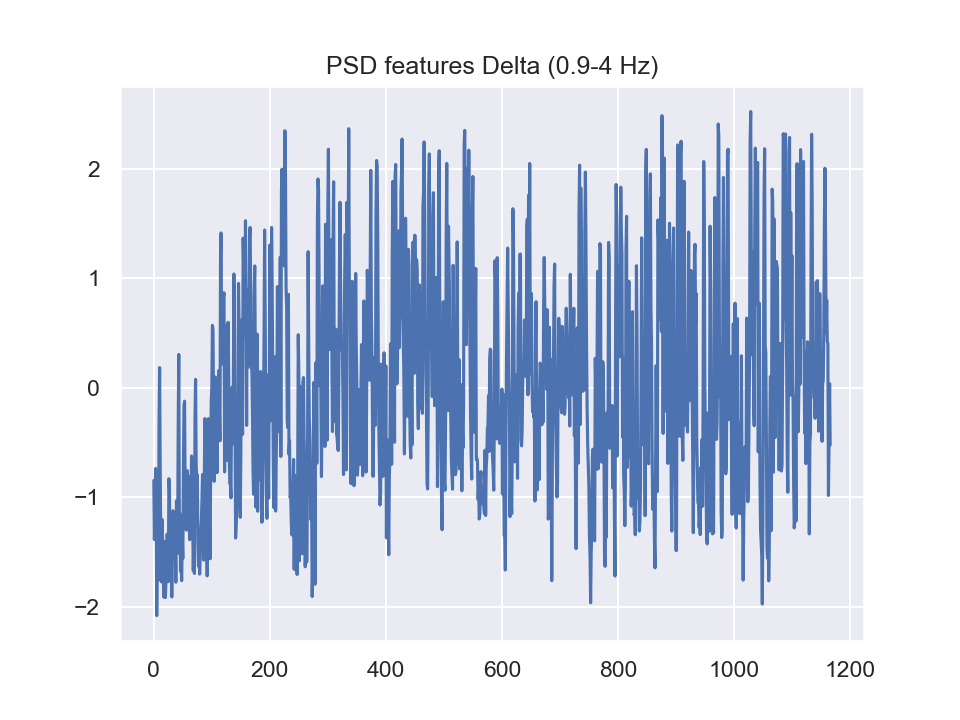

<IPython.core.display.Javascript object>


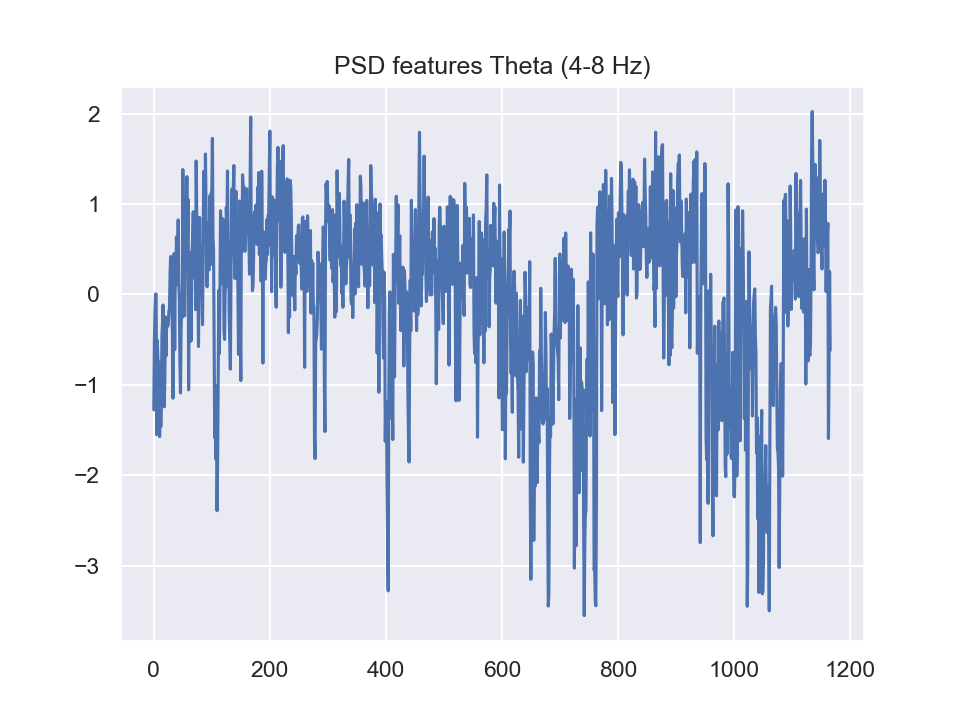

<IPython.core.display.Javascript object>


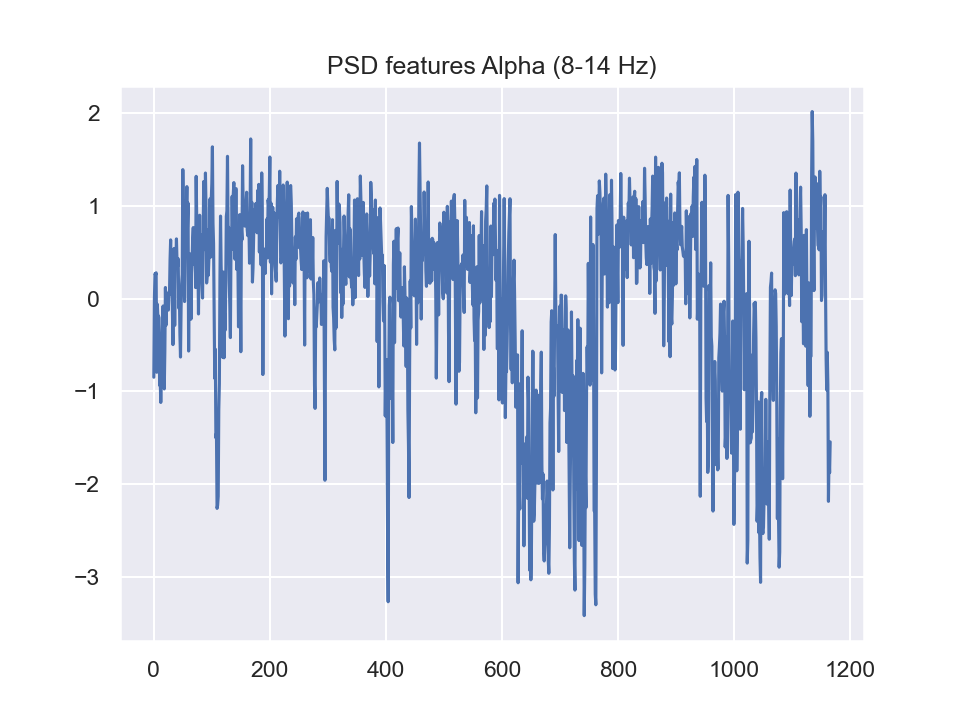

<IPython.core.display.Javascript object>


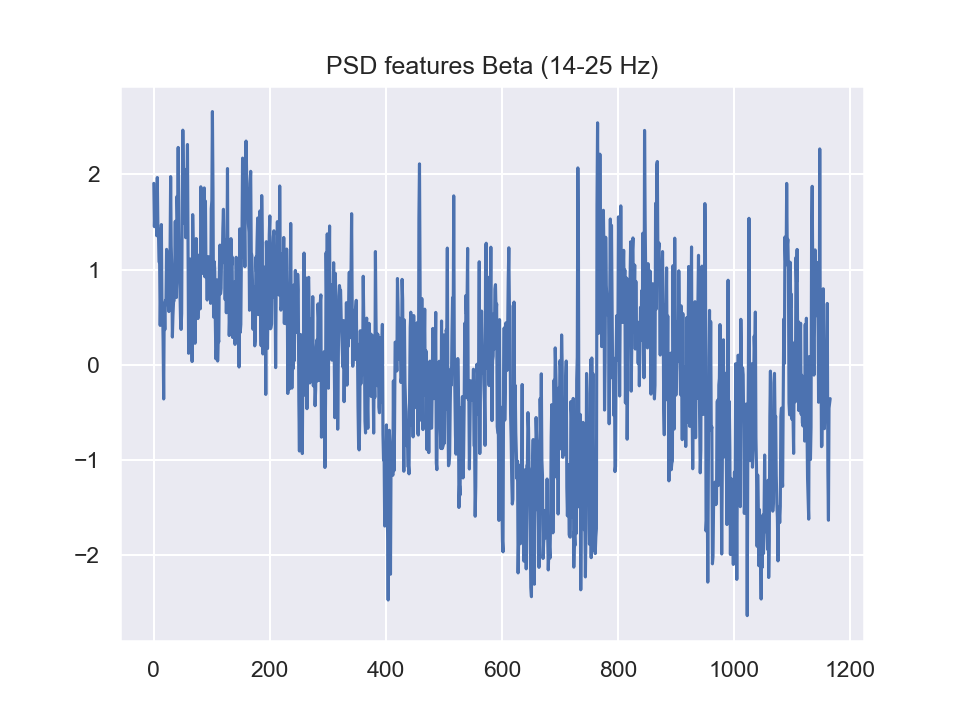

<IPython.core.display.Javascript object>


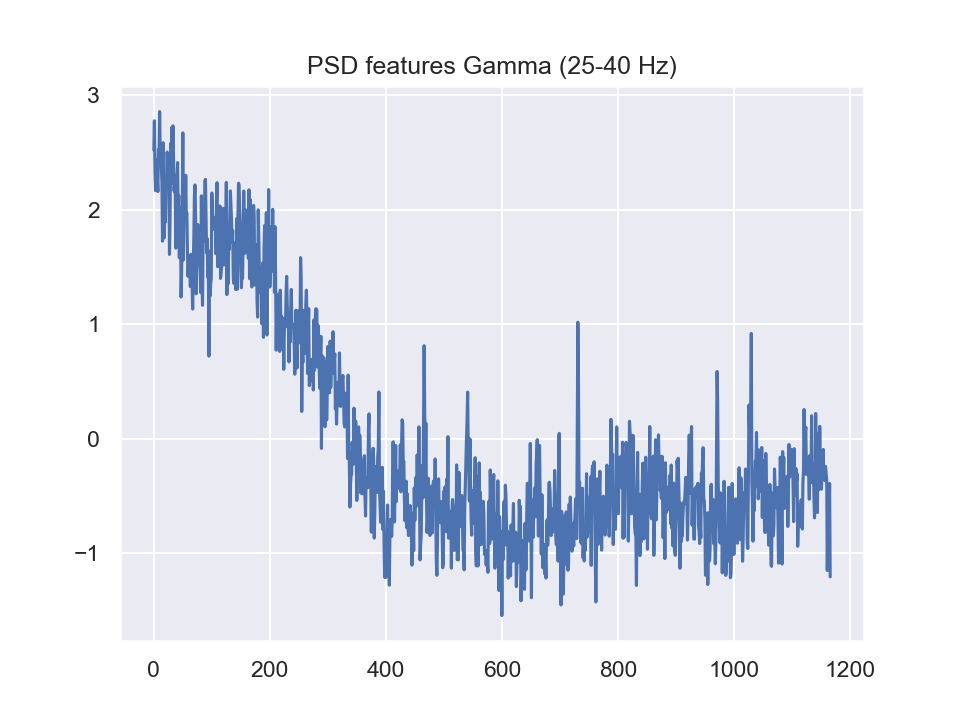

In [70]:
for i in range(n_freq):
    fig, ax = plt.subplots() 
    ax.plot(ft_rr_psd_all_db_sc[:,i], label='original')
    #ax.plot(singular_values_filt[:10], label='filtered')
    ax.set_title("PSD features "+ bands[i][2]) 
    #ax.legend()


# Plotting clustering methods

22


,Method,Silh,Cal-Har,Dav-Bold
0,w_adj_ft5,0.10,121.24,3.14


<IPython.core.display.Javascript object>


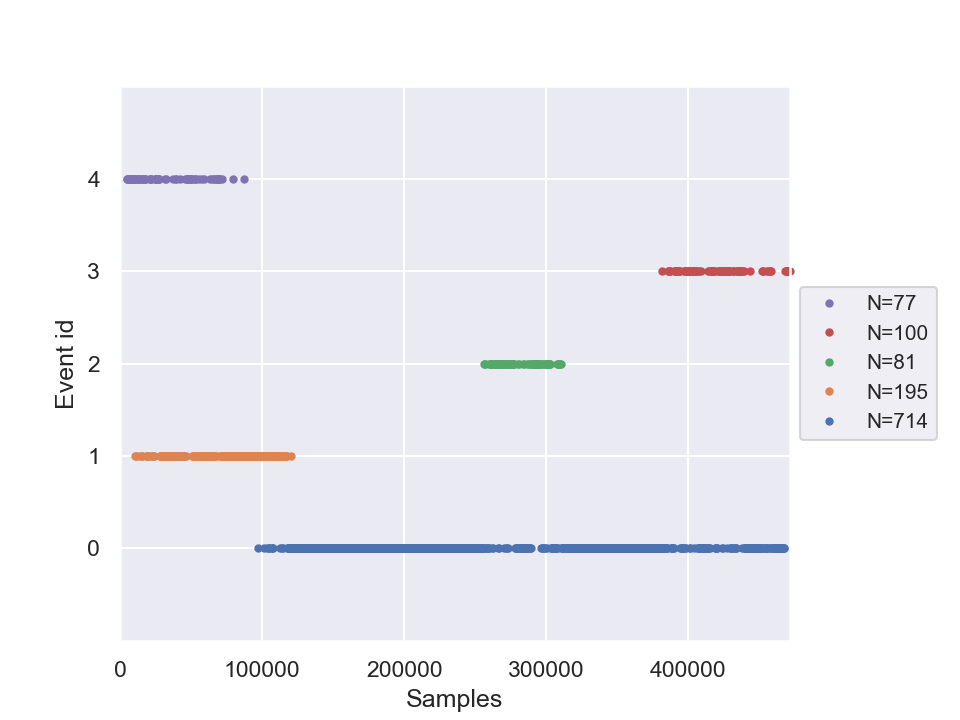

In [541]:
# Метод клатеризации Варда с учётом матрицы связности
K_NEIGHBORS = 25
N_CLUSTERS = 5
df_best_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])
df_features = df_ft_total_alg2_avg
print(len(df_features.columns))

cl_method, df_best_metrics = apply_cluster_method(data=df_features, cl_method=AgglomerativeClustering, 
                                                      name='w_adj_ft'+str(N_CLUSTERS), df_metrics=df_best_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
display(df_best_metrics)

cluster_events = epochs_fix_1s_rr.events
cluster_events[:,2] = cl_method.labels_
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)
#df_psd_rr_ft_alg_avg

In [545]:
# Calculationg start and end points of each cluster
cluster_labels = cl_method.labels_
n_clusters = len(np.unique(cluster_labels))

samples_in_cluster = []

for i in range(n_clusters):
    cl_samples = np.asarray(np.where(cluster_labels == i)).flatten()
    samples_in_cluster.append(cl_samples)
    print('Cluster '+str(i)+': ', samples_in_cluster[i][0], samples_in_cluster[i][-1])
#    print(samples_in_cluster[i])

Cluster 0:  231 1157
Cluster 1:  15 288
Cluster 2:  628 763
Cluster 3:  942 1166
Cluster 4:  0 207


<IPython.core.display.Javascript object>


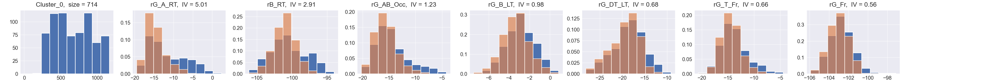

<IPython.core.display.Javascript object>


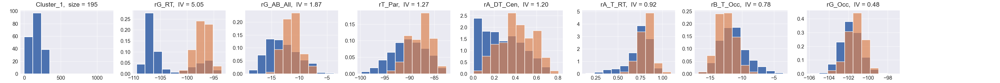

<IPython.core.display.Javascript object>


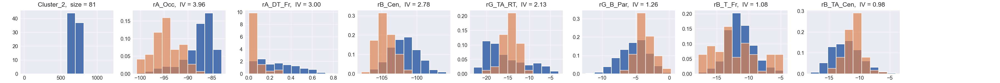

<IPython.core.display.Javascript object>


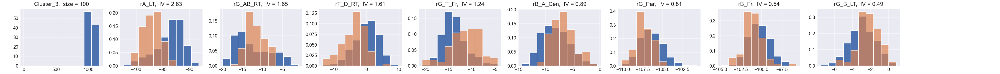

<ipython-input-115-c56e2c990fab>:7: RuntimeWarning: More than 100 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, n_features+1, figsize=(3*(n_features+1), 2))


<IPython.core.display.Javascript object>


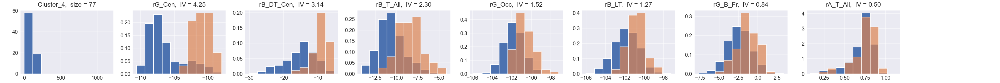

(<Figure size 2400x200 with 8 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_4,  size = 77'}>,
        <AxesSubplot:title={'center':'rG_Cen,  IV = 4.25'}>,
        <AxesSubplot:title={'center':'rB_DT_Cen,  IV = 3.14'}>,
        <AxesSubplot:title={'center':'rB_T_All,  IV = 2.30'}>,
        <AxesSubplot:title={'center':'rG_Occ,  IV = 1.52'}>,
        <AxesSubplot:title={'center':'rB_LT,  IV = 1.27'}>,
        <AxesSubplot:title={'center':'rG_B_Fr,  IV = 0.84'}>,
        <AxesSubplot:title={'center':'rA_T_All,  IV = 0.50'}>],
       dtype=object))

In [544]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10
df_features = df_ft_tot_loc_ind

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_fix_1s_ovl_ft, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)
#for i in range(len(best_IV_list)):
    #display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_features, cluster_labels, best_IV_list)    
        

[(0, 207, 'Stage_0'), (208, 288, 'Stage_1'), (289, 627, 'Stage_2'), (628, 763, 'Stage_3'), (764, 941, 'Stage_4'), (942, 1166, 'Stage_5')]


<IPython.core.display.Javascript object>


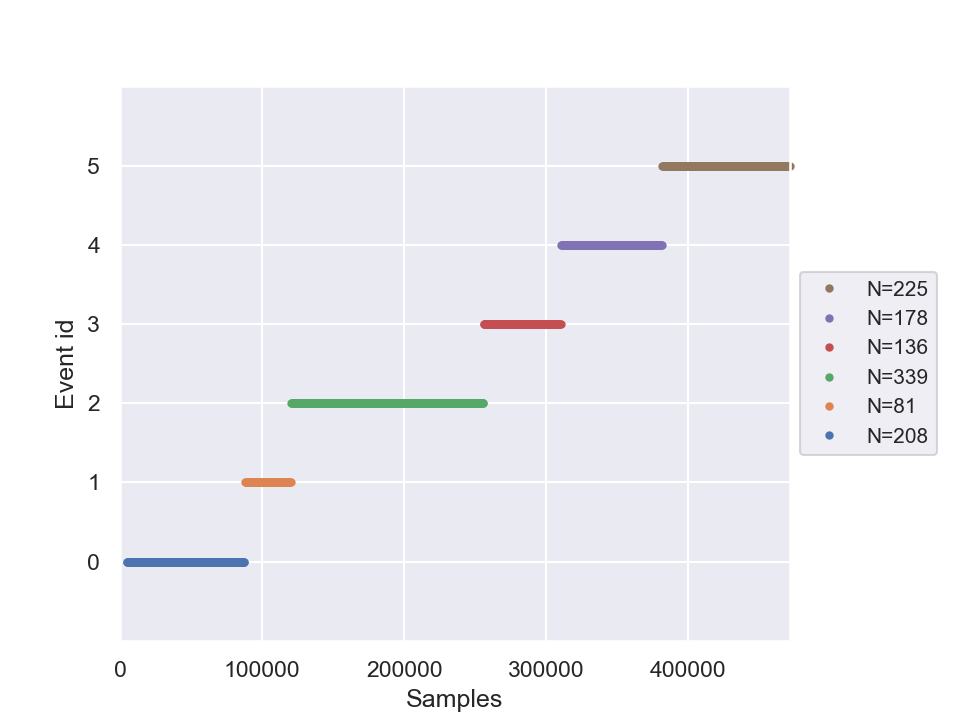

In [548]:
# Формируем икусственные кластеры по результатам кластеризации

clust_bands = []
n_clusters = len(np.unique(cluster_labels))
new_labels = np.zeros(len(cluster_labels)) 

for i in range(len(new_labels)):
    if i <= samples_in_cluster[4][-1]:
        new_labels[i] = 0
    if (samples_in_cluster[4][-1] < i <= samples_in_cluster[1][-1]):
        new_labels[i] = 1
    if (samples_in_cluster[1][-1] < i < samples_in_cluster[2][0]):
        new_labels[i] = 2
    if (samples_in_cluster[2][0] <= i <= samples_in_cluster[2][-1]):
        new_labels[i] = 3
    if (samples_in_cluster[2][-1] < i < samples_in_cluster[3][0]):
        new_labels[i] = 4
    if i >= samples_in_cluster[3][0]:
        new_labels[i] = 5

n_clusters_new = len(np.unique(new_labels))
for i in range(n_clusters_new):
    cl_samples = np.where(new_labels == i)[0]
    clust_bands.append((cl_samples[0], cl_samples[-1], 'Stage_'+str(i)))
print(clust_bands)    
        
# Plotting tied to time artificial clusters
cluster_events[:,2] = new_labels
fig = mne.viz.plot_events(cluster_events)            

<IPython.core.display.Javascript object>


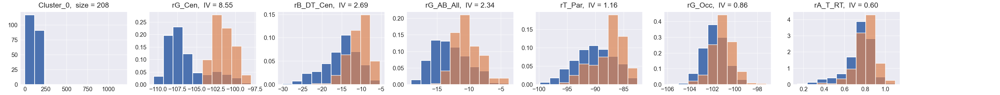

<IPython.core.display.Javascript object>


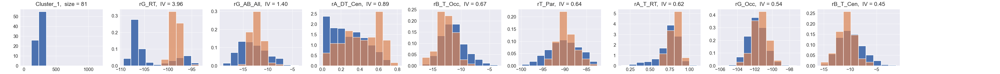

<IPython.core.display.Javascript object>


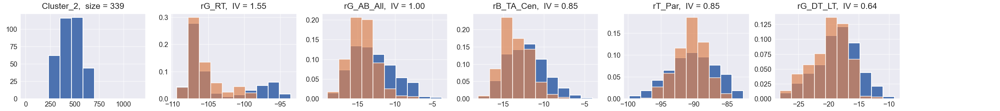

<IPython.core.display.Javascript object>


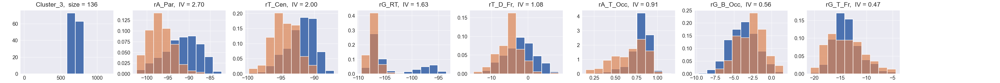

<IPython.core.display.Javascript object>


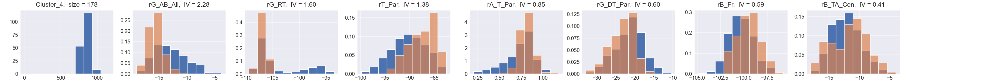

<IPython.core.display.Javascript object>


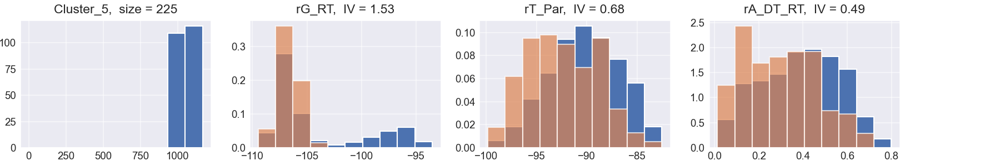

(<Figure size 1200x200 with 4 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 225'}>,
        <AxesSubplot:title={'center':'rG_RT,  IV = 1.53'}>,
        <AxesSubplot:title={'center':'rT_Par,  IV = 0.68'}>,
        <AxesSubplot:title={'center':'rA_DT_RT,  IV = 0.49'}>],
       dtype=object))

In [549]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10
df_features = df_ft_tot_loc_ind

cluster_labels = new_labels
n_clusters = len(np.unique(cluster_labels))

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_fix_1s_ovl_ft, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)
#for i in range(len(best_IV_list)):
    #display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_features, cluster_labels, best_IV_list)    
        

Index(['rD_All', 'rT_All', 'rA_All', 'rB_All', 'rG_All'], dtype='object')
rD_All   -0.55
rT_All    0.26
rA_All    0.36
rB_All    1.02
rG_All    1.80
Name: mean, dtype: float64


<IPython.core.display.Javascript object>


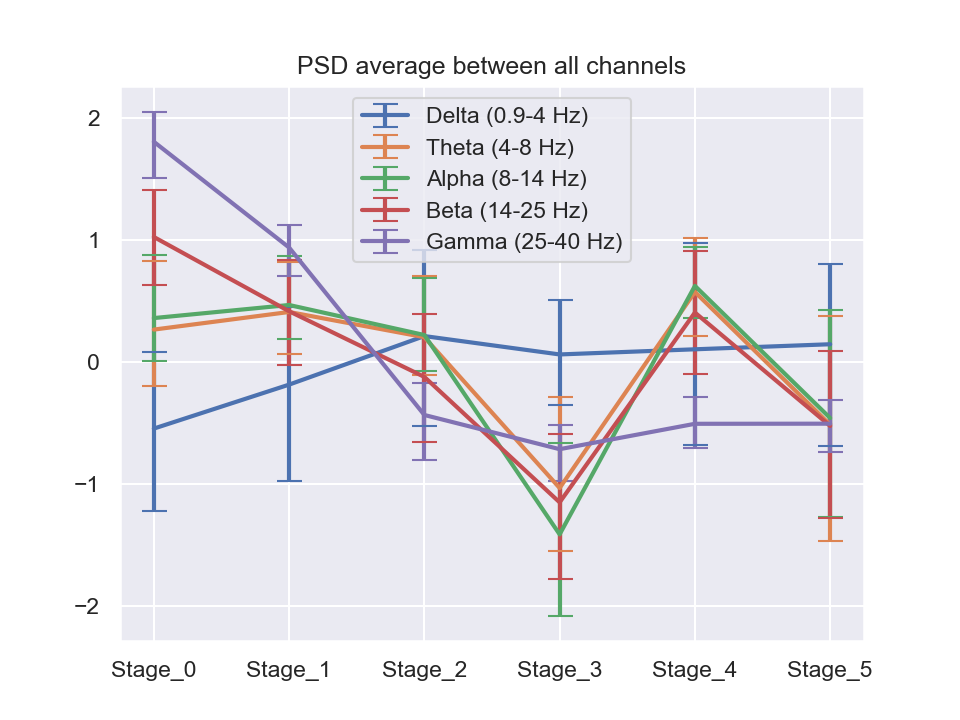

[[0.67845601 0.78573152 0.73382984 0.41030456 0.78770596 0.83386039]
 [0.62742147 0.63812302 0.7088498  0.44606172 0.87136292 0.65738642]]
[[0.45830247 0.34723426 0.31086098 0.51265461 0.36205432 0.95435509]
 [0.56480295 0.40861147 0.50052985 0.74586582 0.43898435 0.88993078]]
[[0.35482148 0.27703846 0.29091895 0.66540955 0.26069112 0.80899893]
 [0.51354915 0.40302696 0.46630959 0.74843889 0.31973793 0.88613698]]
[[0.39603477 0.43967991 0.53412766 0.62722963 0.50753919 0.75372742]
 [0.3865658  0.4232941  0.51451641 0.55791363 0.50402209 0.61272945]]
[[0.29691944 0.23483841 0.3719393  0.25938498 0.19958283 0.2343269 ]
 [0.24696635 0.18812117 0.26278342 0.19558059 0.21979805 0.19771526]]


In [560]:
# Feature PSD statistics by cluster (all channels)
n_clusters = len(clust_bands)

df_features = df_ft_rr_psd_all_db_sc
#df_features = df_ft_psd_all_db_sc
print(df_features.columns)

df_ft_clust = [df_features.iloc[smin:(smax+1), :] for (smin, smax, _) in clust_bands]
df_ft_clust_stats = [df_ft_clust[i].describe() for i in range(n_clusters)]

fig, ax = plt.subplots()
x = [cl for (_, _, cl) in clust_bands]
for _freq in range(n_freq):
    y = [df_ft_clust_stats[i].loc['mean'][_freq] for i in range(n_clusters)]
    yerr = np.array([df_ft_clust_stats[i].loc[['25%','75%']].to_numpy() for i in range(n_clusters)])[:,:,_freq].transpose(1,0)
    yerr[0,:] = y - yerr[0,:]
    yerr[1,:] = yerr[1,:] - y
    print(yerr)
    ax.errorbar(x, y, yerr, label=bands[_freq][2], capsize=6, linewidth=2)
ax.set_title("PSD average between all channels") 
ax.legend()


Index(['rD_Fr', 'rD_LT', 'rD_RT', 'rD_Cen', 'rD_Par', 'rD_Occ', 'rT_Fr',
       'rT_LT', 'rT_RT', 'rT_Cen', 'rT_Par', 'rT_Occ', 'rA_Fr', 'rA_LT',
       'rA_RT', 'rA_Cen', 'rA_Par', 'rA_Occ', 'rB_Fr', 'rB_LT', 'rB_RT',
       'rB_Cen', 'rB_Par', 'rB_Occ', 'rG_Fr', 'rG_LT', 'rG_RT', 'rG_Cen',
       'rG_Par', 'rG_Occ'],
      dtype='object')


<IPython.core.display.Javascript object>


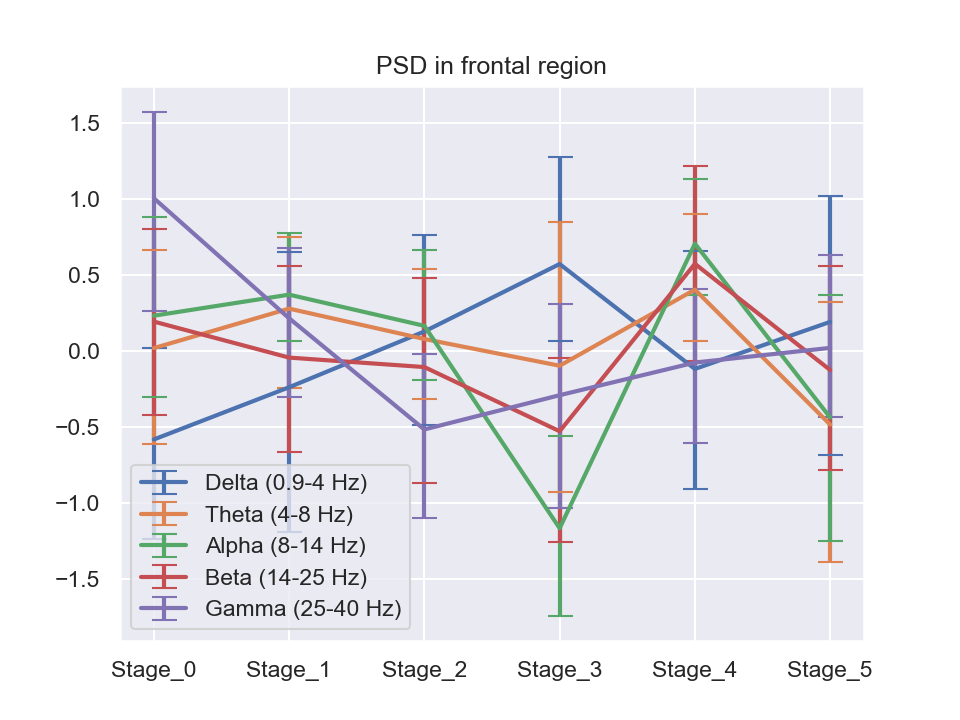

[[0.65551152 0.95207501 0.61609066 0.50376815 0.79015665 0.87812848]
 [0.60425232 0.89130658 0.63492659 0.70308637 0.77405211 0.82647249]]
[[0.63309906 0.52455246 0.39735348 0.83064613 0.33542677 0.90501011]
 [0.64525193 0.47038078 0.46069911 0.94745412 0.49801422 0.80674441]]
[[0.53657999 0.30405435 0.35587478 0.57472317 0.33572976 0.81171819]
 [0.64667982 0.40782953 0.50030702 0.60657451 0.42732844 0.80769311]]
[[0.61601302 0.61903717 0.76305486 0.73015056 0.64027347 0.65746693]
 [0.61008551 0.60335477 0.5884471  0.48007846 0.64540872 0.68146781]]
[[0.74178116 0.51746671 0.58467313 0.74497119 0.53194587 0.45579302]
 [0.56985397 0.46020836 0.49596919 0.60165987 0.48364524 0.61387799]]


<IPython.core.display.Javascript object>


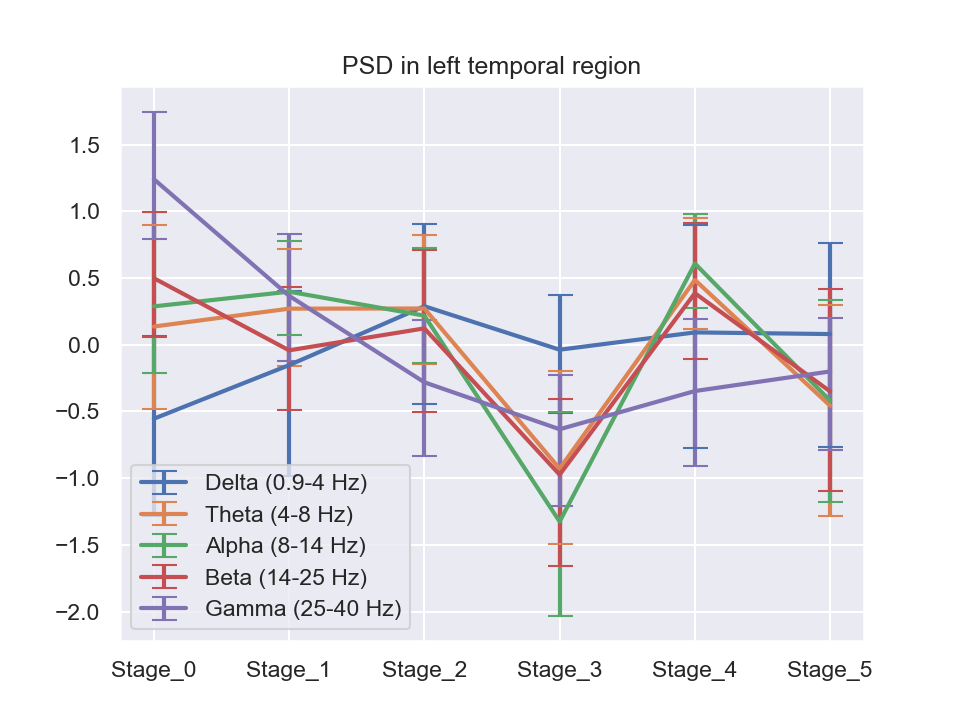

[[0.72813685 0.8295757  0.72962433 0.47608674 0.86494887 0.84662523]
 [0.62388253 0.55732795 0.61849144 0.41215481 0.80783975 0.68267031]]
[[0.61615684 0.42973376 0.41455611 0.56509938 0.36683371 0.82594752]
 [0.75853324 0.44592591 0.54900787 0.72944409 0.46611936 0.7558163 ]]
[[0.50029914 0.32470388 0.35463418 0.70492931 0.32988651 0.76024665]
 [0.70730689 0.3824588  0.50509649 0.81940169 0.37017764 0.75648239]]
[[0.44220585 0.44767424 0.62713271 0.68486391 0.49193894 0.74538483]
 [0.49646236 0.47171911 0.58485587 0.56574181 0.5230214  0.76939596]]
[[0.44862833 0.48546618 0.55622028 0.57876604 0.55970804 0.5921489 ]
 [0.50629383 0.46693131 0.46798949 0.40718476 0.5393136  0.39745258]]


<IPython.core.display.Javascript object>


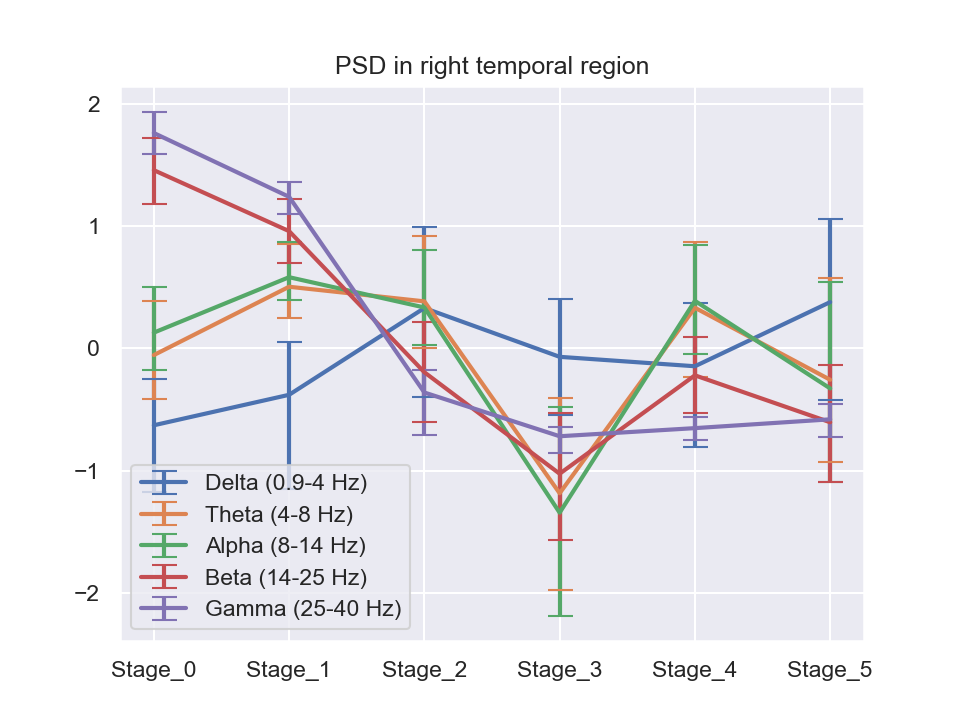

[[0.544183   0.77469057 0.7308237  0.47672182 0.66423779 0.80296476]
 [0.38108779 0.42987049 0.6628516  0.47082692 0.51578278 0.6803763 ]]
[[0.36041173 0.25860338 0.38534535 0.78802884 0.56358557 0.67528894]
 [0.44606559 0.35317959 0.53242129 0.77707316 0.54149067 0.83685695]]
[[0.3055602  0.18739484 0.30977089 0.84256791 0.4332129  0.76234029]
 [0.37206522 0.28677414 0.4718161  0.86302257 0.45661434 0.87009649]]
[[0.27930347 0.26006965 0.40655541 0.54079076 0.31237975 0.48625425]
 [0.26638296 0.26693385 0.41016958 0.49995558 0.31255036 0.46580141]]
[[0.17080475 0.14277931 0.34748687 0.13456759 0.09608579 0.14291659]
 [0.17521717 0.12093474 0.18233158 0.07728953 0.09202979 0.12843294]]


<IPython.core.display.Javascript object>


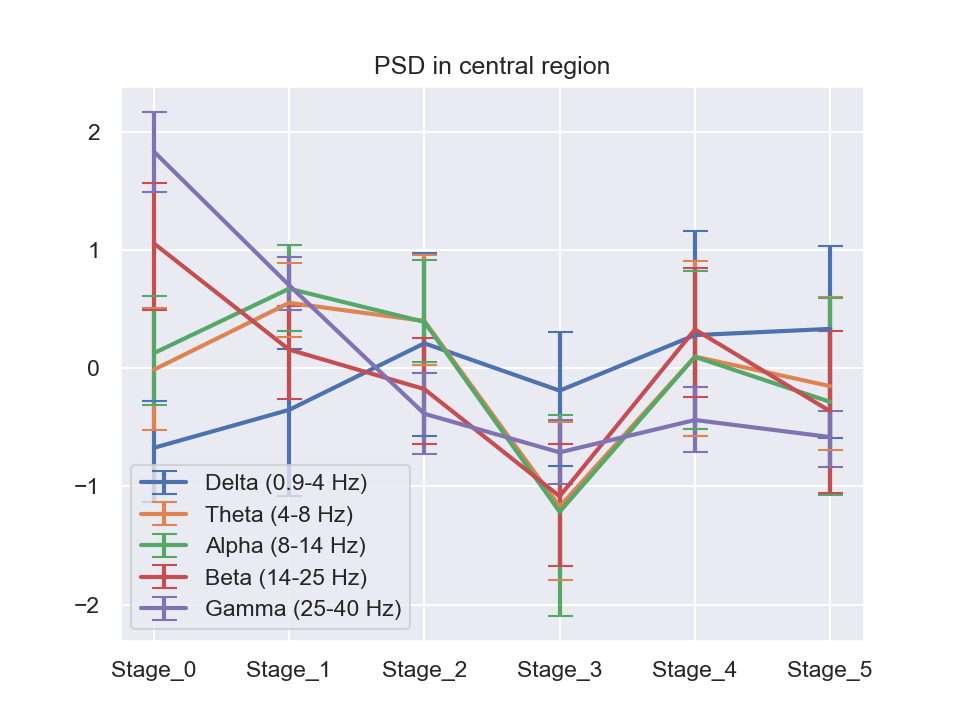

[[0.45655795 0.72487795 0.78681818 0.64041811 0.8501855  0.92536425]
 [0.39617751 0.51824525 0.76401113 0.49695677 0.87672485 0.69726008]]
[[0.5066349  0.28660573 0.37555334 0.61749177 0.6695203  0.54289522]
 [0.52150609 0.33932912 0.56023725 0.71868609 0.80457425 0.75407045]]
[[0.43634984 0.3614599  0.3425041  0.87854076 0.60966595 0.78730734]
 [0.48705153 0.36942811 0.52168313 0.82213086 0.73004719 0.88111218]]
[[0.56716064 0.4222437  0.46299133 0.58600299 0.57330918 0.68912534]
 [0.50910717 0.36448107 0.42959757 0.44502623 0.51882997 0.68160988]]
[[0.33987269 0.206536   0.33876943 0.27113095 0.27353539 0.25188995]
 [0.33755318 0.23464705 0.34432197 0.27087736 0.27542447 0.22307131]]


<IPython.core.display.Javascript object>


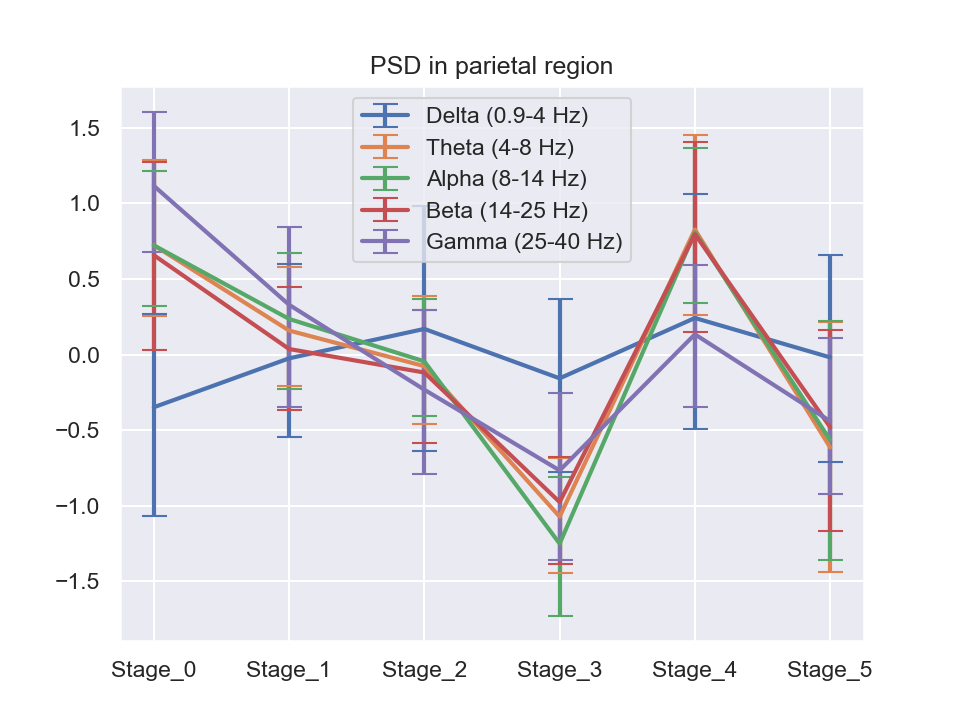

[[0.7216062  0.52023639 0.80601424 0.61910047 0.73263419 0.69327747]
 [0.6167421  0.62766045 0.81617684 0.52692796 0.82431621 0.68092322]]
[[0.46999756 0.36620806 0.3827039  0.371169   0.5652242  0.82316839]
 [0.56393023 0.42195596 0.46614079 0.39080624 0.62508684 0.82823104]]
[[0.40177403 0.46659052 0.36330447 0.47634139 0.46948098 0.79106609]
 [0.49220577 0.43659005 0.41607337 0.44435588 0.55839206 0.79168746]]
[[0.62776936 0.40489026 0.46910695 0.40734413 0.65034467 0.68934324]
 [0.61521364 0.40839297 0.4140761  0.29759404 0.60821095 0.64575526]]
[[0.43526649 0.67437946 0.56007015 0.59351581 0.48388191 0.48420379]
 [0.49163159 0.51345115 0.52468802 0.51513715 0.45620571 0.55132818]]


<IPython.core.display.Javascript object>


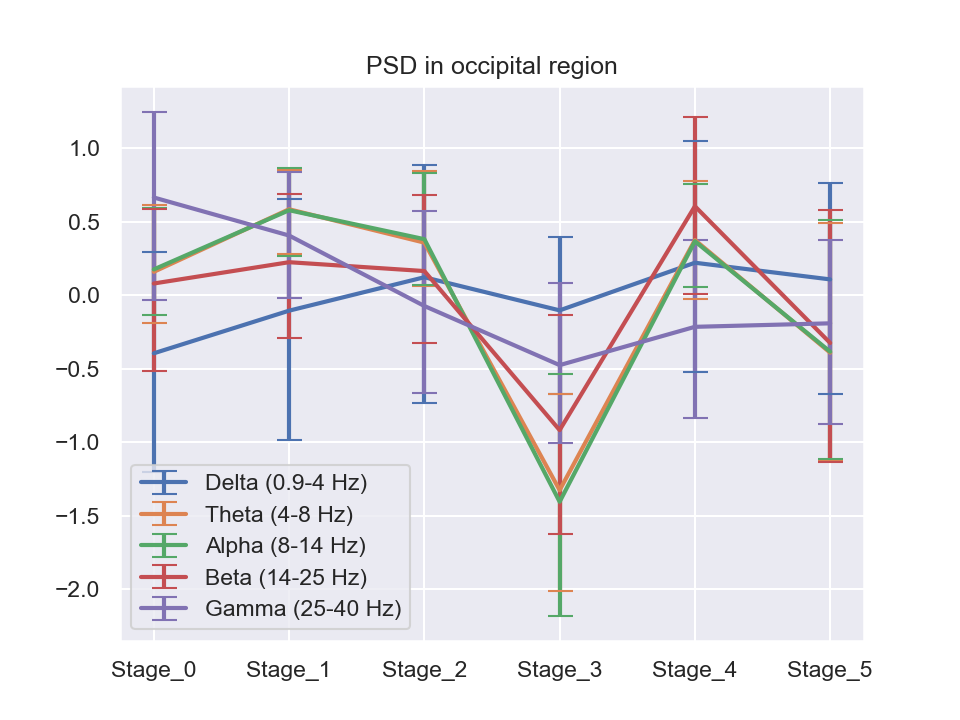

[[0.80938373 0.88023269 0.85585119 0.5685141  0.74618148 0.77655573]
 [0.69168506 0.76066178 0.76134529 0.49956802 0.82850254 0.65606977]]
[[0.35036525 0.30732885 0.29196416 0.68345561 0.40050785 0.73741054]
 [0.45502951 0.26854011 0.48801726 0.65178506 0.39797258 0.88365317]]
[[0.31087364 0.31290121 0.3091238  0.77439271 0.31380993 0.73277838]
 [0.42010288 0.28885765 0.44682244 0.86918866 0.39205607 0.89291303]]
[[0.59575037 0.51439909 0.49064808 0.70901624 0.59869308 0.81260013]
 [0.50392966 0.4613329  0.51711274 0.78000897 0.6065393  0.90581124]]
[[0.69656898 0.42362341 0.59509085 0.52918461 0.62101051 0.6870215 ]
 [0.58439684 0.42950714 0.64571398 0.55701087 0.58835566 0.56591363]]


In [526]:
# Feature PSD statistics by cluster (by region)

df_features = df_ft_rr_psd_loc_db_sc
print(df_features.columns)

df_ft_clust = [df_features.iloc[smin:(smax+1), :] for (smin, smax, _) in clust_bands]
df_ft_clust_stats = [df_ft_clust[i].describe() for i in range(n_clusters)]
x = [cl for (_, _, cl) in clust_bands]

for (_, reg_label, reg_name) in regions:
    fig, ax = plt.subplots()
    reg_columns = [col for col in df_features.columns if (reg_label in col)]
    df_ft_cl_stats_reg = [df_ft_clust_stats[i][reg_columns] for i in range(n_clusters)]
    for _freq in range(n_freq):
        y = [df_ft_cl_stats_reg[i].loc['mean'][_freq] for i in range(n_clusters)]
        yerr = np.array([df_ft_cl_stats_reg[i].loc[['25%','75%']].to_numpy() for i in range(n_clusters)])[:,:,_freq].transpose(1,0)
        yerr[0,:] = y - yerr[0,:]
        yerr[1,:] = yerr[1,:] - y
        print(yerr)
        ax.errorbar(x, y, yerr, label=bands[_freq][2], capsize=6, linewidth=2)
    ax.set_title('PSD in ' + reg_name + ' region') 
    ax.legend()

<IPython.core.display.Javascript object>


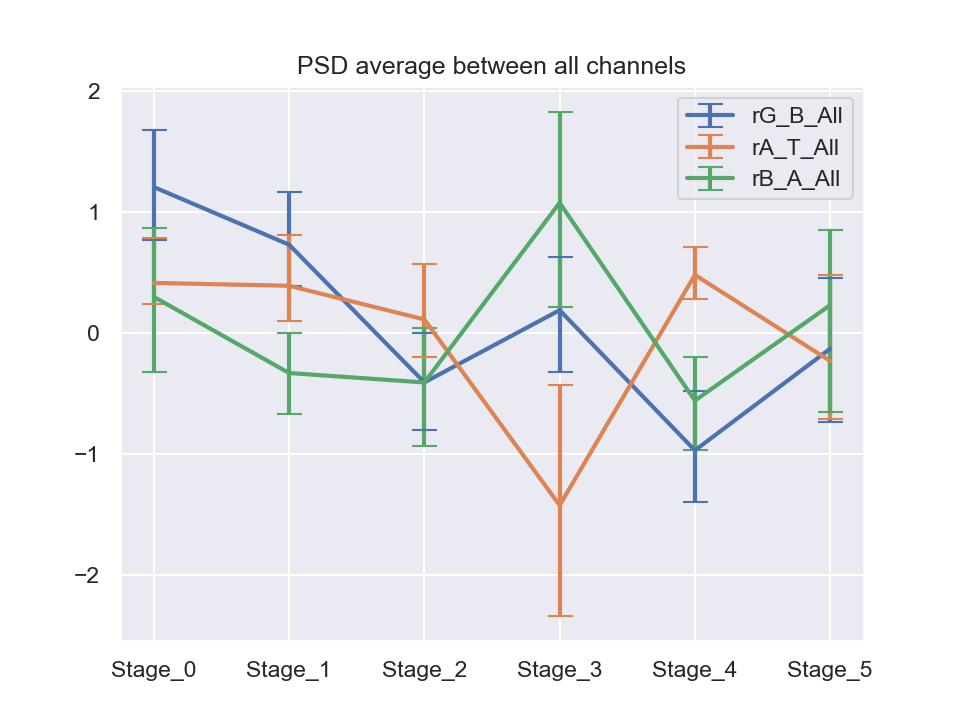

[[0.4354408  0.33860793 0.39702592 0.51248153 0.42717052 0.60677014]
 [0.47487324 0.4313215  0.41228428 0.44256207 0.48938047 0.5800161 ]]
[[0.17755604 0.28905717 0.31316098 0.91165807 0.20226693 0.47726951]
 [0.37028132 0.4202932  0.45991679 0.99776271 0.23474113 0.70854427]]
[[0.62404053 0.33818313 0.5289116  0.86204168 0.41174018 0.88157079]
 [0.56637744 0.33228319 0.44862909 0.75404159 0.36081187 0.62332498]]


In [568]:
# PSD indices by cluster (all channels)
n_clusters = len(clust_bands)
ind_columns = ['rG_B_All', 'rA_T_All', 'rB_A_All']

df_features = df_ft_rr_psd_ind_log_sc[ind_columns]
#print(df_features.columns)

df_ft_clust = [df_features.iloc[smin:(smax+1), :] for (smin, smax, _) in clust_bands]
df_ft_clust_stats = [df_ft_clust[i].describe() for i in range(n_clusters)]

fig, ax = plt.subplots()
x = [cl for (_, _, cl) in clust_bands]
for _ind in range(len(ind_columns)):
    y = [df_ft_clust_stats[i].loc['mean'][_ind] for i in range(n_clusters)]
    yerr = np.array([df_ft_clust_stats[i].loc[['25%','75%']].to_numpy() for i in range(n_clusters)])[:,:,_ind].transpose(1,0)
    yerr[0,:] = y - yerr[0,:]
    yerr[1,:] = yerr[1,:] - y
    print(yerr)
    ax.errorbar(x, y, yerr, label=ind_columns[_ind], capsize=6, linewidth=2)
ax.set_title("PSD average between all channels") 
ax.legend()


In [236]:
IV_list, WoE_list = IV_WoE_vars_clust(df_ft_rr_psd_ind, cluster_labels, n_bins=10)
for i in range(n_clusters):
    print('Cluster_' + str(i))
    df_IV_sorted = IV_list[i].sort_values('IV', ascending = False)
    display(df_IV_sorted[df_IV_sorted['IV']>=0.5])


Cluster_0


,Variable,IV
12,rG_B,3.15
13,rG_DT,2.89
10,rG_T,2.83
14,rG_TA,2.45
9,rG_D,2.26
15,rG_AB,2.16
11,rG_A,2.08
7,rB_DT,1.23
4,rB_D,1.10
1,rA_D,0.70


Cluster_1


,Variable,IV
10,rG_T,1.34
14,rG_TA,1.22
12,rG_B,1.15
15,rG_AB,1.11
11,rG_A,1.06
13,rG_DT,0.97
9,rG_D,0.61


Cluster_2


,Variable,IV
15,rG_AB,1.19
12,rG_B,1.16
11,rG_A,1.15
14,rG_TA,1.12
13,rG_DT,1.02
10,rG_T,1.02
9,rG_D,0.89
6,rB_A,0.55


Cluster_3


,Variable,IV
2,rA_T,1.81
6,rB_A,1.00
3,rA_DT,0.69
1,rA_D,0.59
0,rT_D,0.59
9,rG_D,0.54
11,rG_A,0.53


Cluster_4


,Variable,IV
15,rG_AB,2.28
11,rG_A,2.23
14,rG_TA,2.06
12,rG_B,1.98
10,rG_T,1.84
2,rA_T,0.86
13,rG_DT,0.86
6,rB_A,0.84
9,rG_D,0.56
8,rB_TA,0.56


Cluster_5


,Variable,IV


In [235]:
IV_list, WoE_list = IV_WoE_vars_clust(df_ft_rr_psd_ind, cluster_labels, n_bins=10)
print('Cluster_' + str(0))
df_IV_sorted = IV_list[0].sort_values('IV', ascending = False, ignore_index=True)
display(df_IV_sorted[df_IV_sorted['IV']>=0.5])

IV_list, WoE_list = IV_WoE_vars_clust(df_ft_rr_ampl_stats, cluster_labels, n_bins=10)
print('Cluster_' + str(0))
df_IV_sorted = IV_list[0].sort_values('IV', ascending = False, ignore_index=True)
display(df_IV_sorted[df_IV_sorted['IV']>=0.5])


Cluster_0


,Variable,IV
0,rG_B,3.15
1,rG_DT,2.89
2,rG_T,2.83
3,rG_TA,2.45
4,rG_D,2.26
5,rG_AB,2.16
6,rG_A,2.08
7,rB_DT,1.23
8,rB_D,1.10
9,rA_D,0.70


Cluster_0


,Variable,IV
0,rG_std_C4,8.50
1,rG_std_F4,8.32
2,rG_std_F8,8.22
3,rG_std_T4,8.22
4,rB_std_F8,6.70
...,...,...
60,rF_mean_C3,0.57
61,rA_std_F4,0.56
62,rA_std_F7,0.53
63,rT_std_O2,0.51


##  plot_psd_topomap

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


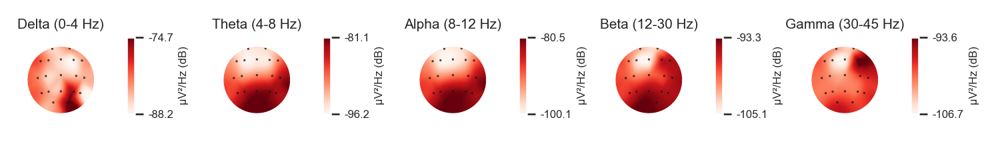

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


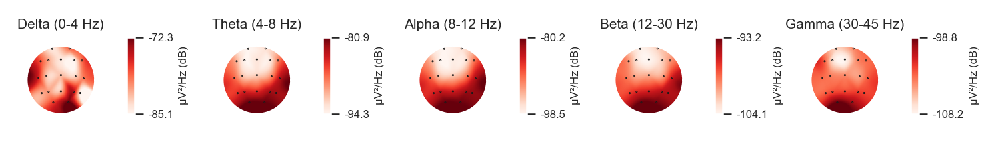

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


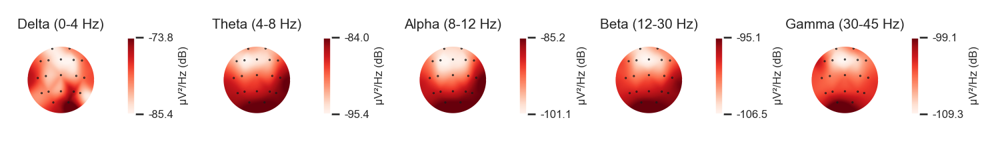

    Using multitaper spectrum estimation with 7 DPSS windows


<IPython.core.display.Javascript object>


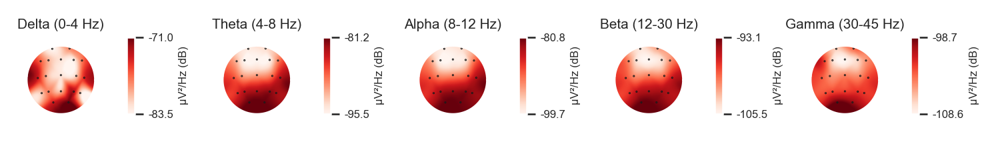

In [98]:
for i in range(n_clusters):
    epochs_cl = epochs_fix_1s_ovl[int(min_cl_sample[i]):int(max_cl_sample[i])+1]
    epochs_cl.plot_psd_topomap()

# Base State vs Change State

## Extract Base state distance features 

In [418]:
print(clust_bands)
df_features = df_ft_total_alg2_avg
#df_features = df_ft_psd_alg_avg

# Define 1st stage point cloud S
stage1_start = 0
stage1_end = 199

df_ft_stg1_alg_orig = df_features.copy().loc[stage1_start:stage1_end]
space_stg1_alg_orig = df_ft_stg1_alg_orig.to_numpy().transpose(1,0)
print(space_stg1_alg_orig.shape)
display(df_ft_stg1_alg_orig.std().sort_values(ascending=False)[:10])

[(0, 207, 'Cluster_0'), (208, 288, 'Cluster_1'), (289, 627, 'Cluster_2'), (628, 763, 'Cluster_3'), (764, 941, 'Cluster_4')]
(22, 200)


rB_T_LT_avg     1.15
rG_B_Par_avg    0.99
rG_Fr_avg       0.99
rG_Occ_avg      0.98
rB_T_Par_avg    0.93
rB_TA_Cen_avg   0.90
rB_T_Occ_avg    0.89
rG_B_Occ_avg    0.88
rG_B_LT_avg     0.86
rG_B_Cen_avg    0.80
dtype: float64

In [419]:
# Extreme percentiles (0.1%)
filt_df = df_ft_stg1_alg_orig
low = .01
high = .99

# Choose 50% features with max std
df_std = df_ft_stg1_alg_orig.std().sort_values(ascending=False)
high_std_cols = df_std.index[:len(df_std.index)//4].to_numpy()

quant_df = filt_df[high_std_cols].quantile([low, high])

filt_df_std = filt_df[high_std_cols].apply(lambda x: x[(x>quant_df.loc[low,x.name]) & (x < quant_df.loc[high,x.name])], axis=0)
#print(filt_df_std)

filt_df = filt_df.drop(columns=high_std_cols)
filt_df[high_std_cols] = filt_df_std.to_numpy()
filt_df.dropna(inplace=True)
#print(filt_df.describe())

df_ft_stg1_alg_filt = filt_df
space_stg1_alg_filt = df_ft_stg1_alg_filt.to_numpy().transpose(1,0)
print(space_stg1_alg_filt.shape)
display(df_ft_stg1_alg_filt.std().sort_values(ascending=False)[:10])


(22, 182)


rB_T_LT_avg     1.07
rG_B_Par_avg    0.97
rG_Fr_avg       0.90
rB_TA_Cen_avg   0.89
rG_Occ_avg      0.89
rG_B_Occ_avg    0.88
rG_B_LT_avg     0.86
rB_T_Par_avg    0.84
rB_T_Occ_avg    0.84
rG_B_Cen_avg    0.81
dtype: float64

In [420]:
# Scaling data to N(0,1)
n_features = len(space_stg1_alg_orig[:,0])
n_vectors_orig = len(space_stg1_alg_orig[0,:])
n_vectors_filt = len(space_stg1_alg_filt[0,:])

space_stg1_alg_orig_sc = StandardScaler().fit_transform(space_stg1_alg_orig)
space_stg1_alg_filt_sc = StandardScaler().fit_transform(space_stg1_alg_filt)

In [421]:
# Calculating PCA attributes
pca = decomposition.PCA(n_components=None, svd_solver='full')

# Original PCA attributes
subsp_stg1_alg_orig_sc = pca.fit_transform(space_stg1_alg_orig_sc)
expl_var_ratio_orig = pca.explained_variance_ratio_
singular_values_orig = pca.singular_values_
good_fit_measure_orig = np.zeros(n_features)
for i in range(n_features-1):
    good_fit_measure_orig[i] = ((singular_values_orig[i]**2 / max((singular_values_orig[(i+1):]**2).sum(), 1)) * 
                                ((n_features - i - 1) * (n_vectors_orig - i) / (n_features + n_vectors_orig - 2*i)))
# Filtered PCA attributes
subsp_stg1_alg_filt_sc = pca.fit_transform(space_stg1_alg_filt_sc)
expl_var_ratio_filt = pca.explained_variance_ratio_
singular_values_filt = pca.singular_values_
good_fit_measure_filt = np.zeros(n_features)
for i in range(n_features-1):
    good_fit_measure_filt[i] = ((singular_values_filt[i]**2 / max((singular_values_filt[(i+1):]**2).sum(), 1)) * 
                                ((n_features - i - 1) * (n_vectors_filt - i) / (n_features + n_vectors_filt - 2*i)))

print([round(x,2) for x in good_fit_measure_orig])
print([round(x,2) for x in good_fit_measure_filt])

[11.6, 5.36, 5.21, 3.83, 3.87, 3.91, 4.06, 3.54, 3.79, 3.62, 3.91, 3.82, 3.9, 3.92, 3.96, 4.14, 3.85, 5.68, 3.62, 4.7, 0.14, 0.0]
[11.94, 5.49, 4.93, 3.68, 3.92, 3.76, 3.95, 3.31, 3.92, 3.76, 3.88, 3.74, 3.79, 3.92, 4.15, 4.13, 3.51, 6.17, 3.87, 3.96, 0.13, 0.0]


<IPython.core.display.Javascript object>


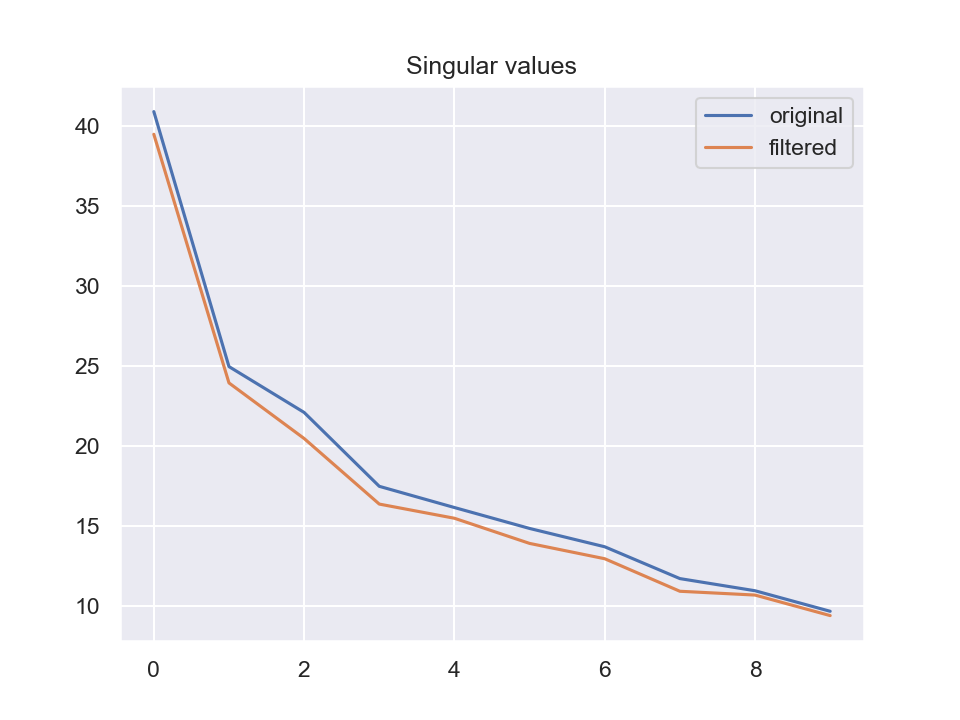

<IPython.core.display.Javascript object>


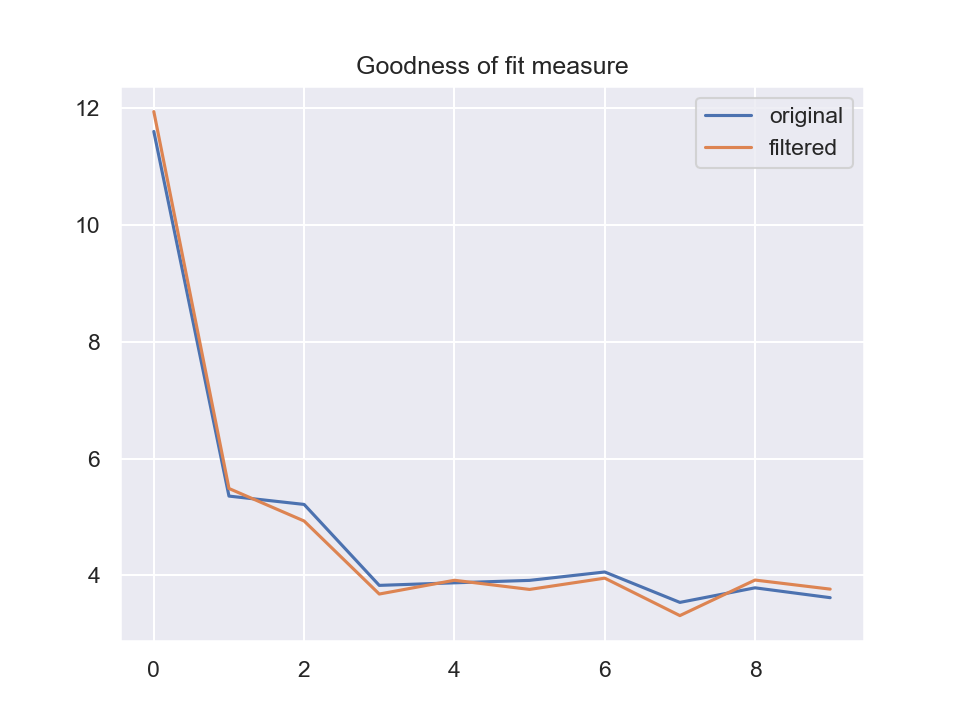

<IPython.core.display.Javascript object>


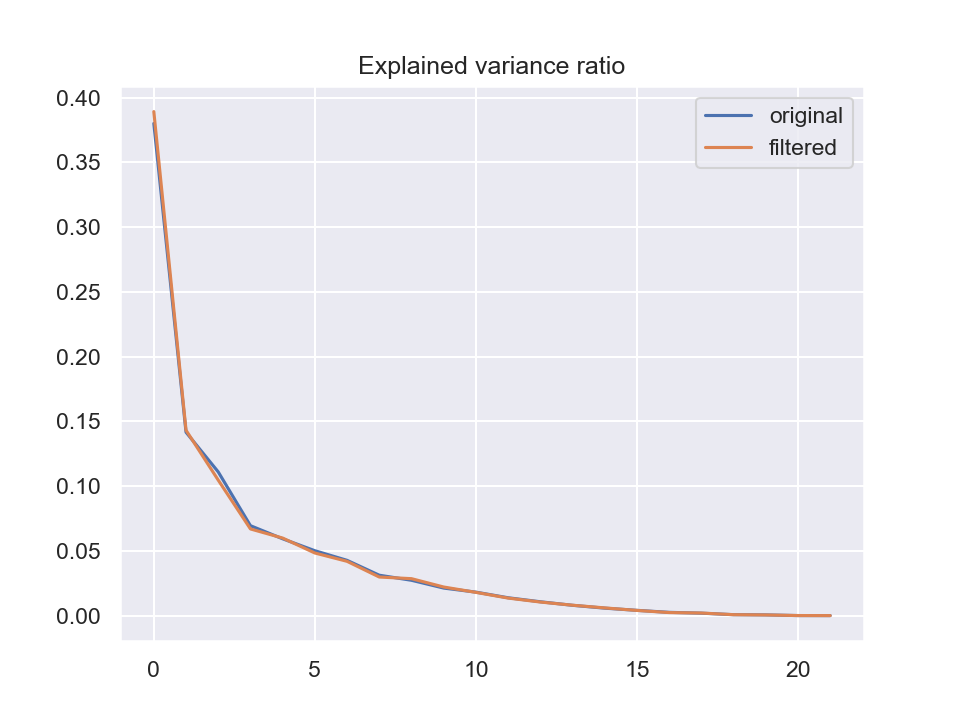

In [422]:
# Plotting PCA attributes

# Singular values
fig, ax = plt.subplots() 
ax.plot(singular_values_orig[:10], label='original')
ax.plot(singular_values_filt[:10], label='filtered')
#ax.plot(singular_values_flat, label='flatten')
#ax.plot(singular_values_filt_flat, label='filt_flat')
ax.set_title("Singular values") 
ax.legend()

# Goodness of fit measure
fig, ax = plt.subplots() 
ax.plot(good_fit_measure_orig[:10], label='original')
ax.plot(good_fit_measure_filt[:10], label='filtered')
#ax.plot(good_fit_measure_flat, label='flatten')
#ax.plot(good_fit_measure_filt_flat, label='filt_flat')
ax.set_title("Goodness of fit measure") 
ax.legend()

# Explained variance ratio
fig, ax = plt.subplots() 
ax.plot(expl_var_ratio_orig, label='original')
ax.plot(expl_var_ratio_filt, label='filtered')
#ax.plot(expl_var_ratio_flat, label='flatten')
#ax.plot(expl_var_ratio_filt_flat, label='filt_flat')
ax.set_title("Explained variance ratio") 
ax.legend()

# Change State vectors

## Algorithm best decision

In [426]:
#base_state_sc = subsp_stg1_alg_filt_sc[:,:2]
base_state_sc = subsp_stg1_alg_orig_sc[:,:2]
print(base_state_sc.shape)

space_alg_best = df_features.to_numpy().transpose(1,0)

space_alg_best_sc = StandardScaler().fit_transform(space_alg_best)
print(space_alg_best_sc.shape)

(22, 2)
(22, 1167)


In [427]:
n_vectors = len(space_alg_best_sc[0,:])
change_state_sc = np.zeros(space_alg_best_sc.shape)
dist_to_base_state = np.zeros(n_vectors)

for i in range(n_vectors):
    y_true = space_alg_best_sc[:,i]
    reg = LinearRegression().fit(base_state_sc, y_true)
    y_pred = reg.predict(base_state_sc)
    change_state_sc[:,i] = y_true - y_pred
    dist_to_base_state[i] = metrics.mean_squared_error(y_true, y_pred, squared = False)
print(dist_to_base_state)

[0.94278989 0.93123247 0.89682192 ... 0.93516189 0.98060775 0.85633896]


<IPython.core.display.Javascript object>


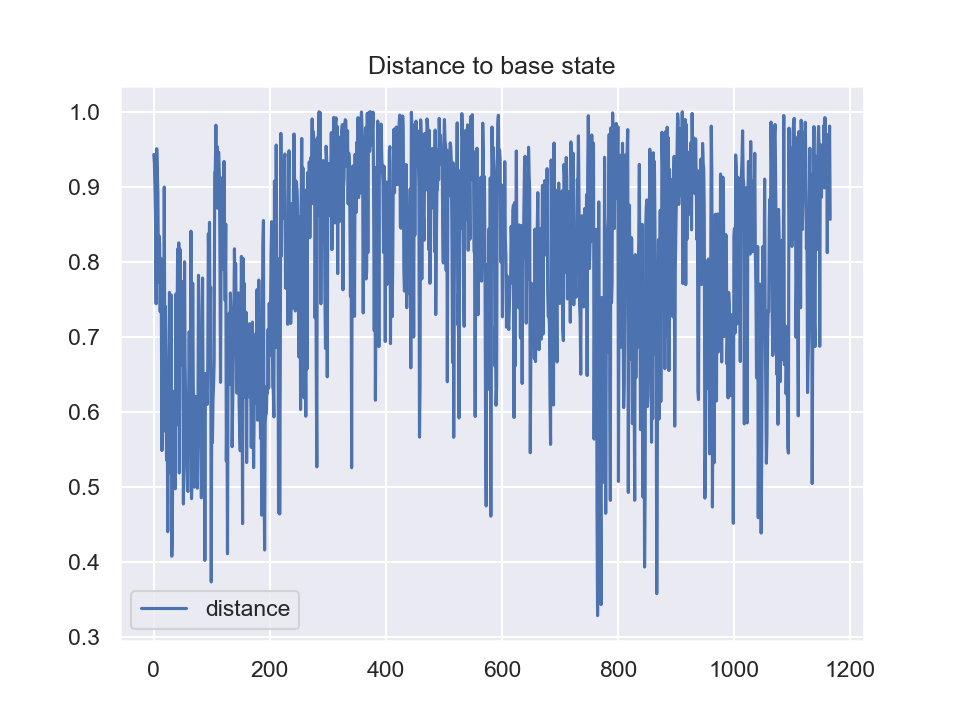

In [428]:
fig, ax = plt.subplots() 
ax.plot(dist_to_base_state, label='distance')
ax.set_title("Distance to base state") 
ax.legend()

## PCA best decision

In [79]:
base_state_sc = subsp_stg1_alg_filt_sc[:,:3]
#base_state_sc = subsp_stg1_alg_orig_sc[:,:3]
print(base_state_sc.shape)

space_alg_best = df_psd_ft_sc_pca_best.to_numpy().transpose(1,0)

space_alg_best_sc = StandardScaler().fit_transform(space_alg_best)
print(space_alg_best_sc.shape)

(44, 3)
(41, 1171)


In [80]:
n_vectors = len(space_alg_best_sc[0,:])
change_state_sc = np.zeros(space_alg_best_sc.shape)
dist_to_base_state = np.zeros(n_vectors)

for i in range(n_vectors):
    y_true = space_alg_best_sc[:,i]
    reg = LinearRegression().fit(base_state_sc, y_true)
    y_pred = reg.predict(base_state_sc)
    change_state_sc[:,i] = y_true - y_pred
    dist_to_base_state[i] = metrics.mean_squared_error(y_true, y_pred, squared = False)
print(dist_to_base_state)

ValueError: Found input variables with inconsistent numbers of samples: [44, 41]

In [ ]:
fig, ax = plt.subplots() 
ax.plot(dist_to_base_state, label='distance')
ax.set_title("Distance to base state") 
ax.legend()

# TDA features

## Persistent Homology

In [351]:
# Filtering raw_data
tda_bands = [(0.9, 4, 'Delta (0.9-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'), (8, 14, 'Alpha (8-14 Hz)'), (14, 20, 'Beta1 (14-20 Hz)'), 
             (20, 25, 'Beta2 (20-25 Hz)'), (25, 30, 'Gamma1 (25-30 Hz)'), (30, 35, 'Gamma2 (30-35 Hz)'), (35, 40, 'Gamma3 (35-40 Hz)')]

# Re-referenced data
#data_rr_filt = reref_data.copy().filter(l_freq=tda_bands[0][0], h_freq=tda_bands[4][1])
data_rr_filt_tda_sp = []
for i in range(len(tda_bands)):
    data_rr_filt_tda_sp.append(reref_data.copy().filter(l_freq=tda_bands[i][0], h_freq=tda_bands[i][1]))
    

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.9 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.90
- Lower transition bandwidth: 0.90 Hz (-6 dB cutoff frequency: 0.45 Hz)
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 1835 samples (3.670 sec)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 4 - 8 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 8

In [362]:
# Epoching data by tda spectrum

ts_ft_rr_tda = epochs_fix_1s_rr.get_data()
kwargs = dict(baseline=None, tmin=-0.5, tmax=0.5, preload=True)

epochs_fix_rr_tda_sp = []
ts_ft_rr_tda_sp = []
pcl_ft_rr_tda_sp = []

for i in range(len(tda_bands)):   
    epochs_fix_rr_tda_sp.append(mne.Epochs(data_rr_filt_tda_sp[i], fix_1s_events_rr.astype(int), **kwargs))
    epochs_fix_rr_tda_sp[i] = epochs_fix_rr_tda_sp[i][2:-2]
    ts_ft_rr_tda_sp.append(epochs_fix_rr_tda_sp[i].get_data())

#epochs_fix_rr_tda_sp[0].get_data().shape

Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 e

In [70]:
homology_dimensions = [1, 2]

persistence = VietorisRipsPersistence(
    homology_dimensions=homology_dimensions, 
    n_jobs=-1,
)

In [379]:
#if not os.path.exists('work_data/pd_fix_1s_ovl_list'):
#    os.mkdir('work_data/pd_fix_1s_ovl_list')
    
pd_ft_rr_tda_raw = []
for i in range(n_channels): 
  pd_ft_rr_tda_raw.append(np.load('work_data/pd_fix_1s_ovl_list/pd_fix_1s_ovl_'+str(i)+'.npy'))
  print(pd_ft_rr_tda_raw[i].shape)
print(len(pd_ft_rr_tda_raw))

(1171, 142, 3)
(1171, 142, 3)
(1171, 148, 3)
(1171, 142, 3)
(1171, 139, 3)
(1171, 158, 3)
(1171, 149, 3)
(1171, 143, 3)
(1171, 141, 3)
(1171, 144, 3)
(1171, 143, 3)
(1171, 145, 3)
(1171, 138, 3)
(1171, 132, 3)
(1171, 131, 3)
(1171, 132, 3)
(1171, 148, 3)
(1171, 137, 3)
(1171, 132, 3)
19


In [384]:
ampl_landscape = []
for i in range(n_channels): 
    ampl_landscape.append(Amplitude(metric='landscape').fit_transform(pd_ft_rr_tda_raw[i]))
#    print(ampl_landscape[i].shape)
plot(ampl_landscape[0][:,0])

NameError: name 'plot' is not defined

In [80]:
pcl_epochs_fix_1s_ovl_smpl = pcl_epochs_fix_1s_ovl_gamma3[100,0,:,:]
pcl_epochs_fix_1s_ovl_smpl = pcl_epochs_fix_1s_ovl_smpl[None, :, :]
print(pcl_epochs_fix_1s_ovl_smpl.shape)

pd_fix_1s_ovl_full = persistence.fit_transform(pcl_epochs_fix_1s_ovl_smpl)

print("Persistence diagram for signal")
persistence.plot(pd_fix_1s_ovl_full)

(1, 248, 3)
Persistence diagram for signal


In [ ]:
print(m10_all_ch_per_diag[0].shape)
print(m10_all_ch_per_diag[1].shape)
print(m10_all_ch_per_diag[2].shape)

#m10_all_ch_per_diag = np.array(m10_all_ch_per_diag)

print("Persistence diagram for periodic signal")
persistence.fit_transform_plot(m10_all_ch_point_cl[10])

In [ ]:
for i in range(n_channels): 
    m10_all_ch_point_cl.append(attractor.fit_transform(ts_epochs_ecg[i]))
m10_all_ch_point_cl = np.array(m10_all_ch_point_cl)

print(m10_all_ch_point_cl.shape)
for i in range(n_channels):
attractor.fit_transform_plot(m10_all_ch_ts[10])

In [308]:
ts_epochs_ecg[:,0:1].shape

(1231, 1, 451)

In [ ]:
m10_sample_ts = epochs.get_data(picks=0, item=0).reshape(epochs.get_data().shape[2])
time_delay, dimension = takens_embedding_optimal_parameters(m10_sample_ts,10, 10)
print('time_delay = ', time_delay)
print('dimension = ', dimension)

In [ ]:
embedding_dimension = 3
embedding_time_delay = 8
stride = 3

embedder_sample = SingleTakensEmbedding(
    parameters_type="fixed",
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    stride=stride,
)

In [ ]:
m10_sample_point_cl = embedder_sample.fit_transform(m10_sample_ts)
print(f"Shape of embedded time series: {m10_sample_point_cl.shape}")
plot_point_cloud(m10_sample_point_cl)

In [ ]:
# Change array type for next step
print(m10_sample_point_cl.shape)
m10_sample_point_cl = m10_sample_point_cl[None, :, :]
print(m10_sample_point_cl.shape)


In [ ]:
# Build persistent diagram
homology_dimensions = [0, 1, 2]

persistence = VietorisRipsPersistence(
    homology_dimensions=homology_dimensions, n_jobs=6
)

m10_sample_per_diag = persistence.fit_transform(m10_sample_point_cl)

print("Persistence diagram for signal")
persistence.fit_transform_plot(m10_sample_point_cl)

In [ ]:
# Getting Betti Sequence
betti_sequence = BettiCurve()

m10_sample_betti_seq = betti_sequence.fit_transform(m10_sample_per_diag)
betti_sequence.fit_transform_plot(m10_sample_per_diag)


## The Mapper

In [62]:
# TDA magic
from gtda.mapper import (
    CubicalCover,
    OneDimensionalCover,
    make_mapper_pipeline,
    Projection,
    plot_static_mapper_graph,
    plot_interactive_mapper_graph,
    MapperInteractivePlotter
)

# ML tools
#from sklearn import datasets
#from sklearn.decomposition import PCA

In [63]:
from gtda.mapper.filter import Eccentricity, Entropy, Projection
from gtda.mapper.cover import CubicalCover

# scikit-learn method
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.cluster import DBSCAN
# giotto-tda method
from gtda.mapper.cluster import FirstSimpleGap

In [ ]:
random(0,1)

In [291]:
# Define 1st stage point cloud S
stage1_start = 0
stage1_end = 200
psd_stage1_FA = psd_spectr_FA_ward[stage1_start:stage1_end,:]
print(psd_stage1_FA.shape)

df_psd_stage1_FA = pd.DataFrame(psd_stage1_FA)

# Extreme percintiles
filt_df = df_psd_stage1_FA
low = .001
high = .999
quant_df = filt_df.quantile([low, high])
#print(quant_df)
#print(filt_df.describe())

filt_df = filt_df.apply(lambda x: x[(x>quant_df.loc[low,x.name]) & (x < quant_df.loc[high,x.name])], axis=0)
filt_df.dropna(inplace=True)
#print(filt_df.describe())
df_psd_stage1_FA = filt_df
psd_stage1_FA = df_psd_stage1_FA.to_numpy()
print(psd_stage1_FA.shape)




(300, 30)
               0           1           2           3           4           5   \
count  300.000000  300.000000  300.000000  300.000000  300.000000  300.000000   
mean   -88.811978  -87.101361  -87.451282  -81.699731  -90.857029  -87.381034   
std      5.046802    3.843172    3.831441    6.782903    4.545158    5.786116   
min    -99.355885  -95.062399  -95.273706  -95.334921 -102.154442  -98.282974   
25%    -92.299793  -90.013119  -90.311207  -87.107271  -94.416076  -91.979662   
50%    -88.944551  -87.750365  -87.820703  -82.689916  -91.064747  -88.002790   
75%    -85.452116  -84.539105  -85.011787  -76.086330  -88.117178  -82.909703   
max    -75.584338  -76.369810  -75.030732  -65.319549  -78.410912  -73.616225   

               6           7           8           9           10          11  \
count  300.000000  300.000000  300.000000  300.000000  300.000000  300.000000   
mean   -94.486107  -84.223846  -91.797508  -81.357876  -90.033669  -89.237246   
std      3.262762

In [71]:
import random as rd
from sklearn.linear_model import LinearRegression

X = np.array([[1, 1], [1, 2], [2, 2], [2, 3]])
# y = 1 * x_0 + 2 * x_1 + 3
y = np.dot(X, np.array([1, 2])) + 3
for i in range(len(y)):
    z[i] = y[i] + rd.random()*0.2 - 0.1
print(z)
reg = LinearRegression().fit(X, z)
print(reg.score(X, z))
print(reg.coef_)
print(reg.intercept_)
reg.predict(np.array([[1, 1]]))

[ 6.01803258  8.08215988  9.09491566 10.95615712]
0.9991907095356735
[1.01275578 1.96268437]
3.093313885904446


array([6.06875404])

In [58]:
stage1_dist = pairwise_distances(psd_spectr_FA_ward, psd_stage1_FA, metric='correlation')
#stage1_dist = pairwise_distances(psd_spectr_FA_ward, psd_stage1_FA, metric='euclidean')
#print(psd_spectr_FA_ward[psd_spectr_FA_ward stage1_dist.shape])
print(stage1_dist)
Xt = np.amin(stage1_dist, axis = 1)

print(len(Xt))
print(Xt.shape)

t = np.zeros(len(Xt))
for i in range(len(Xt)):
    t[i] = i
Xt = np.column_stack((Xt, t))
    
print(Xt.shape)       
#sns.displot(df_Xt, x=df_Xt.index, col='Zero', kde=True)

#print(psd_stage1_FA)
#print(psd_spectr_FA_ward)

NameError: name 'pairwise_distances' is not defined

In [376]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class stage1_min_dist(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        stage1_dist = pairwise_distances(X, psd_stage1_FA, metric=self.metric, **self.metric_params) 
        Xt = np.amin(stage1_dist, axis = 1)
       
        return Xt


In [385]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class stage1_min_dist_time(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        stage1_dist = pairwise_distances(X, psd_stage1_FA, metric=self.metric, **self.metric_params) 
        Xt = np.amin(stage1_dist, axis = 1)
 
        t = np.zeros(len(Xt))
        for i in range(len(Xt)):
            t[i] = i
        Xt_t = np.column_stack((Xt, t))

        return Xt_t


In [377]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class L_inf_centrality(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        pairwise_dist = pairwise_distances(X, metric=self.metric, **self.metric_params) 
        Xt = np.amax(pairwise_dist, axis = 1)
       
        return Xt


In [384]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class L_inf_centr_time(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        pairwise_dist = pairwise_distances(X, metric=self.metric, **self.metric_params) 
        Xt = np.amax(pairwise_dist, axis = 1)
        
        t = np.zeros(len(Xt))
        for i in range(len(Xt)):
            t[i] = i
        Xt_t = np.column_stack((Xt, t))
       
        return Xt_t


In [387]:
# Define filter function
# filter_func = Eccentricity()
# filter_func = Entropy()
# filter_func = decomposition.PCA(n_components=1)

# filter_func = L_inf_centrality()
# filter_func = stage1_min_dist()
# filter_func = L_inf_centr_time()
filter_func = stage1_min_dist_time()

# Define cover
cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
# cover = OneDimensionalCover(n_intervals=8, overlap_frac=0.3)

# Choose clustering algorithm
clusterer = AgglomerativeClustering(linkage="ward", n_clusters=3, connectivity=knn_con_matr)
#clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

[[3.79400e+03 0.00000e+00 0.00000e+00]
 [4.18100e+03 0.00000e+00 0.00000e+00]
 [4.95900e+03 0.00000e+00 0.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 1.90000e+01]
 [4.71229e+05 0.00000e+00 1.90000e+01]
 [4.71594e+05 0.00000e+00 1.90000e+01]]
1231
25


<ipython-input-388-f5cf836bee5c>:17: RuntimeWarning:

More events than default colors available. You should pass a list of unique colors.



<IPython.core.display.Javascript object>


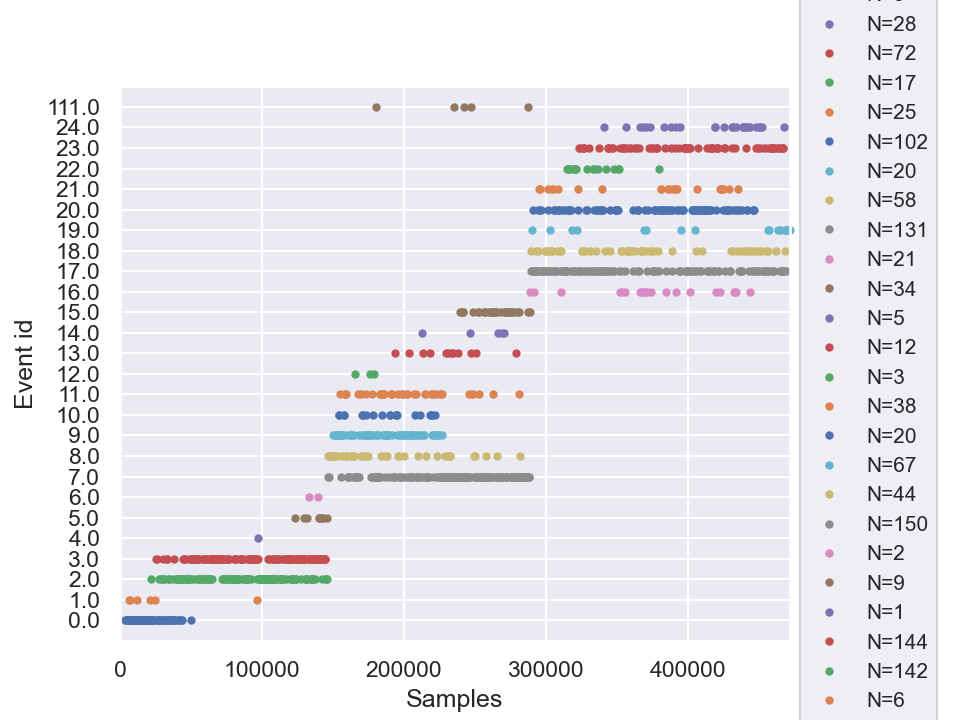

In [388]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(cluster_events)
print(len(cluster_events))
print(len(graph.vs))

fig = mne.viz.plot_events(cluster_events)            

In [547]:
# Define filter function
# filter_func = Eccentricity()
# filter_func = Entropy()
filter_func = decomposition.PCA(n_components=1)

filter_func = L_inf_centrality()
filter_func = stage1_min_dist()
# filter_func = L_inf_centr_time()
# filter_func = stage1_min_dist_time()

# Define cover
# cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
cover = OneDimensionalCover(n_intervals=5, overlap_frac=0.1)

# Choose clustering algorithm
#clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2, connectivity=knn_con_matr)
clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

[[3.79400e+03 0.00000e+00 0.00000e+00]
 [4.18100e+03 0.00000e+00 0.00000e+00]
 [4.95900e+03 0.00000e+00 0.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 4.00000e+00]
 [4.71229e+05 0.00000e+00 6.00000e+00]
 [4.71594e+05 0.00000e+00 6.00000e+00]]
1231
10


<IPython.core.display.Javascript object>


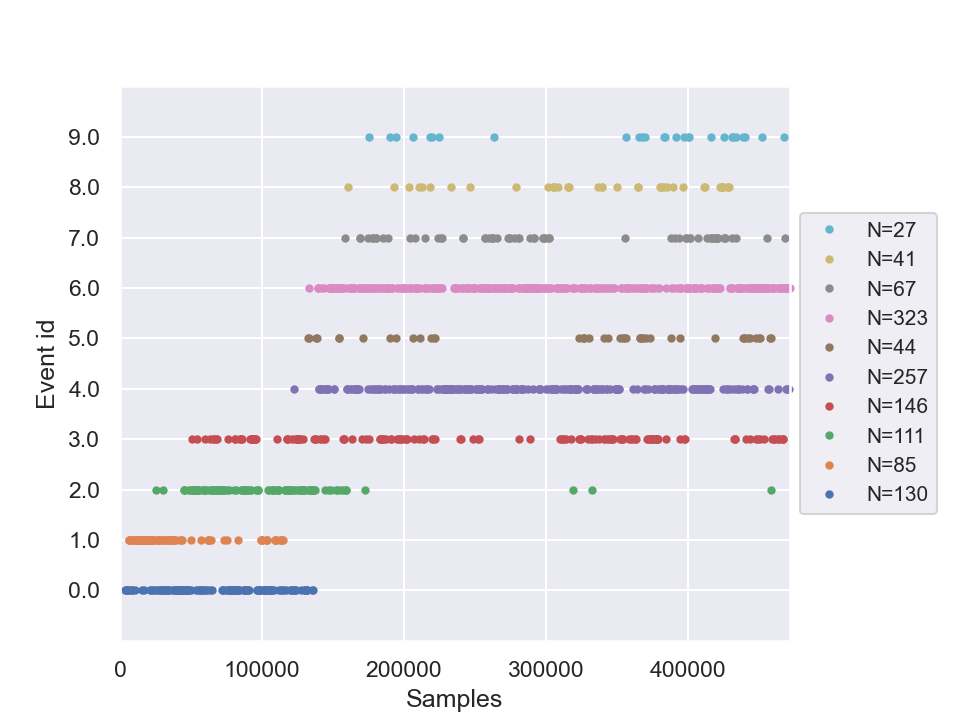

In [548]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(len(graph.vs))            
m_PCA_corr_kmeans_labels = cluster_events[:,2]


fig = mne.viz.plot_events(cluster_events)            

In [549]:
print(len(ecctr_corr_ward_knn_labels))
print(ecctr_corr_ward_knn_labels)

1231
[0. 0. 0. ... 4. 6. 6.]


# Testing different mappers

In [599]:
# Define filter function

#filter_func = Eccentricity(metric='euclidean')
#filter_func = Eccentricity(metric='correlation')
#filter_func = Entropy()
#filter_func = decomposition.PCA(n_components=1)

#filter_func = L_inf_centrality(metric='euclidean')
#filter_func = L_inf_centrality(metric='correlation')

#filter_func = stage1_min_dist(metric='euclidean')
filter_func = stage1_min_dist(metric='correlation')

# filter_func = L_inf_centr_time()
# filter_func = stage1_min_dist_time()

# Define cover
# cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
cover = OneDimensionalCover(n_intervals=5, overlap_frac=0.1)

# Choose clustering algorithm
clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2, connectivity=knn_con_matr)
#clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2)
#clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

10


<IPython.core.display.Javascript object>


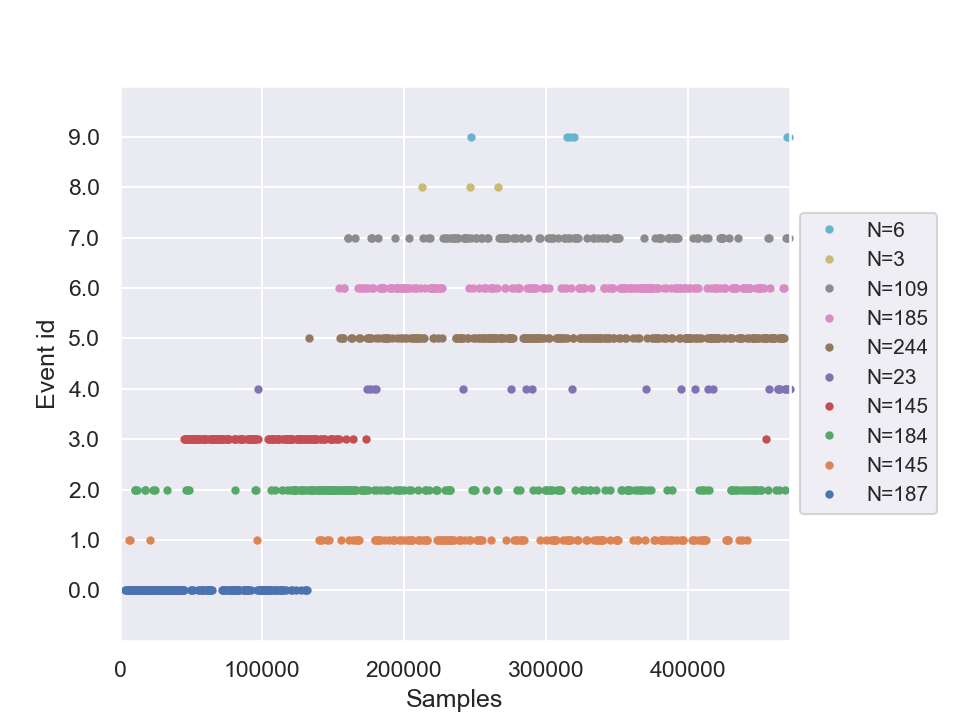

In [600]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(len(graph.vs))            

#m_ecc_eucl_kmeans_labels = cluster_events[:,2]
#m_ecc_corr_kmeans_labels = cluster_events[:,2]
#m_ecc_eucl_ward_knn_labels = cluster_events[:,2]
#m_ecc_corr_ward_knn_labels = cluster_events[:,2]

#m_entropy_kmeans_labels = cluster_events[:,2]
#m_entropy_ward_labels = cluster_events[:,2]
#m_entropy_ward_knn_labels = cluster_events[:,2]

#m_PCA_1_kmeans_labels = cluster_events[:,2]
#m_PCA_1_ward_knn_labels = cluster_events[:,2]

#m_linf_eucl_kmeans_labels = cluster_events[:,2]
#m_linf_corr_kmeans_labels = cluster_events[:,2]
#m_linf_eucl_ward_knn_labels = cluster_events[:,2]
#m_linf_corr_ward_knn_labels = cluster_events[:,2]

#m_st1_dist_eucl_kmeans_labels = cluster_events[:,2]
#m_st1_dist_corr_kmeans_labels = cluster_events[:,2]
#m_st1_dist_eucl_ward_knn_labels = cluster_events[:,2]
m_st1_dist_corr_ward_knn_labels = cluster_events[:,2]

fig = mne.viz.plot_events(cluster_events)            

In [ ]:
# Calculate cluster centers and their distance matrix




In [535]:
# Функция для расчёта оценок качетва кластеризации
from sklearn import metrics

def bench_cl_metrics_noground(name, data, labels_pred):
#    t0 = time()
#    estimator = cluster_method.fit(data)
#    fit_time = time() - t0
    results = [name]

    # Define the metrics which require only data and predicted labels
    cluster_metrics_without_ground = [
        metrics.silhouette_score,
        metrics.calinski_harabasz_score,
        metrics.davies_bouldin_score
    ]
    results += [m(data, labels_pred) for m in cluster_metrics_without_ground]

    # Show the results
    formatter_result = (
        "{:9s}\t{:.3f}\t{:.3f}\t\t{:.3f}"
    )
    print(formatter_result.format(*results))

In [601]:
# Сравнение методов кластеризации на основе оценок качества

print(82 * "_")
print("method \t\t silh\t cal-har\t dav-bold\t homo\t compl\t v-meas\t ARI\t AMI")

cluster_method = KMeans(n_clusters=6, random_state=0)
fit_method = cluster_method.fit(psd_spectr_FA_ward)
bench_cl_metrics_noground(name="kmeans_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

for linkage in ("ward", "average"):#, "complete", "single"):
    cluster_method = AgglomerativeClustering(linkage=linkage, n_clusters=6)
    fit_method = cluster_method.fit(psd_spectr_FA_ward)
    bench_cl_metrics_noground(name=linkage+"_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

cluster_method = AgglomerativeClustering(linkage="ward", n_clusters=6, connectivity=knn_con_matr)
fit_method = cluster_method.fit(psd_spectr_FA_ward)
bench_cl_metrics_noground(name="ward_adj_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

# Mapper results
bench_cl_metrics_noground(name="m_ecc_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_ecc_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_ecc_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_ecc_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_ecc_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_ecc_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_ecc_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_ecc_corr_ward_knn_labels)

bench_cl_metrics_noground(name="m_entropy_kmeans", data=psd_spectr_FA_ward, labels_pred=m_entropy_kmeans_labels)
bench_cl_metrics_noground(name="m_entropy_ward", data=psd_spectr_FA_ward, labels_pred=m_entropy_ward_labels)
bench_cl_metrics_noground(name="m_entropy_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_entropy_ward_knn_labels)

bench_cl_metrics_noground(name="m_PCA_1_kmeans", data=psd_spectr_FA_ward, labels_pred=m_PCA_1_kmeans_labels)
bench_cl_metrics_noground(name="m_PCA_1_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_PCA_1_ward_knn_labels)

bench_cl_metrics_noground(name="m_linf_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_linf_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_linf_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_linf_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_linf_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_linf_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_linf_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_linf_corr_ward_knn_labels)

bench_cl_metrics_noground(name="m_st1_dist_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_st1_dist_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_st1_dist_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_st1_dist_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_corr_ward_knn_labels)

print(82 * "_")

__________________________________________________________________________________
method 		 silh	 cal-har	 dav-bold	 homo	 compl	 v-meas	 ARI	 AMI
kmeans_FA_ward	0.208	405.352		1.476
ward_FA_ward	0.172	335.804		1.461
average_FA_ward	0.165	217.656		1.185
ward_adj_FA_ward	0.115	243.752		2.549
m_ecc_eucl_kmeans	0.050	145.221		2.839
m_ecc_corr_kmeans	0.096	116.481		2.572
m_ecc_eucl_ward_knn	0.011	95.898		4.343
m_ecc_corr_ward_knn	-0.016	49.940		2.905
m_entropy_kmeans	0.095	206.360		1.823
m_entropy_ward	0.088	198.893		1.770
m_entropy_ward_knn	0.081	186.860		1.890
m_PCA_1_kmeans	0.120	242.065		1.816
m_PCA_1_ward_knn	0.117	236.747		1.759
m_linf_eucl_kmeans	0.050	162.660		2.835
m_linf_corr_kmeans	0.001	122.914		3.774
m_linf_eucl_ward_knn	0.028	137.765		2.911
m_linf_corr_ward_knn	-0.015	101.670		3.460
m_st1_dist_eucl_kmeans	0.059	170.591		2.952
m_st1_dist_corr_kmeans	0.044	148.635		3.003
m_st1_dist_eucl_ward_knn	0.036	147.915		3.054
m_st1_dist_corr_ward_knn	0.039	129.092		3.630
_______________

In [541]:
fit_method.labels_

array([3, 3, 3, ..., 2, 2, 2], dtype=int64)

# Testing

In [113]:
nparr = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10])
nparreven = nparr[np.where(nparr % 2 == 0)]
nparreven

npbool = nparr < 5
(nparr == 5).astype(int)

array([0, 0, 0, 0, 1, 0, 0, 0, 0, 0])

In [292]:
print(epochs_ecg.get_data().shape)

(1231, 19, 451)


In [ ]:
psd_ecg_ft_PCA = decomposition.PCA(n_components=0.90).fit_transform(psd_ecg_ft)
print(psd_ecg_ft_PCA.shape)

comp_names = []
for i in range(1, len(psd_ecg_ft_PCA[0,:])+1):
    comp_names = comp_names + ['PCA_'+str(i)]
print(comp_names)

df_psd_ecg_ft_PCA = pd.DataFrame(psd_ecg_ft_PCA, columns=comp_names)
display(df_psd_ecg_ft_PCA)

#display_corr_matrix(df_psd_ecg_ft_PCA.corr(),  [0.6, 0.8, 1])